In [1]:
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
import pandas as pd
import time
from sklearn.externals import joblib
from sklearn.model_selection import cross_val_score
import numpy as np
from sklearn.exceptions import ConvergenceWarning
from sklearn.preprocessing import StandardScaler

In [2]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
class LearningManager:
    def __init__(self, mode):
        self.mode = mode
        if mode == 1:  # news_content
            self.classifer_path = "model\svm_news.pkl"
            self.sc_path = "model\sc_news.pkl"
        elif mode == 2:    # news_title
            self.classifer_path = "model\svm_news_title.pkl"
            self.sc_path = "model\sc_news_title.pkl"
        elif mode == 3:    # blog_content
            self.classifer_path = "model\svm_blog.pkl"
            self.sc_path = "model\sc_blog.pkl"
        elif mode == 4:    # blog_title
            self.classifer_path = "model\svm_blog_title.pkl"
            self.sc_path = "model\sc_blog_title.pkl"
        elif mode == 5:    # shopping mall_content
            self.classifer_path = "model\svm_shop.pkl"
            self.sc_path = "model\sc_shop.pkl"
        elif mode == 6:    # shopping mall_title
            self.classifer_path = "model\svm_shop_title.pkl"
            self.sc_path = "model\sc_shop_title.pkl"

        try:
            self.classifer = joblib.load(self.classifer_path)
            self.sc = joblib.load(self.sc_path)
        except:
            self.classifer = SVC(random_state=1)
            self.sc = StandardScaler()

#         self.param_range = [0.01, 0.1, 1.0, 10.0, 100.0]
#         self.iters = [500, 1000, 1500, 2000]
#         if mode in [1, 3, 5]:
#             self.weight_grid = [{0: 0.1, 1: 0.9}, {0: 0.2, 1: 0.8}, {0: 0.3, 1: 0.7}]
#         else:
#             self.weight_grid = [{0: 0.1, 1: 0.9}]
#         self.param_grid = [{"C": self.param_range, "gamma": self.param_range, "kernel": ["rbf"], "max_iter": self.iters,
#                             "class_weight": self.weight_grid}]
#         self.gs = GridSearchCV(estimator=self.classifer, param_grid=self.param_grid, scoring="f1_weighted", cv=5,
#                                n_jobs=-1)
        self.x_train = []
        self.y_train = []
        self.x_test = []
        self.y_test = []

    def readdata(self, filedir): # [content, x, y, w, h, font_size, label]
        csv = pd.read_csv(filedir, header=None, encoding="utf-8")
        for index, row in csv.iterrows():
            if not (row[1] == 0.0 and row[2] == 0.0 and row[3] == 0.0 and row[4] == 0.0):
                block = [row[1], row[2], row[3], row[4], row[5]]
                self.x_train.append(block)
                self.y_train.append(row[6])

    def fit(self):
        self.classifer.fit(self.x_train_std, self.y_train)
        joblib.dump(self.classifer, self.classifer_path)

    def preprocessing(self):
        self.sc.fit(self.x_train)
        self.x_train_std = self.sc.transform(self.x_train)
        joblib.dump(self.sc, self.sc_path)

    def resetmodel(self):
        self.classifer = SVC(random_state=1)
#         self.gs = GridSearchCV(estimator=self.classifer, param_grid=self.param_grid, scoring="f1_weighted", cv=5, n_jobs=-1)
        self.sc = StandardScaler()

    def setmodel(self, params):
        try:
            self.classifer = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], max_iter=params["max_iter"], class_weight=params["class_weight"])
        except:
            self.classifer = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], max_iter=params["max_iter"])
            
#     def hyparam(self):
#         self.gs.fit(self.x_train_std, self.y_train)
#         print("Best score : ", self.gs.best_score_)
#         print("Best param : ", self.gs.best_params_)
#         params = self.gs.best_params_
#         return params

    def eval_train(self):
        scores = cross_val_score(estimator=self.classifer, X=self.x_train_std, y=self.y_train, cv=5, n_jobs=-1, scoring="accuracy")
        print('Test CV accuracy scores: %s' % scores)
        print('Test CV accuracy: {0:.3f} +/- {1:.3f}'.format(np.mean(scores), np.std(scores)))

        scores = cross_val_score(estimator=self.classifer, X=self.x_train_std, y=self.y_train, cv=5, n_jobs=-1,scoring="f1_weighted")
        print('Test CV f1 scores: %s' % scores)
        print('Test CV f1: {0:.3f} +/- {1:.3f}'.format(np.mean(scores), np.std(scores)))
    def readtest(self, filedir): # [content, x, y, w, h, font_size, label]
        csv = pd.read_csv(filedir, header=None, encoding="utf-8")
        for index, row in csv.iterrows():
            if not (row[1] == 0.0 and row[2] == 0.0 and row[3] == 0.0 and row[4] == 0.0):
                block = [row[1], row[2], row[3], row[4], row[5]]
                self.x_test.append(block)
                self.y_test.append(row[6])
        self.x_test = self.sc.transform(self.x_test)
        
    def eval_test(self):
        y_pred = self.classifer.predict(self.x_test)
        print("Test accuracy : ",accuracy_score(y_pred,self.y_test))

        y_pred = self.classifer.predict(self.x_test)
        print("Test f1 : ",f1_score(y_pred,self.y_test))

In [7]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
def plot(mode,flag):
    learningmanager = LearningManager(mode)
    learningmanager.resetmodel()
    if flag == "train":
        if mode == 1:
            path = "dataset/train_news.csv"
        elif mode == 2:
            path = "dataset/train_news_title.csv"
        elif mode == 3:
            path = "dataset/train_blog.csv"
        elif mode == 4:
            path = "dataset/train_blog_title.csv"
        elif mode == 5:
            path = "dataset/train_shop.csv"
        elif mode == 6:
            path = "dataset/train_shop_title.csv"
    elif flag == "test":
        if mode == 1:
            path = "dataset/test_news.csv"
        elif mode == 2:
            path = "dataset/test_news_title.csv"
        elif mode == 3:
            path = "dataset/test_blog.csv"
        elif mode == 4:
            path = "dataset/test_blog_title.csv"
        elif mode == 5:
            path = "dataset/test_shop.csv"
        elif mode == 6:
            path = "dataset/test_shop_title.csv"
    learningmanager.readdata(path)
    learningmanager.preprocessing()
    
    # x, y, w, h, font size 분포
    for i in range(0,5):
        plt.hist(learningmanager.x_train_std[:,i],bins=100)
        plt.show()
        
    # x, y 분포
    y = learningmanager.y_train
    x_1 = []
    x_0 = []
    for i in range(len(y)):
        if y[i] == 1:
            x_1.append(learningmanager.x_train_std[i])
        else:
            x_0.append(learningmanager.x_train_std[i])
    x_1 = np.array(x_1)
    x_0 = np.array(x_0)

    plt.scatter(x=x_1[:,0],y=x_1[:,1],s=0.5,c="red")
    plt.scatter(x=x_0[:,0],y=x_0[:,1],s=0.5)
    plt.title("X,Y")
    plt.show()

    # x, y, w 분포
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111, projection='3d')
#     ax.view_init(0,60)
    ax.scatter(x_1[:,0], x_1[:,1], x_1[:,2],s=0.5,c="red")
    ax.scatter(x_0[:,0], x_0[:,1], x_0[:,2],s=0.5)
    plt.title("X,Y,W")
    plt.show()
    
    # PCA 확인
    pca = PCA()
    x_train_pca = pca.fit_transform(learningmanager.x_train_std)
    plt.bar(range(1, 6), pca.explained_variance_ratio_, alpha=0.5, align='center')
    plt.step(range(1, 6), np.cumsum(pca.explained_variance_ratio_), where='mid')
    plt.ylabel('Explained variance ratio')
    plt.xlabel('Principal components')
    plt.show()
    
    # PCA(3) 분포
    x = learningmanager.x_train
    pca = PCA(3)
    sc = StandardScaler()
    x = pca.fit_transform(x)
    x = sc.fit_transform(x)

    y = learningmanager.y_train
    x_1 = []
    x_0 = []
    for i in range(len(y)):
        if y[i] == 1:
            x_1.append(x[i])
        else:
            x_0.append(x[i])
    x_1 = np.array(x_1)
    x_0 = np.array(x_0)

    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111, projection='3d')
#     ax.view_init(45,0)
    ax.scatter(x_1[:,0], x_1[:,1], x_1[:,2],s=0.5,c="red")
    ax.scatter(x_0[:,0], x_0[:,1], x_0[:,2],s=0.5)
    plt.title("PCA_3")
    plt.show()

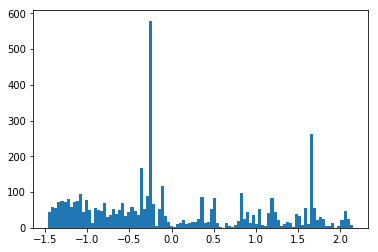

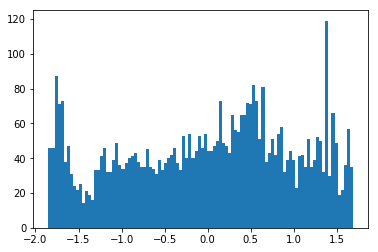

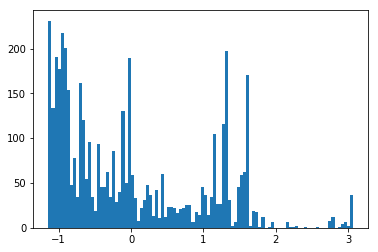

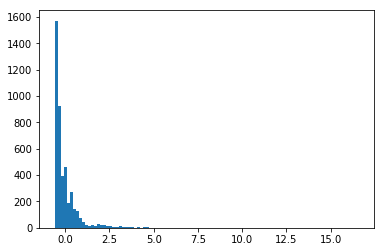

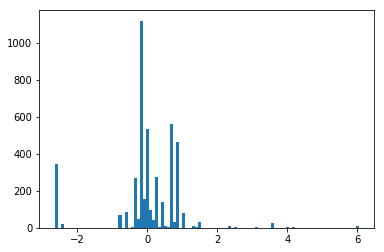

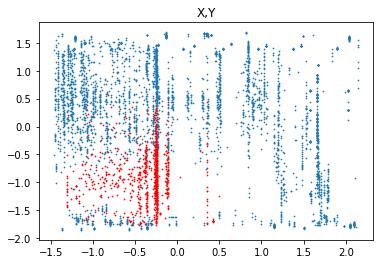

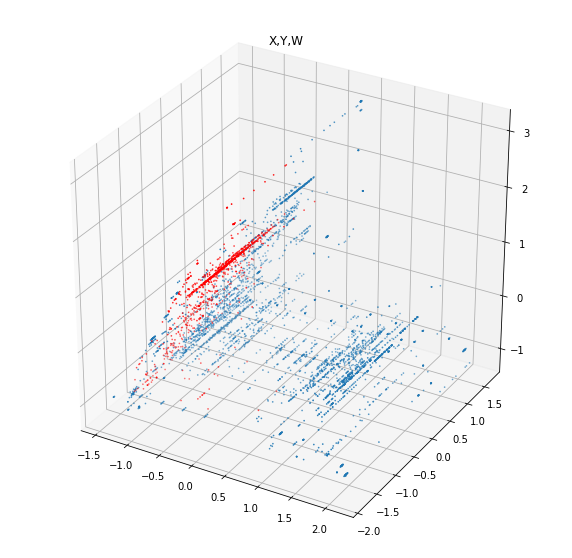

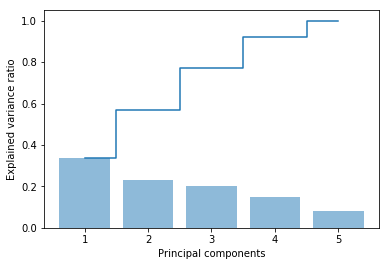

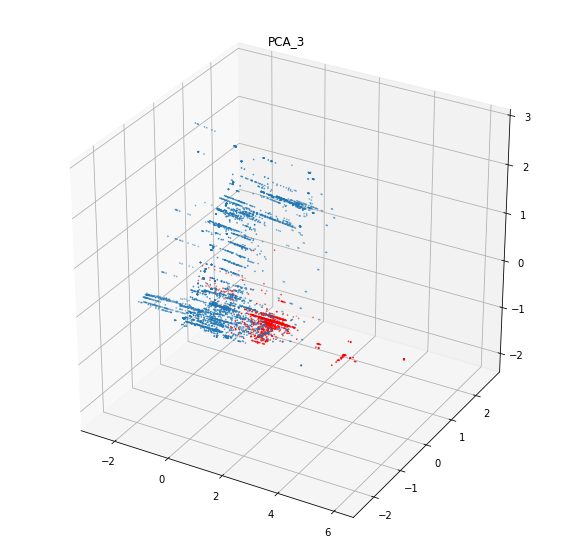

In [8]:
plot(1,"train")

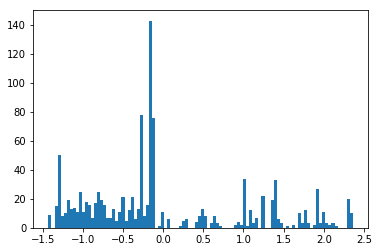

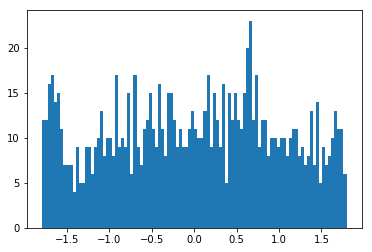

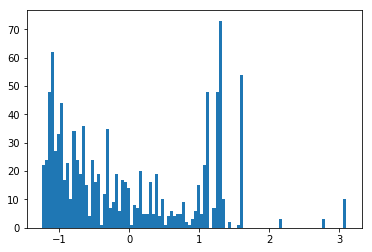

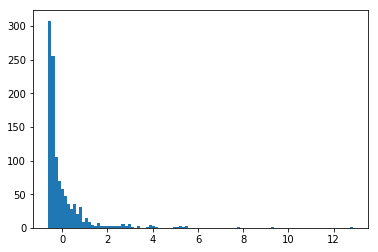

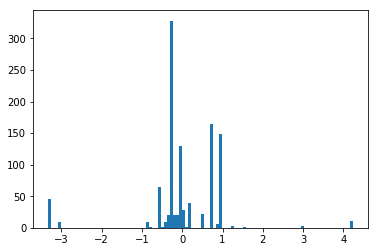

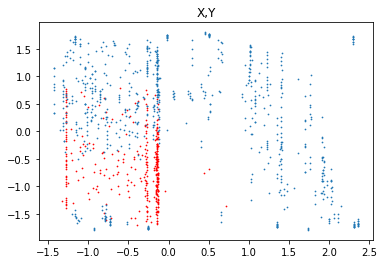

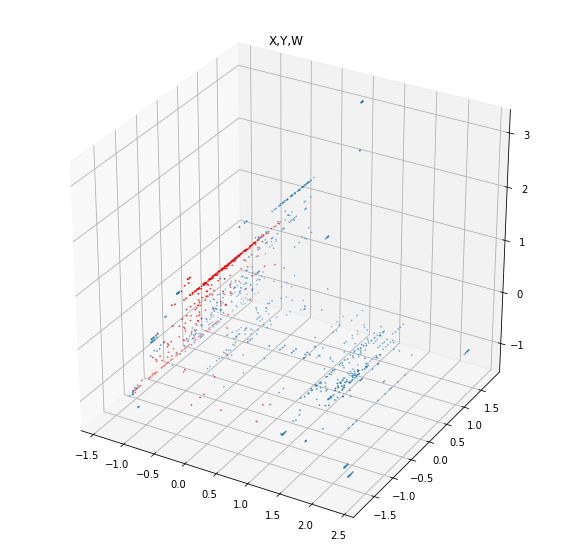

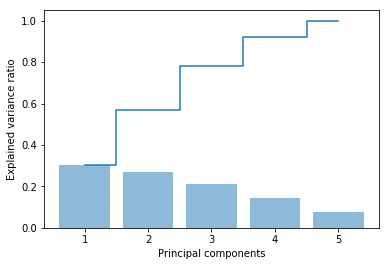

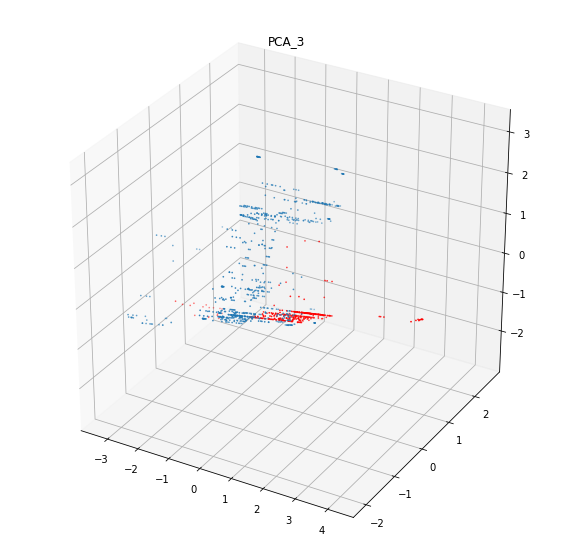

In [9]:
plot(1,"test")

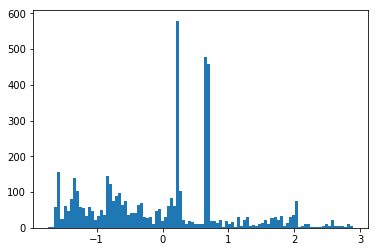

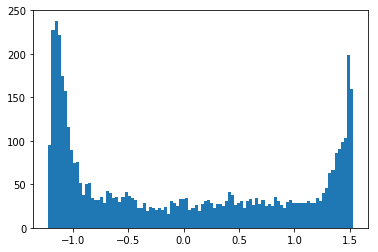

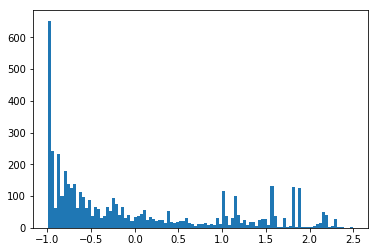

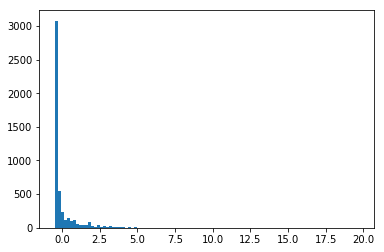

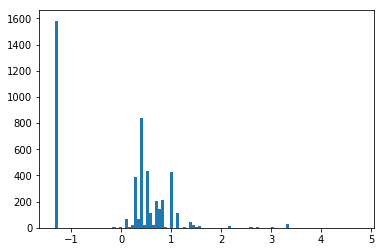

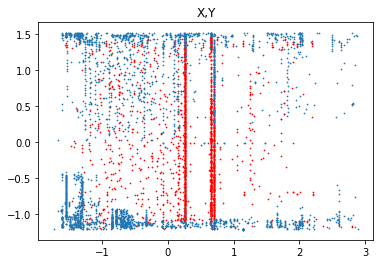

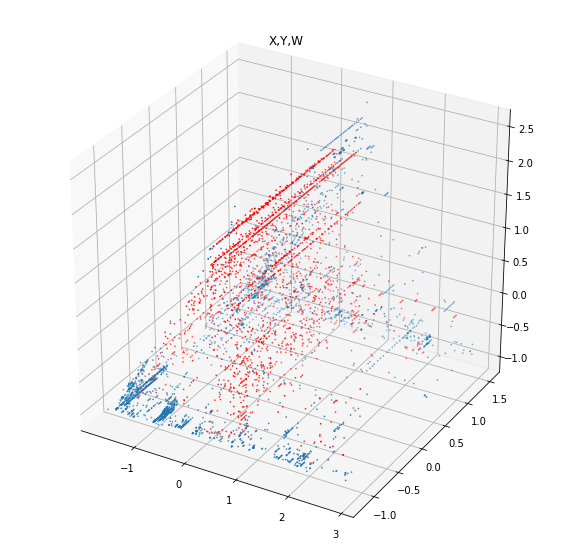

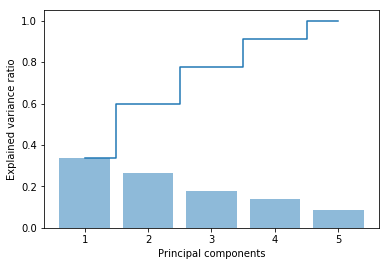

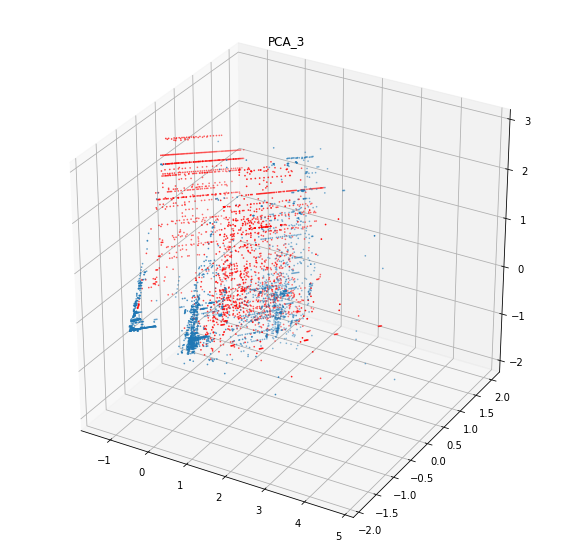

In [10]:
plot(3,"train")

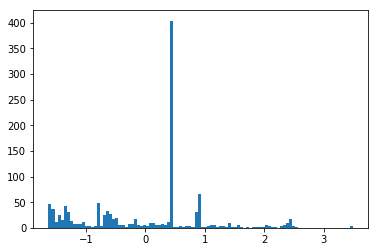

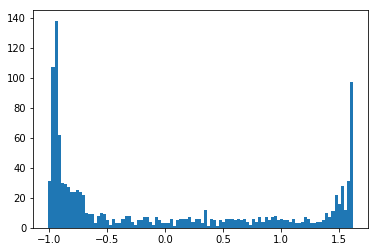

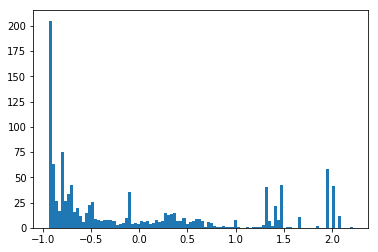

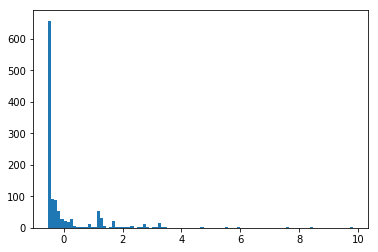

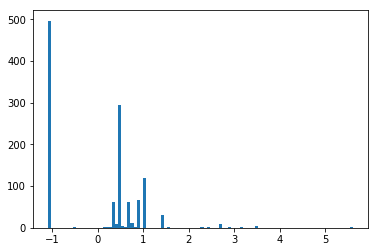

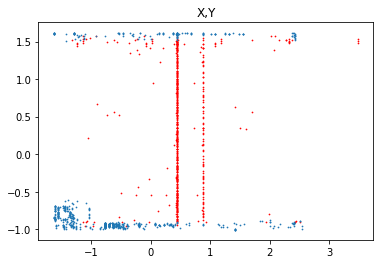

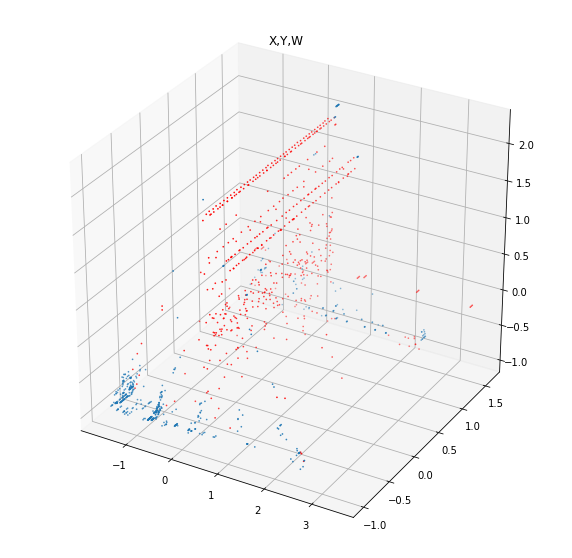

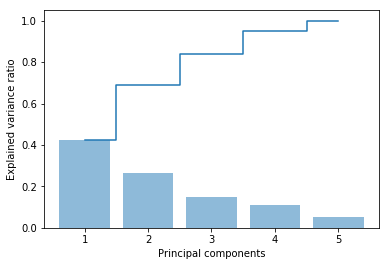

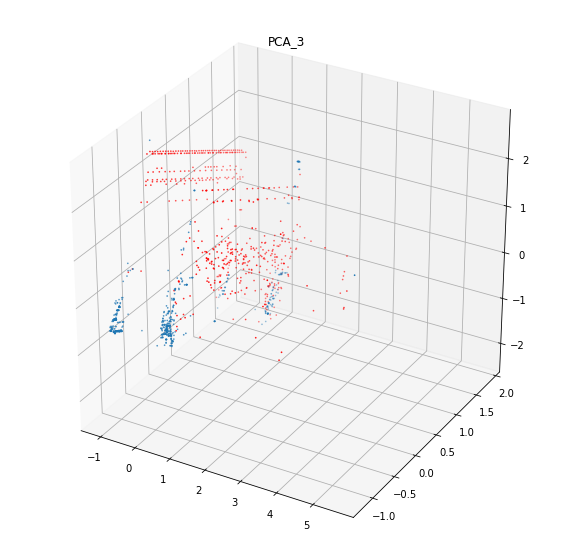

In [11]:
plot(3,"test")

In [12]:
from mlxtend.plotting import plot_decision_regions
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from matplotlib import pyplot as plt

# params = C, gamma, kernel, max_iter, class_weight
# mode = 1 ~ 6
# score = accuracy or f1
def tuning(mode,params):
    if mode == 1:
        train_path = "dataset/train_news.csv"
        test_path = "dataset/test_news.csv"
    elif mode == 2:
        train_path = "dataset/train_news_title.csv"
        test_path = "dataset/test_news_title.csv"
    elif mode == 3:
        train_path = "dataset/train_blog.csv"
        test_path = "dataset/test_blog.csv"
    elif mode == 4:
        train_path = "dataset/train_blog_title.csv"
        test_path = "dataset/test_blog_title.csv"
    elif mode == 5:
        train_path = "dataset/train_shop.csv"
        test_path = "dataset/test_shop.csv"
    elif mode == 6:
        train_path = "dataset/train_shop_title.csv"
        test_path = "dataset/test_shop_title.csv"
    learningmanager = LearningManager(mode)
    learningmanager.resetmodel()
    learningmanager.readdata(train_path)
    learningmanager.preprocessing()
    
    try:
        svm = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], degree=params["degree"], max_iter=params["max_iter"], class_weight=params["class_weight"])
    except:
        svm = SVC(random_state=1, C=params["C"], gamma=params["gamma"], kernel=params["kernel"], max_iter=params["max_iter"], class_weight=params["class_weight"])
    
    pca = PCA(n_components=2)
    sc = StandardScaler()
    x = learningmanager.x_train
    x = pca.fit_transform(x)
    x = sc.fit_transform(x)
    y = learningmanager.y_train
    svm.fit(x,y)
    y = np.array(y)
    y = y.astype(np.integer)
    
    plot_decision_regions(X=x,y=y, clf=svm,legend=2)
    plt.legend(loc='upper left')
    
    try:
        plt.title("C:{} / gamma:{} / kernel:{} / degree:{} / iter:{} / weight:{}".format(params["C"],params["gamma"],params["kernel"],params["degree"],params["max_iter"],params["class_weight"]))
    except:
        plt.title("C:{} / gamma:{} / kernel:{} / iter:{} / weight:{}".format(params["C"],params["gamma"],params["kernel"],params["max_iter"],params["class_weight"]))
    plt.show()
    
    learningmanager.setmodel(params=params)
    learningmanager.eval_train()
    learningmanager.fit()
    learningmanager.readtest(test_path)
    learningmanager.eval_test()

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


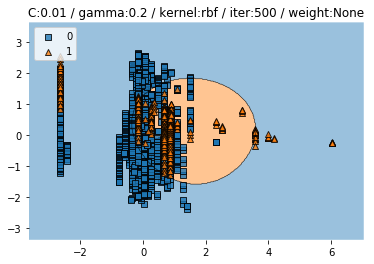

Test CV accuracy scores: [0.89821029 0.93729003 0.89025756 0.91041433 0.91601344]
Test CV accuracy: 0.910 +/- 0.016
Test CV f1 scores: [0.90388335 0.93610876 0.89711379 0.91447889 0.91852059]
Test CV f1: 0.914 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8736162361623616
Test f1 :  0.82230869001297


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


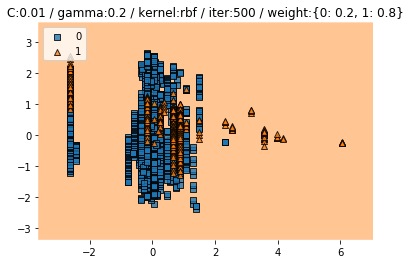

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


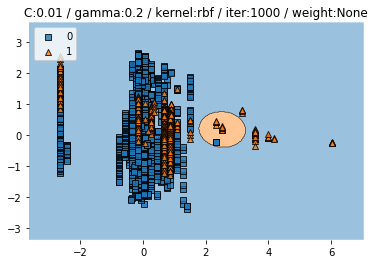

Test CV accuracy scores: [0.901566   0.8868981  0.924972   0.90929451 0.90369541]
Test CV accuracy: 0.905 +/- 0.012
Test CV f1 scores: [0.8983485  0.87316064 0.92504489 0.90619501 0.90099022]
Test CV f1: 0.901 +/- 0.017
Test accuracy :  0.8625461254612546
Test f1 :  0.736283185840708


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


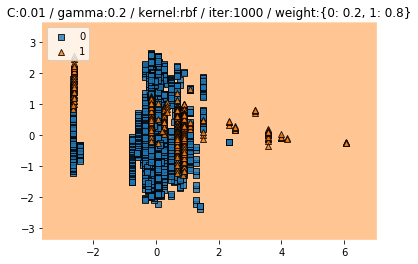

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


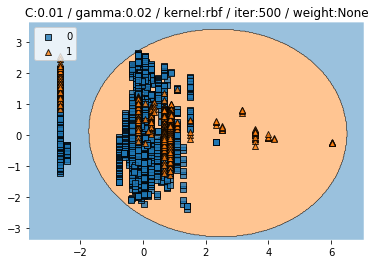

Test CV accuracy scores: [0.45973154 0.66405375 0.39081747 0.35722284 0.56886898]
Test CV accuracy: 0.488 +/- 0.114
Test CV f1 scores: [0.48325211 0.69447613 0.39354481 0.35078882 0.59868297]
Test CV f1: 0.504 +/- 0.128


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47509225092250923
Test f1 :  0.5301403798513625


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


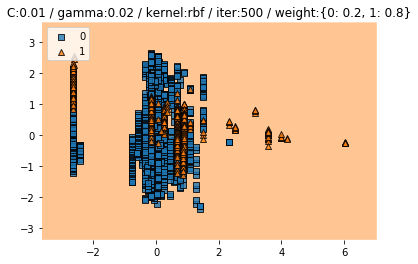

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


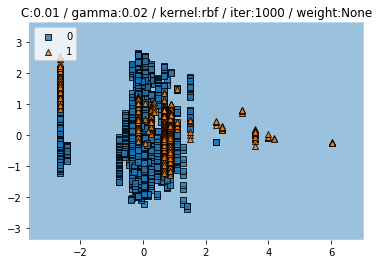

Test CV accuracy scores: [0.7885906  0.78947368 0.78947368 0.78947368 0.78947368]
Test CV accuracy: 0.789 +/- 0.000
Test CV f1 scores: [0.69538008 0.69659443 0.69659443 0.69659443 0.69659443]
Test CV f1: 0.696 +/- 0.000
Test accuracy :  0.6863468634686347
Test f1 :  0.0


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\metrics\classification.py:1145: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 due to no true samples.
  'recall', 'true', average, warn_for)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


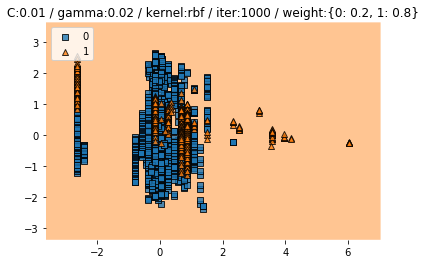

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


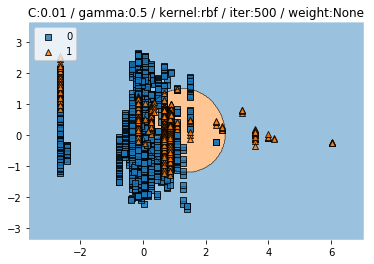

Test CV accuracy scores: [0.91722595 0.90593505 0.93505039 0.90705487 0.92609183]
Test CV accuracy: 0.918 +/- 0.011
Test CV f1 scores: [0.91410986 0.8974005  0.93589048 0.90341059 0.92534239]
Test CV f1: 0.915 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9326568265682657
Test f1 :  0.8940493468795356


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


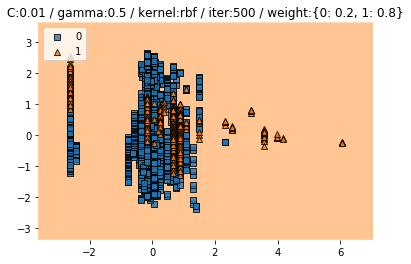

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


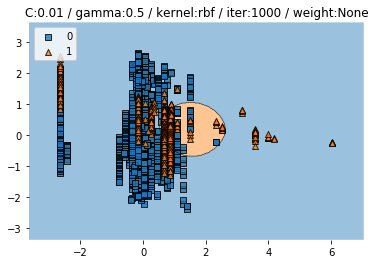

Test CV accuracy scores: [0.901566   0.87905935 0.91825308 0.90033595 0.90593505]
Test CV accuracy: 0.901 +/- 0.013
Test CV f1 scores: [0.89574892 0.86218135 0.9166212  0.89366858 0.90163339]
Test CV f1: 0.894 +/- 0.018
Test accuracy :  0.8459409594095941
Test f1 :  0.692449355432781


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


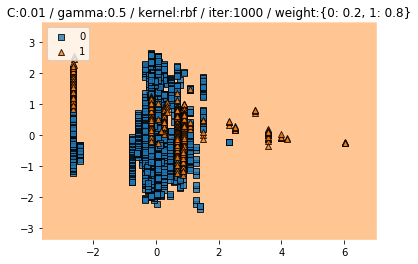

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


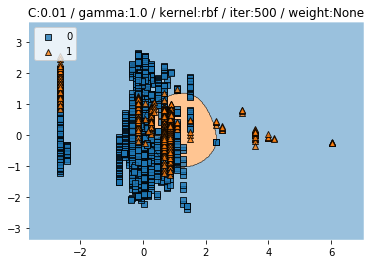

Test CV accuracy scores: [0.91163311 0.90369541 0.94176932 0.9137738  0.92945129]
Test CV accuracy: 0.920 +/- 0.014
Test CV f1 scores: [0.9067846  0.8936159  0.94013362 0.90694002 0.9283569 ]
Test CV f1: 0.915 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9280442804428044
Test f1 :  0.8785046728971962


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


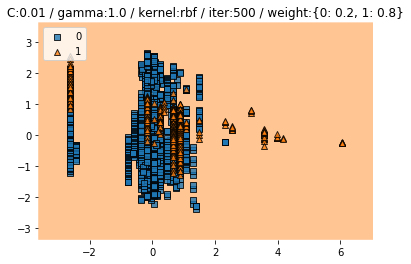

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


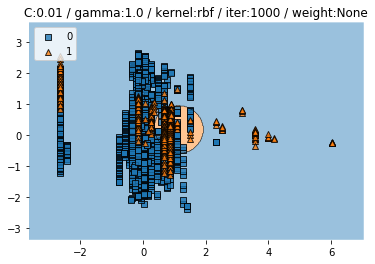

Test CV accuracy scores: [0.89149888 0.8600224  0.92049272 0.8924972  0.91153415]
Test CV accuracy: 0.895 +/- 0.021
Test CV f1 scores: [0.88004343 0.83376843 0.91493403 0.87837714 0.90587854]
Test CV f1: 0.883 +/- 0.028
Test accuracy :  0.8431734317343174
Test f1 :  0.669260700389105


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


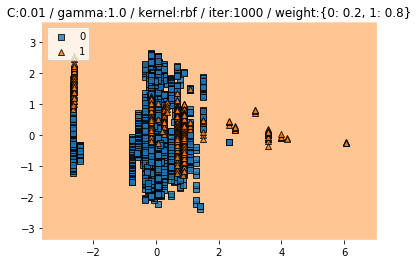

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


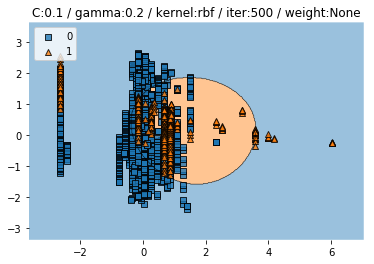

Test CV accuracy scores: [0.94183445 0.93393057 0.9406495  0.93057111 0.93617021]
Test CV accuracy: 0.937 +/- 0.004
Test CV f1 scores: [0.94216458 0.93046114 0.94205832 0.92986709 0.93693979]
Test CV f1: 0.936 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8966789667896679
Test f1 :  0.8139534883720931


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


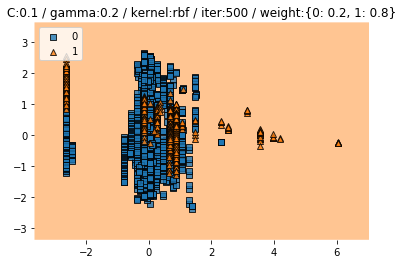

Test CV accuracy scores: [0.23154362 0.21052632 0.21164614 0.28443449 0.21052632]
Test CV accuracy: 0.230 +/- 0.028
Test CV f1 scores: [0.11430137 0.07322654 0.07553082 0.21315088 0.07322654]
Test CV f1: 0.110 +/- 0.054


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


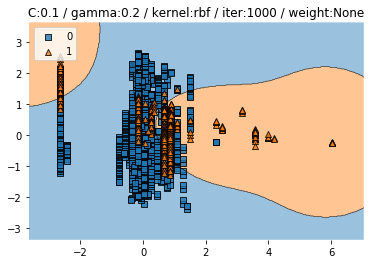

Test CV accuracy scores: [0.94183445 0.93393057 0.9406495  0.93057111 0.93617021]
Test CV accuracy: 0.937 +/- 0.004
Test CV f1 scores: [0.94216458 0.93046114 0.94205832 0.92986709 0.93693979]
Test CV f1: 0.936 +/- 0.005
Test accuracy :  0.8966789667896679
Test f1 :  0.8139534883720931


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


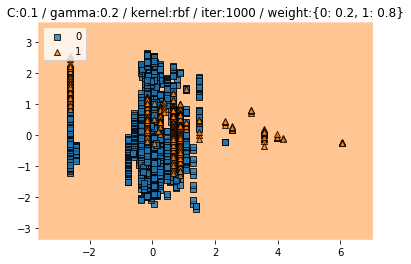

Test CV accuracy scores: [0.87807606 0.95072788 0.86898096 0.89921613 0.92161254]
Test CV accuracy: 0.904 +/- 0.030
Test CV f1 scores: [0.88651932 0.95201272 0.87821522 0.90471163 0.92562921]
Test CV f1: 0.909 +/- 0.027


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8957564575645757
Test f1 :  0.8475033738191632


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


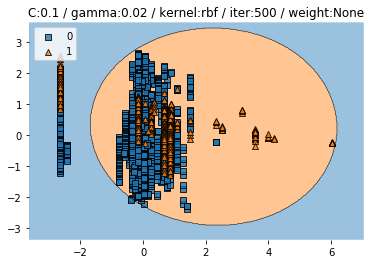

Test CV accuracy scores: [0.58277405 0.84322508 0.63493841 0.61254199 0.80067189]
Test CV accuracy: 0.695 +/- 0.106
Test CV f1 scores: [0.61264193 0.85558909 0.6651221  0.64390024 0.81823419]
Test CV f1: 0.719 +/- 0.098


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5359778597785978
Test f1 :  0.560698689956332


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


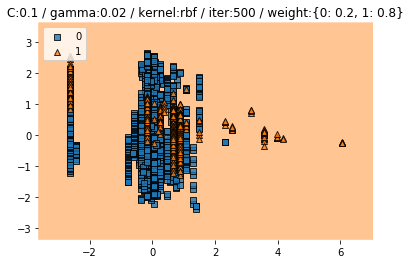

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


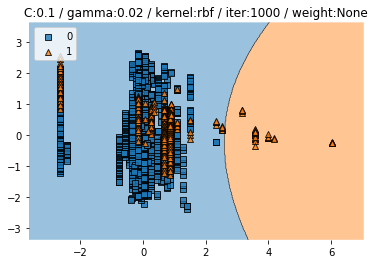

Test CV accuracy scores: [0.92170022 0.90593505 0.90705487 0.91825308 0.91265398]
Test CV accuracy: 0.913 +/- 0.006
Test CV f1 scores: [0.92360702 0.90060064 0.9101002  0.91909348 0.91282301]
Test CV f1: 0.913 +/- 0.008
Test accuracy :  0.8588560885608856
Test f1 :  0.7445742904841403


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


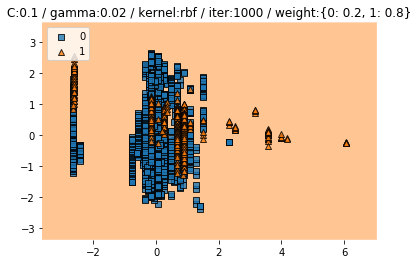

Test CV accuracy scores: [0.39149888 0.45016797 0.32698768 0.32586786 0.40649496]
Test CV accuracy: 0.380 +/- 0.048
Test CV f1 scores: [0.37989056 0.45897745 0.28400102 0.28340204 0.40136596]
Test CV f1: 0.362 +/- 0.069


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3477859778597786
Test f1 :  0.4902667627974045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


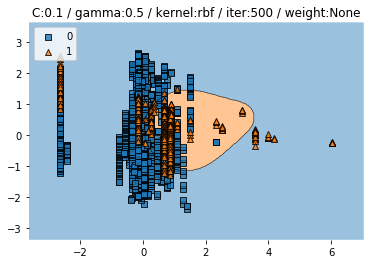

Test CV accuracy scores: [0.95525727 0.93952968 0.95632699 0.94288914 0.94848824]
Test CV accuracy: 0.948 +/- 0.007
Test CV f1 scores: [0.95534324 0.93660222 0.95722363 0.94121651 0.94897152]
Test CV f1: 0.948 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9197416974169742
Test f1 :  0.8594507269789984


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


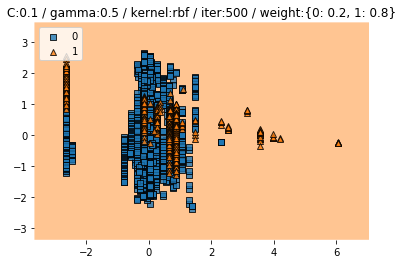

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


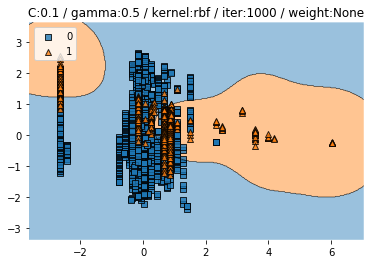

Test CV accuracy scores: [0.95525727 0.93952968 0.95632699 0.94288914 0.94848824]
Test CV accuracy: 0.948 +/- 0.007
Test CV f1 scores: [0.95534324 0.93660222 0.95722363 0.94121651 0.94897152]
Test CV f1: 0.948 +/- 0.008
Test accuracy :  0.9197416974169742
Test f1 :  0.8594507269789984


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


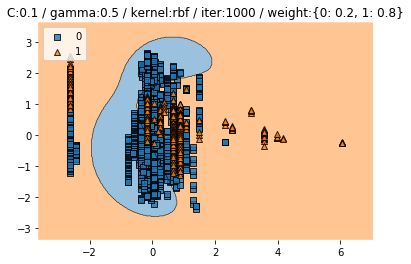

Test CV accuracy scores: [0.89709172 0.95968645 0.88241881 0.91041433 0.93057111]
Test CV accuracy: 0.916 +/- 0.027
Test CV f1 scores: [0.90308684 0.95999137 0.89013198 0.91458769 0.93380546]
Test CV f1: 0.920 +/- 0.024


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9169741697416974
Test f1 :  0.8739495798319328


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


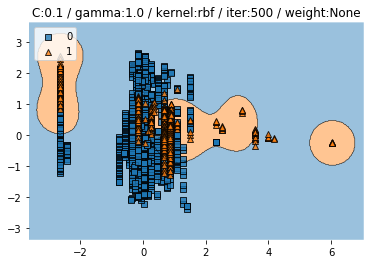

Test CV accuracy scores: [0.95749441 0.94960806 0.96640538 0.94288914 0.94960806]
Test CV accuracy: 0.953 +/- 0.008
Test CV f1 scores: [0.95732723 0.94750232 0.96689818 0.94064988 0.95012612]
Test CV f1: 0.953 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.922509225092251
Test f1 :  0.8627450980392157


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


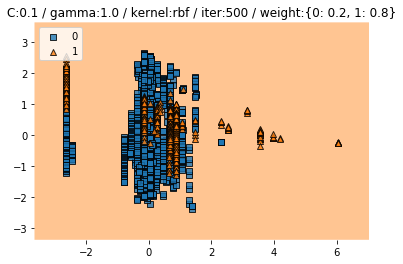

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


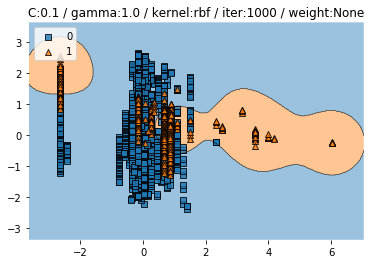

Test CV accuracy scores: [0.95749441 0.94960806 0.96640538 0.94288914 0.94960806]
Test CV accuracy: 0.953 +/- 0.008
Test CV f1 scores: [0.95732723 0.94750232 0.96689818 0.94064988 0.95012612]
Test CV f1: 0.953 +/- 0.009
Test accuracy :  0.9243542435424354
Test f1 :  0.8664495114006515


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


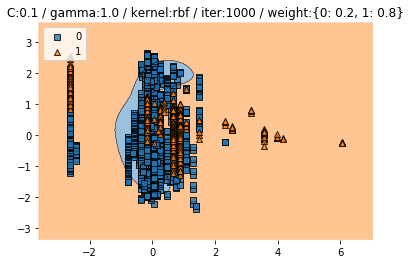

Test CV accuracy scores: [0.89932886 0.97088466 0.8656215  0.92609183 0.924972  ]
Test CV accuracy: 0.917 +/- 0.035
Test CV f1 scores: [0.90509339 0.97120994 0.87543972 0.92877288 0.92877417]
Test CV f1: 0.922 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8865313653136532
Test f1 :  0.8425096030729833


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


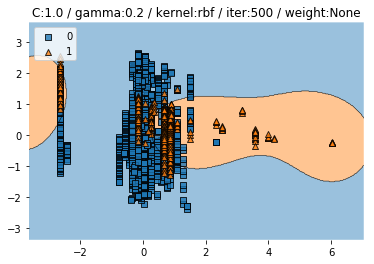

Test CV accuracy scores: [0.95637584 0.96304591 0.95520717 0.94848824 0.95632699]
Test CV accuracy: 0.956 +/- 0.005
Test CV f1 scores: [0.95697382 0.96239107 0.95630563 0.94751791 0.95736367]
Test CV f1: 0.956 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9289667896678967
Test f1 :  0.8791208791208791


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


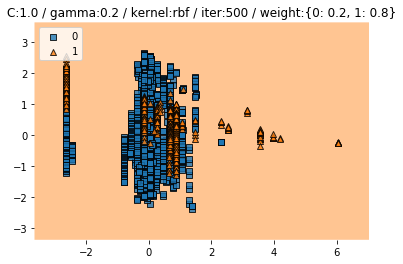

Test CV accuracy scores: [0.88702461 0.97424412 0.89921613 0.92161254 0.93169093]
Test CV accuracy: 0.923 +/- 0.030
Test CV f1 scores: [0.89418935 0.97459969 0.90512671 0.92497373 0.93491407]
Test CV f1: 0.927 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9308118081180812
Test f1 :  0.8951048951048952


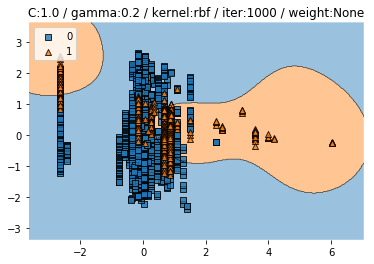

Test CV accuracy scores: [0.95637584 0.96304591 0.95520717 0.94848824 0.95632699]
Test CV accuracy: 0.956 +/- 0.005
Test CV f1 scores: [0.95697382 0.96239107 0.95630563 0.94751791 0.95736367]
Test CV f1: 0.956 +/- 0.005
Test accuracy :  0.9289667896678967
Test f1 :  0.8791208791208791


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


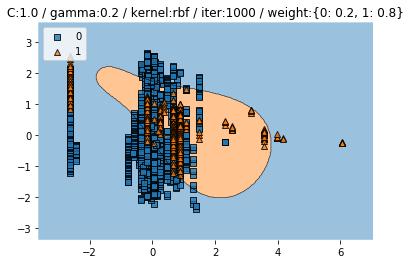

Test CV accuracy scores: [0.90044743 0.96864502 0.91489362 0.92721165 0.93393057]
Test CV accuracy: 0.929 +/- 0.023
Test CV f1 scores: [0.90599581 0.96899532 0.91925457 0.92990195 0.93688755]
Test CV f1: 0.932 +/- 0.021
Test accuracy :  0.9317343173431735
Test f1 :  0.8927536231884058


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


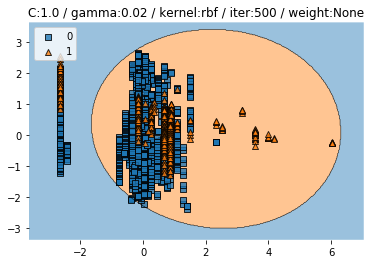

Test CV accuracy scores: [0.92281879 0.93281075 0.91489362 0.91601344 0.9193729 ]
Test CV accuracy: 0.921 +/- 0.006
Test CV f1 scores: [0.92475812 0.93059781 0.91832367 0.91759986 0.92069334]
Test CV f1: 0.922 +/- 0.005


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8902214022140221
Test f1 :  0.8172043010752688


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


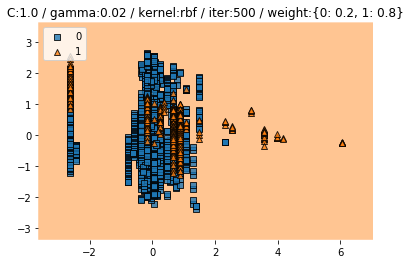

Test CV accuracy scores: [0.27404922 0.20828667 0.24300112 0.30683091 0.24972004]
Test CV accuracy: 0.256 +/- 0.033
Test CV f1 scores: [0.225943   0.078454   0.16529928 0.27660159 0.15202504]
Test CV f1: 0.180 +/- 0.067


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


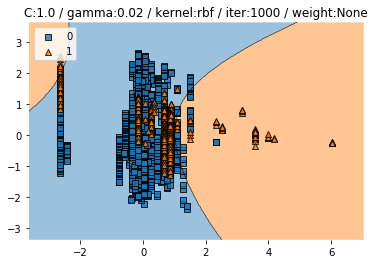

Test CV accuracy scores: [0.92393736 0.93281075 0.91489362 0.91601344 0.9193729 ]
Test CV accuracy: 0.921 +/- 0.007
Test CV f1 scores: [0.92578968 0.93059781 0.91832367 0.91759986 0.92069334]
Test CV f1: 0.923 +/- 0.005
Test accuracy :  0.8892988929889298
Test f1 :  0.8070739549839229


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


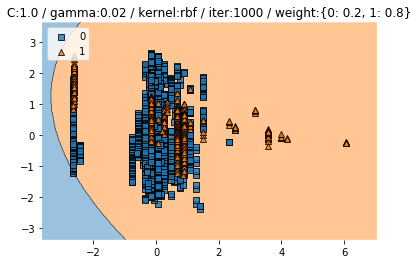

Test CV accuracy scores: [0.86017897 0.94512878 0.85666293 0.89585666 0.91825308]
Test CV accuracy: 0.895 +/- 0.034
Test CV f1 scores: [0.87056863 0.94676678 0.86733525 0.90136647 0.92266675]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8911439114391144
Test f1 :  0.8418230563002681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


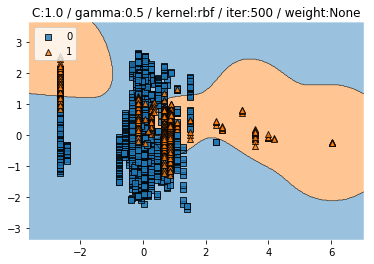

Test CV accuracy scores: [0.96085011 0.95408735 0.96864502 0.95296753 0.95296753]
Test CV accuracy: 0.958 +/- 0.006
Test CV f1 scores: [0.96117959 0.95274268 0.96905057 0.95228926 0.95412091]
Test CV f1: 0.958 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9345018450184502
Test f1 :  0.8871224165341812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


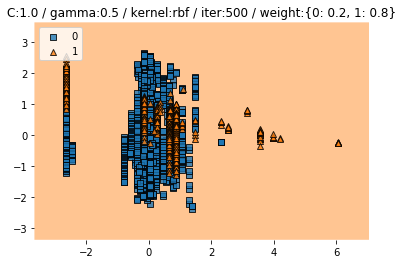

Test CV accuracy scores: [0.91834452 0.97536394 0.924972   0.93505039 0.93617021]
Test CV accuracy: 0.938 +/- 0.020
Test CV f1 scores: [0.92187328 0.97550478 0.92842182 0.93703713 0.93894744]
Test CV f1: 0.940 +/- 0.019


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9455719557195572
Test f1 :  0.9163120567375886


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


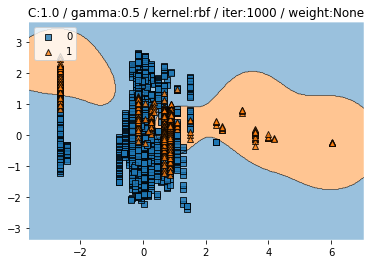

Test CV accuracy scores: [0.96085011 0.95408735 0.96864502 0.95296753 0.95296753]
Test CV accuracy: 0.958 +/- 0.006
Test CV f1 scores: [0.96117959 0.95274268 0.96905057 0.95228926 0.95412091]
Test CV f1: 0.958 +/- 0.006
Test accuracy :  0.9354243542435424
Test f1 :  0.888888888888889


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


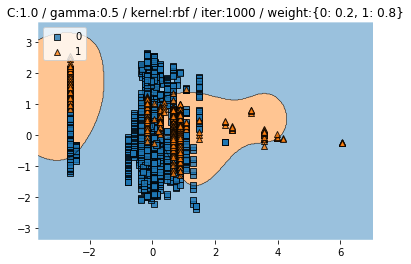

Test CV accuracy scores: [0.92729306 0.9675252  0.92945129 0.93952968 0.93952968]
Test CV accuracy: 0.941 +/- 0.014
Test CV f1 scores: [0.92996199 0.96755674 0.93252086 0.94128989 0.94196682]
Test CV f1: 0.943 +/- 0.013
Test accuracy :  0.9418819188191881
Test f1 :  0.9063893016344725


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


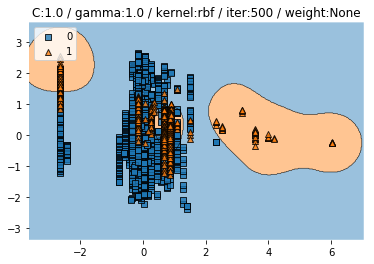

Test CV accuracy scores: [0.95637584 0.95296753 0.97088466 0.96192609 0.95072788]
Test CV accuracy: 0.959 +/- 0.007
Test CV f1 scores: [0.95682113 0.95153331 0.97131176 0.96169805 0.95169919]
Test CV f1: 0.959 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9474169741697417
Test f1 :  0.9107981220657276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


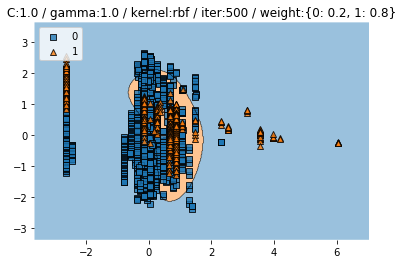

Test CV accuracy scores: [0.9295302  0.9675252  0.93505039 0.95520717 0.9462486 ]
Test CV accuracy: 0.947 +/- 0.014
Test CV f1 scores: [0.93172211 0.96722999 0.93775242 0.95594074 0.94827181]
Test CV f1: 0.948 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9232995658465991


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


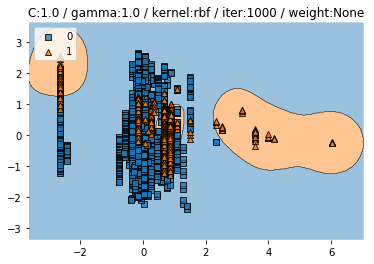

Test CV accuracy scores: [0.95637584 0.95296753 0.97088466 0.96080627 0.95072788]
Test CV accuracy: 0.958 +/- 0.007
Test CV f1 scores: [0.95682113 0.95153331 0.97131176 0.96061141 0.95169919]
Test CV f1: 0.958 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.948339483394834
Test f1 :  0.9122257053291536


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


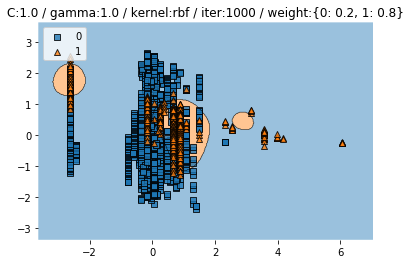

Test CV accuracy scores: [0.93736018 0.96416573 0.9406495  0.95520717 0.94736842]
Test CV accuracy: 0.949 +/- 0.010
Test CV f1 scores: [0.93898225 0.96372626 0.94292346 0.95594074 0.94931372]
Test CV f1: 0.950 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9455719557195572
Test f1 :  0.9125925925925925


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


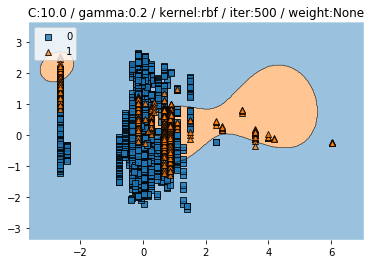

Test CV accuracy scores: [0.95973154 0.95520717 0.96864502 0.95072788 0.95744681]
Test CV accuracy: 0.958 +/- 0.006
Test CV f1 scores: [0.96031808 0.95394894 0.96905057 0.94990937 0.9584232 ]
Test CV f1: 0.958 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9354243542435424
Test f1 :  0.8895899053627759


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


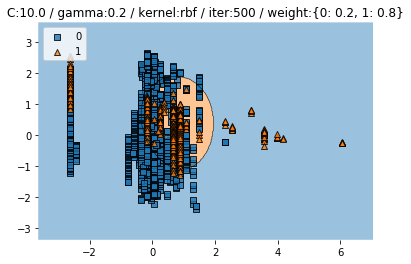

Test CV accuracy scores: [0.93176734 0.97536394 0.94176932 0.95296753 0.94736842]
Test CV accuracy: 0.950 +/- 0.015
Test CV f1 scores: [0.93417875 0.97541162 0.94396113 0.95389468 0.9492413 ]
Test CV f1: 0.951 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9418819188191881
Test f1 :  0.9069423929098965


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


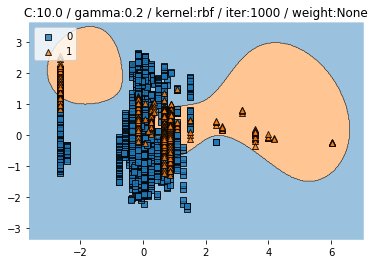

Test CV accuracy scores: [0.95973154 0.95408735 0.96976484 0.95072788 0.95632699]
Test CV accuracy: 0.958 +/- 0.007
Test CV f1 scores: [0.96031808 0.95285222 0.97007567 0.94990937 0.95722363]
Test CV f1: 0.958 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9372693726937269
Test f1 :  0.8927444794952681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


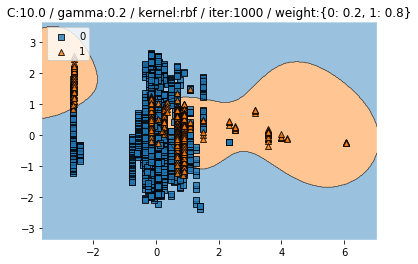

Test CV accuracy scores: [0.93064877 0.97536394 0.94176932 0.9518477  0.94736842]
Test CV accuracy: 0.949 +/- 0.015
Test CV f1 scores: [0.93314731 0.97541162 0.94396113 0.95275725 0.9492413 ]
Test CV f1: 0.951 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9437269372693727
Test f1 :  0.9096296296296297


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


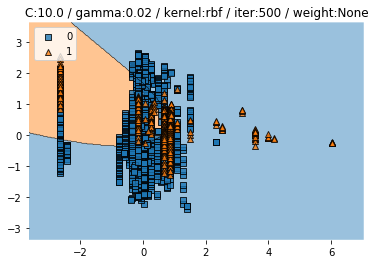

Test CV accuracy scores: [0.94183445 0.95744681 0.93952968 0.94288914 0.94176932]
Test CV accuracy: 0.945 +/- 0.006
Test CV f1 scores: [0.94227125 0.95654907 0.94091718 0.9426052  0.94282086]
Test CV f1: 0.945 +/- 0.006


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9197416974169742
Test f1 :  0.8612440191387559


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


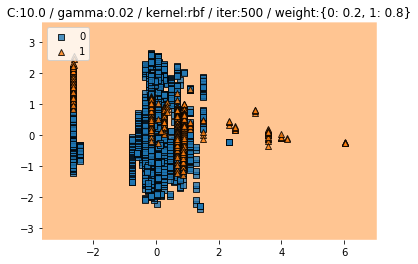

Test CV accuracy scores: [0.87583893 0.96304591 0.86898096 0.8980963  0.92609183]
Test CV accuracy: 0.906 +/- 0.035
Test CV f1 scores: [0.88403556 0.96403789 0.87821522 0.90348762 0.92979515]
Test CV f1: 0.912 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8431734317343174
Test f1 :  0.7941888619854721


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


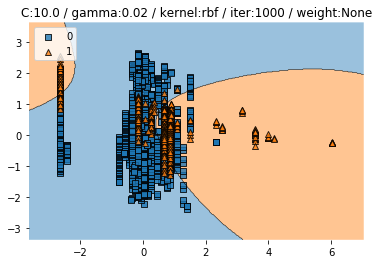

Test CV accuracy scores: [0.94407159 0.95856663 0.9406495  0.94512878 0.94288914]
Test CV accuracy: 0.946 +/- 0.006
Test CV f1 scores: [0.94459257 0.95773951 0.94196392 0.94474385 0.9439679 ]
Test CV f1: 0.947 +/- 0.006
Test accuracy :  0.9215867158671587
Test f1 :  0.8652931854199682


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


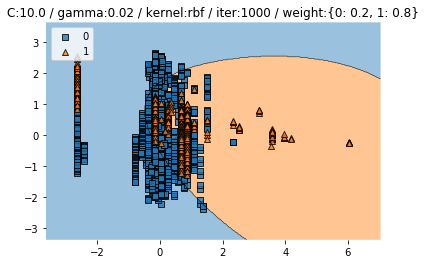

Test CV accuracy scores: [0.88478747 0.95968645 0.87905935 0.88913774 0.92609183]
Test CV accuracy: 0.908 +/- 0.031
Test CV f1 scores: [0.8924893  0.96061145 0.88714714 0.89535786 0.92970986]
Test CV f1: 0.913 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9049815498154982
Test f1 :  0.8567454798331016


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


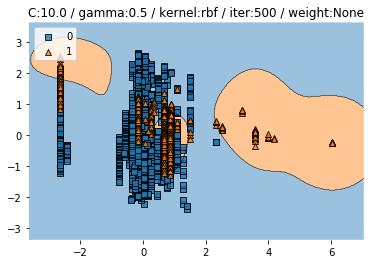

Test CV accuracy scores: [0.96308725 0.95968645 0.97200448 0.96304591 0.94848824]
Test CV accuracy: 0.961 +/- 0.008
Test CV f1 scores: [0.9633979  0.95855405 0.97243915 0.96293653 0.94941846]
Test CV f1: 0.961 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9547970479704797
Test f1 :  0.9242658423493044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


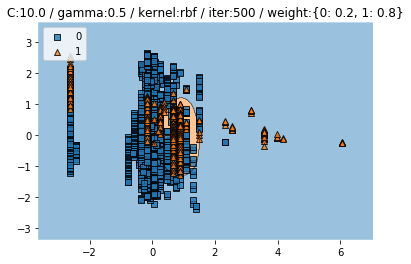

Test CV accuracy scores: [0.93176734 0.96976484 0.95744681 0.95408735 0.94848824]
Test CV accuracy: 0.952 +/- 0.012
Test CV f1 scores: [0.93408394 0.96948999 0.95862147 0.95472118 0.9502854 ]
Test CV f1: 0.953 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9492619926199262
Test f1 :  0.9192364170337738


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


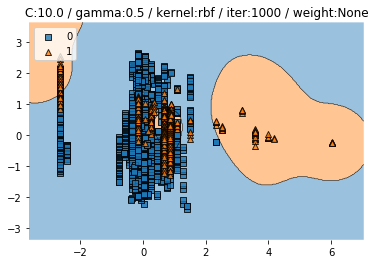

Test CV accuracy scores: [0.96308725 0.95744681 0.97200448 0.96304591 0.94736842]
Test CV accuracy: 0.961 +/- 0.008
Test CV f1 scores: [0.9633979  0.95614919 0.97243915 0.96293653 0.94836258]
Test CV f1: 0.961 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9173166926677068


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


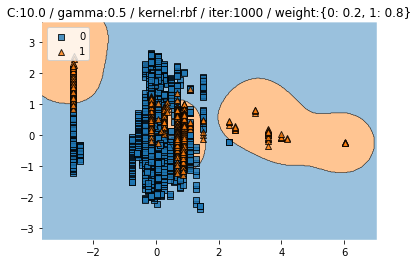

Test CV accuracy scores: [0.93176734 0.96976484 0.95856663 0.95408735 0.95072788]
Test CV accuracy: 0.953 +/- 0.012
Test CV f1 scores: [0.93408394 0.96948999 0.95967885 0.95472118 0.95237743]
Test CV f1: 0.954 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9492619926199262
Test f1 :  0.91899852724595


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


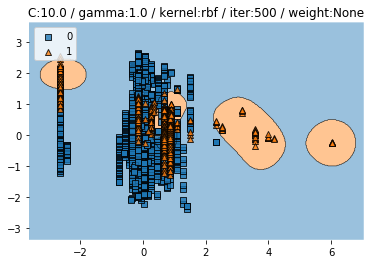

Test CV accuracy scores: [0.94071588 0.95296753 0.97424412 0.96080627 0.96304591]
Test CV accuracy: 0.958 +/- 0.011
Test CV f1 scores: [0.94152853 0.95106304 0.97459969 0.96084434 0.96286219]
Test CV f1: 0.958 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9529520295202952
Test f1 :  0.9196850393700787


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


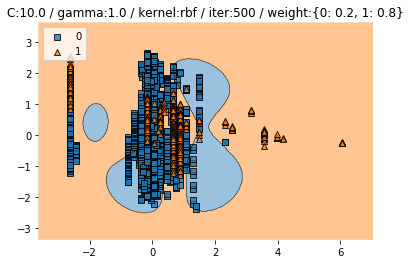

Test CV accuracy scores: [0.93288591 0.9675252  0.96192609 0.95632699 0.95408735]
Test CV accuracy: 0.955 +/- 0.012
Test CV f1 scores: [0.93492469 0.96694973 0.96285979 0.95685354 0.95524907]
Test CV f1: 0.955 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9529520295202952
Test f1 :  0.9244444444444444


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


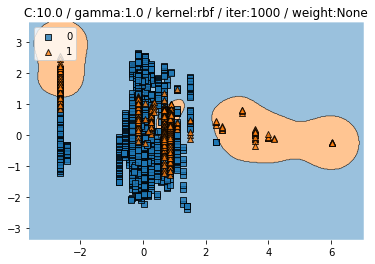

Test CV accuracy scores: [0.93736018 0.95408735 0.97424412 0.96080627 0.96640538]
Test CV accuracy: 0.959 +/- 0.013
Test CV f1 scores: [0.93816465 0.95228716 0.97459969 0.96084434 0.96633934]
Test CV f1: 0.958 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9538745387453874
Test f1 :  0.9216300940438872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


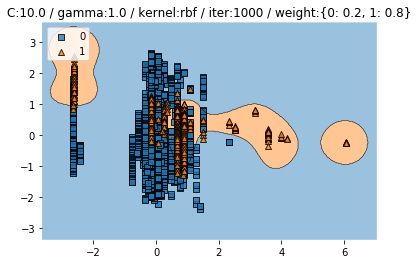

Test CV accuracy scores: [0.93288591 0.96640538 0.96416573 0.95520717 0.95296753]
Test CV accuracy: 0.954 +/- 0.012
Test CV f1 scores: [0.93492469 0.9659209  0.96498796 0.9557076  0.95419396]
Test CV f1: 0.955 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9538745387453874
Test f1 :  0.9258160237388723


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


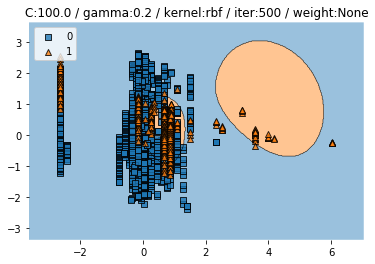

Test CV accuracy scores: [0.93512304 0.95520717 0.92049272 0.93169093 0.96192609]
Test CV accuracy: 0.941 +/- 0.015
Test CV f1 scores: [0.93376452 0.95362079 0.92321078 0.93063129 0.96235146]
Test CV f1: 0.941 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9437269372693727
Test f1 :  0.9062980030721965


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


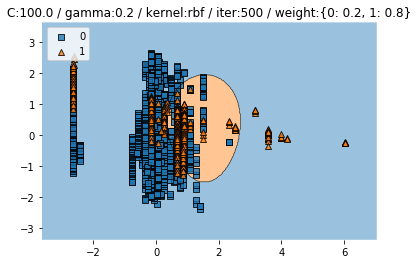

Test CV accuracy scores: [0.91387025 0.9731243  0.94736842 0.94400896 0.9518477 ]
Test CV accuracy: 0.946 +/- 0.019
Test CV f1 scores: [0.91703189 0.97296333 0.9492413  0.94483031 0.9534254 ]
Test CV f1: 0.947 +/- 0.018


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9226277372262772


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


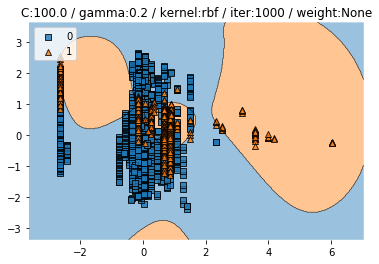

Test CV accuracy scores: [0.94854586 0.96416573 0.96640538 0.95632699 0.94736842]
Test CV accuracy: 0.957 +/- 0.008
Test CV f1 scores: [0.9493826  0.96324398 0.96701204 0.95619772 0.94844899]
Test CV f1: 0.957 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9511070110701108
Test f1 :  0.9175738724727838


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


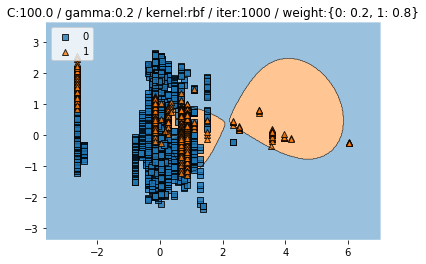

Test CV accuracy scores: [0.93400447 0.9675252  0.95072788 0.9518477  0.94512878]
Test CV accuracy: 0.950 +/- 0.011
Test CV f1 scores: [0.93605721 0.96736374 0.95237743 0.95259534 0.94700462]
Test CV f1: 0.951 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9492619926199262
Test f1 :  0.9192364170337738


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


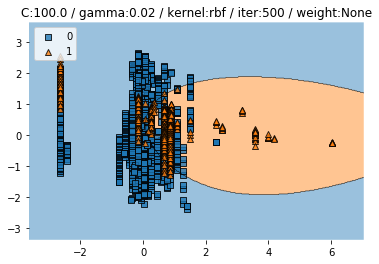

Test CV accuracy scores: [0.95302013 0.96416573 0.94288914 0.95072788 0.94512878]
Test CV accuracy: 0.951 +/- 0.007
Test CV f1 scores: [0.95378411 0.96372626 0.94467785 0.95001732 0.94651718]
Test CV f1: 0.952 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9040590405904059
Test f1 :  0.8395061728395061


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


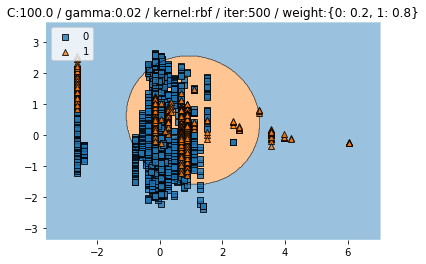

Test CV accuracy scores: [0.90604027 0.96416573 0.89137738 0.91713326 0.9406495 ]
Test CV accuracy: 0.924 +/- 0.026
Test CV f1 scores: [0.9109267  0.96430336 0.8983118  0.92058067 0.94300248]
Test CV f1: 0.927 +/- 0.024


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8846863468634686
Test f1 :  0.826629680998613


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


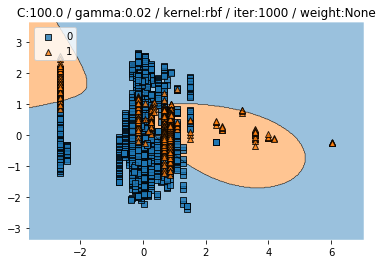

Test CV accuracy scores: [0.94966443 0.9675252  0.95632699 0.94512878 0.96528555]
Test CV accuracy: 0.957 +/- 0.009
Test CV f1 scores: [0.95052516 0.96702143 0.95729421 0.94403341 0.96588337]
Test CV f1: 0.957 +/- 0.009


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9271217712177122
Test f1 :  0.8759811616954474


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


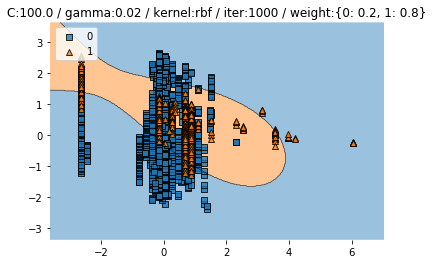

Test CV accuracy scores: [0.90715884 0.97200448 0.91489362 0.92609183 0.94512878]
Test CV accuracy: 0.933 +/- 0.023
Test CV f1 scores: [0.9119359  0.97219047 0.91925457 0.92856615 0.94715686]
Test CV f1: 0.936 +/- 0.022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9326568265682657
Test f1 :  0.8934306569343065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


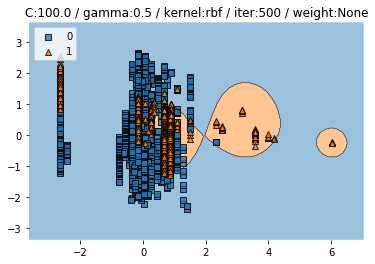

Test CV accuracy scores: [0.93624161 0.94400896 0.9675252  0.95632699 0.96192609]
Test CV accuracy: 0.953 +/- 0.012
Test CV f1 scores: [0.93743749 0.94188495 0.96813861 0.95628423 0.96207232]
Test CV f1: 0.953 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9381918819188192
Test f1 :  0.8958009331259719


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


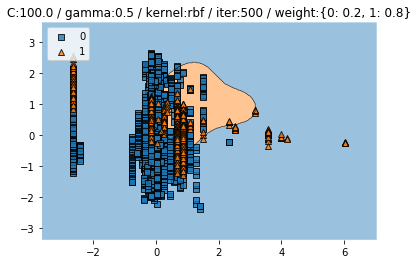

Test CV accuracy scores: [0.9295302  0.97088466 0.95968645 0.95632699 0.95856663]
Test CV accuracy: 0.955 +/- 0.014
Test CV f1 scores: [0.93161932 0.97040099 0.96073768 0.95669717 0.95934926]
Test CV f1: 0.956 +/- 0.013


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9575645756457565
Test f1 :  0.9303030303030303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


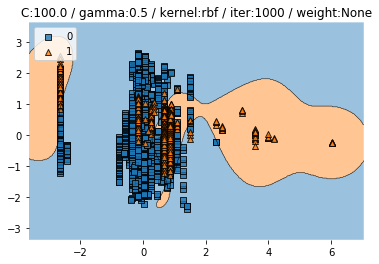

Test CV accuracy scores: [0.93064877 0.9462486  0.97536394 0.95520717 0.9675252 ]
Test CV accuracy: 0.955 +/- 0.016
Test CV f1 scores: [0.93177654 0.94379051 0.97568259 0.95511912 0.9676191 ]
Test CV f1: 0.955 +/- 0.016


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9538745387453874
Test f1 :  0.9221183800623052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


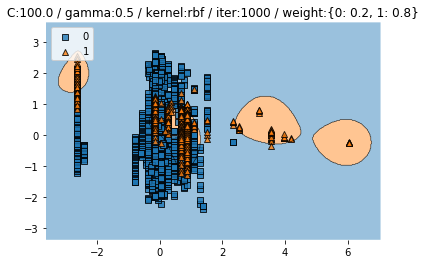

Test CV accuracy scores: [0.9261745  0.96976484 0.95968645 0.95632699 0.94960806]
Test CV accuracy: 0.952 +/- 0.015
Test CV f1 scores: [0.92852397 0.96936155 0.96085993 0.95677597 0.95096076]
Test CV f1: 0.953 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.955719557195572
Test f1 :  0.9281437125748503


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


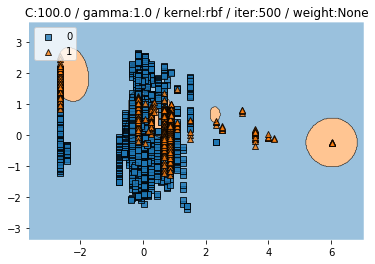

Test CV accuracy scores: [0.9261745  0.93952968 0.95968645 0.96192609 0.95856663]
Test CV accuracy: 0.949 +/- 0.014
Test CV f1 scores: [0.92712262 0.93643756 0.96073768 0.96161965 0.95852607]
Test CV f1: 0.949 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9418819188191881
Test f1 :  0.9023255813953489


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


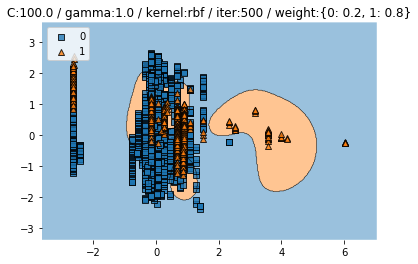

Test CV accuracy scores: [0.93176734 0.95856663 0.9675252  0.95520717 0.96416573]
Test CV accuracy: 0.955 +/- 0.013
Test CV f1 scores: [0.93304714 0.95735315 0.96824441 0.95520717 0.96450193]
Test CV f1: 0.956 +/- 0.012


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9603321033210332
Test f1 :  0.9355322338830585


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


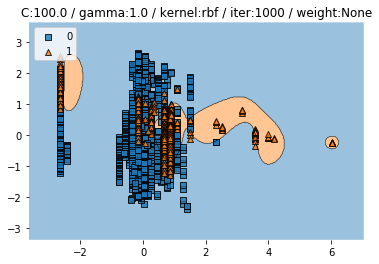

Test CV accuracy scores: [0.92841163 0.94176932 0.96528555 0.96192609 0.95744681]
Test CV accuracy: 0.951 +/- 0.014
Test CV f1 scores: [0.92957579 0.93879173 0.96594127 0.96169805 0.95736317]
Test CV f1: 0.951 +/- 0.014


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9501845018450185
Test f1 :  0.9153605015673981


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


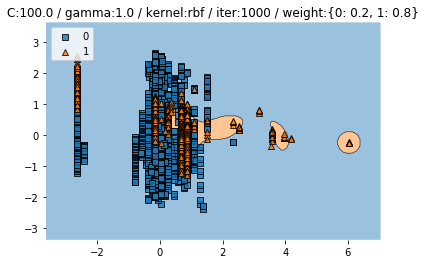

Test CV accuracy scores: [0.92505593 0.96192609 0.96864502 0.95520717 0.96528555]
Test CV accuracy: 0.955 +/- 0.016
Test CV f1 scores: [0.92621134 0.96094673 0.96931419 0.9553792  0.96557981]
Test CV f1: 0.955 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9575645756457565
Test f1 :  0.9309309309309309
738.7975988388062 secs


In [13]:
# news rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(1,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


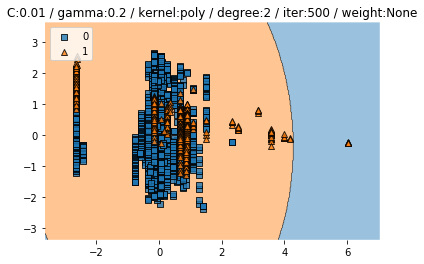

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


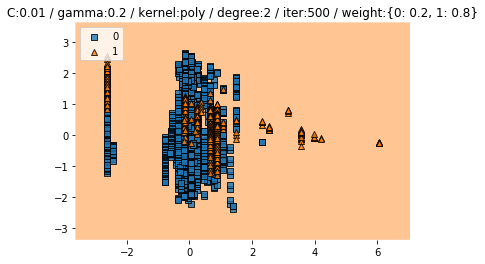

Test CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Test CV accuracy: 0.209 +/- 0.001
Test CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


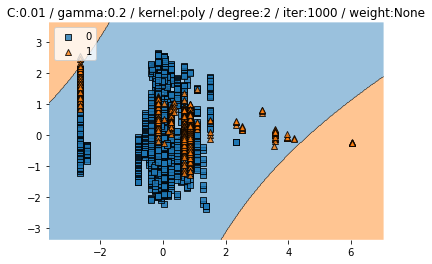

Test CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Test CV accuracy: 0.823 +/- 0.011
Test CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Test CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7472324723247232
Test f1 :  0.36574074074074076


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


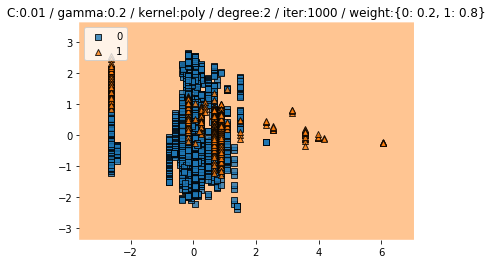

Test CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Test CV accuracy: 0.208 +/- 0.001
Test CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Test CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


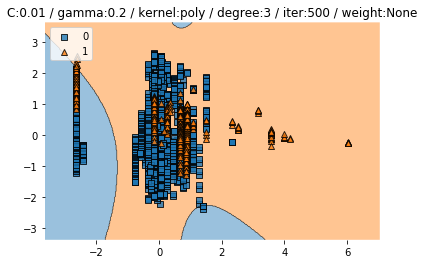

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


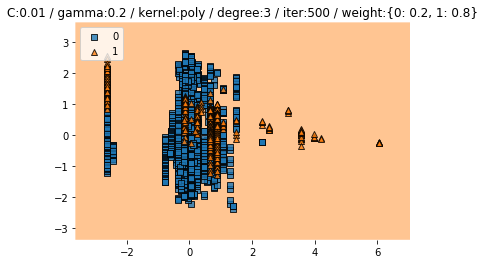

Test CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Test CV accuracy: 0.209 +/- 0.001
Test CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


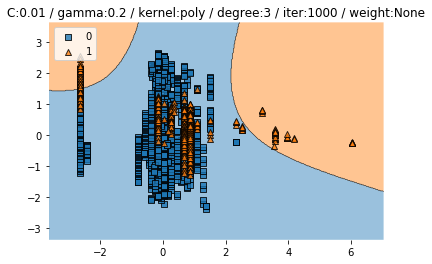

Test CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Test CV accuracy: 0.823 +/- 0.011
Test CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Test CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7472324723247232
Test f1 :  0.36574074074074076


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


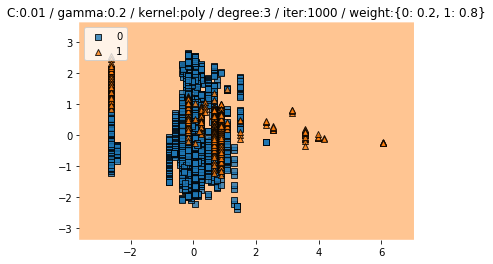

Test CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Test CV accuracy: 0.208 +/- 0.001
Test CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Test CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


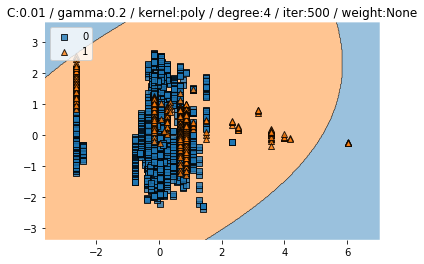

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


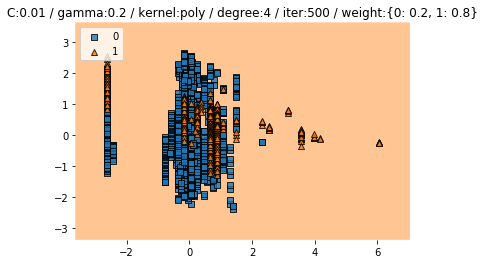

Test CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Test CV accuracy: 0.209 +/- 0.001
Test CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


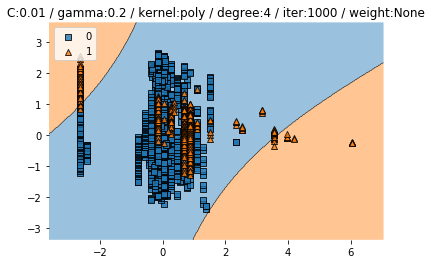

Test CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Test CV accuracy: 0.823 +/- 0.011
Test CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Test CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7472324723247232
Test f1 :  0.36574074074074076


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


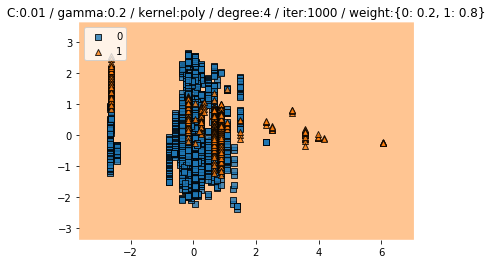

Test CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Test CV accuracy: 0.208 +/- 0.001
Test CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Test CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


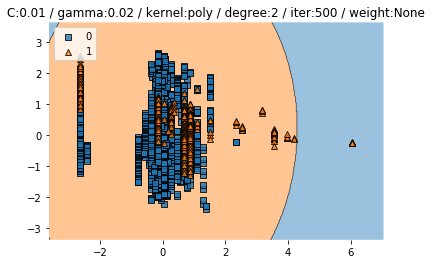

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


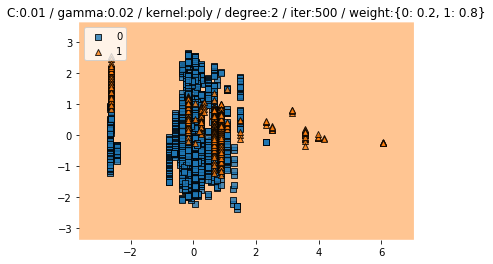

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


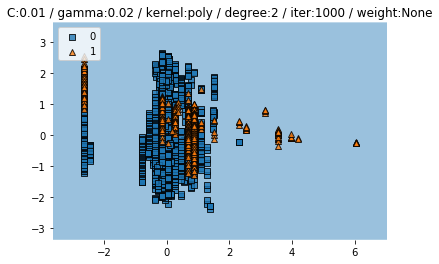

Test CV accuracy scores: [0.79306488 0.79283315 0.78947368 0.79059351 0.79059351]
Test CV accuracy: 0.791 +/- 0.001
Test CV f1 scores: [0.70588707 0.70451803 0.69659443 0.69925841 0.69925841]
Test CV f1: 0.701 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6872693726937269
Test f1 :  0.005865102639296188


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


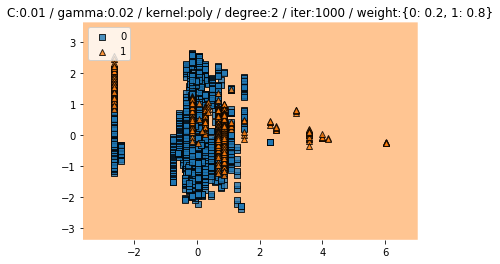

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


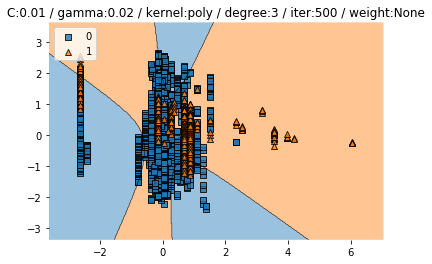

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


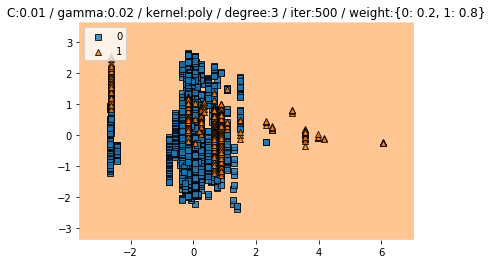

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


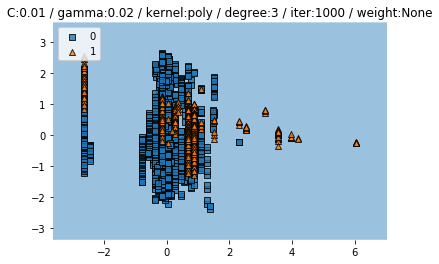

Test CV accuracy scores: [0.79306488 0.79283315 0.78947368 0.79059351 0.79059351]
Test CV accuracy: 0.791 +/- 0.001
Test CV f1 scores: [0.70588707 0.70451803 0.69659443 0.69925841 0.69925841]
Test CV f1: 0.701 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6872693726937269
Test f1 :  0.005865102639296188


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


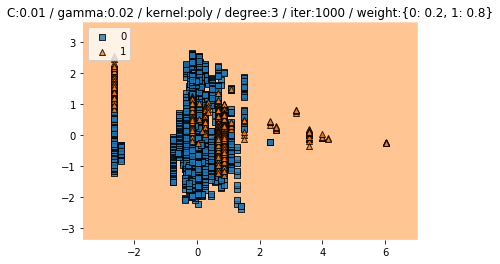

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


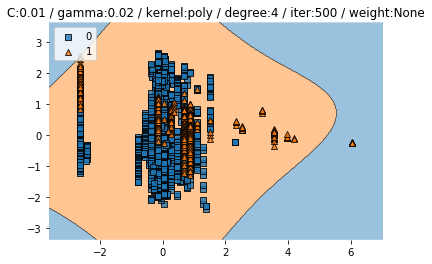

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


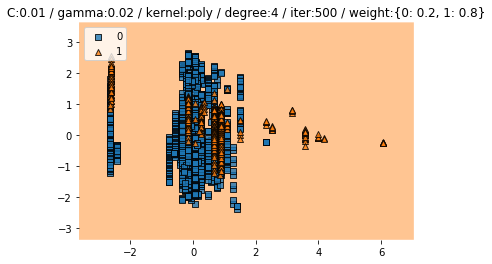

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


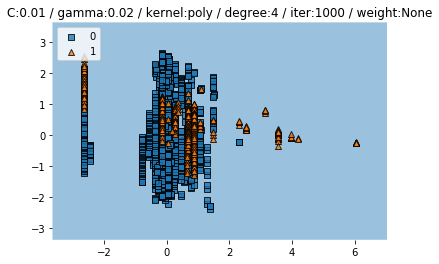

Test CV accuracy scores: [0.79306488 0.79283315 0.78947368 0.79059351 0.79059351]
Test CV accuracy: 0.791 +/- 0.001
Test CV f1 scores: [0.70588707 0.70451803 0.69659443 0.69925841 0.69925841]
Test CV f1: 0.701 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6872693726937269
Test f1 :  0.005865102639296188


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


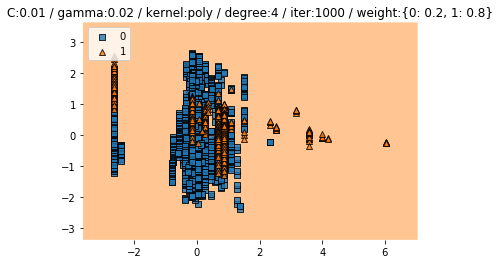

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


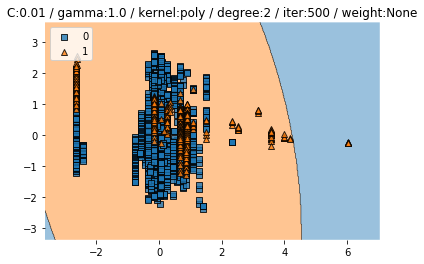

Test CV accuracy scores: [0.27404922 0.22844345 0.21276596 0.20940649 0.23852184]
Test CV accuracy: 0.233 +/- 0.023
Test CV f1 scores: [0.19982003 0.11482047 0.07782889 0.07290448 0.13078572]
Test CV f1: 0.119 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3413284132841328
Test f1 :  0.4870689655172414


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


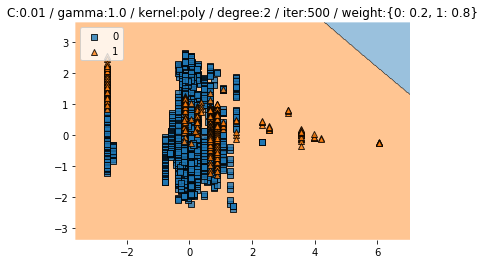

Test CV accuracy scores: [0.34004474 0.32026876 0.28107503 0.20828667 0.24636058]
Test CV accuracy: 0.279 +/- 0.048
Test CV f1 scores: [0.30815288 0.28157333 0.20873408 0.07258183 0.14739167]
Test CV f1: 0.204 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3339483394833948
Test f1 :  0.4805755395683453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


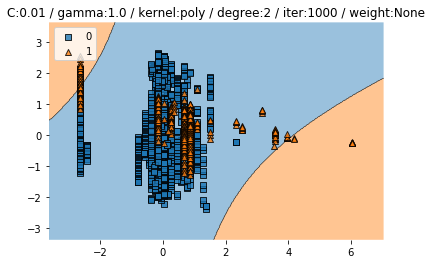

Test CV accuracy scores: [0.94966443 0.93169093 0.9406495  0.93393057 0.93393057]
Test CV accuracy: 0.938 +/- 0.007
Test CV f1 scores: [0.94990343 0.92847591 0.94186801 0.93386589 0.93484268]
Test CV f1: 0.938 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9160516605166051
Test f1 :  0.8548644338118022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


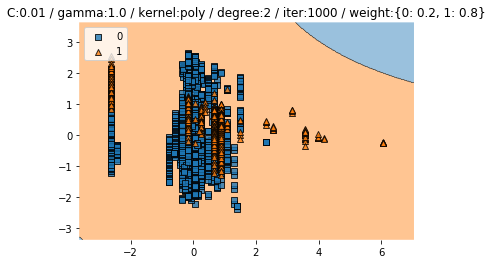

Test CV accuracy scores: [0.70022371 0.7581187  0.85890258 0.93840985 0.76259798]
Test CV accuracy: 0.804 +/- 0.084
Test CV f1 scores: [0.72728242 0.78034543 0.86931099 0.93904303 0.78438943]
Test CV f1: 0.820 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3662361623616236
Test f1 :  0.4967032967032967


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


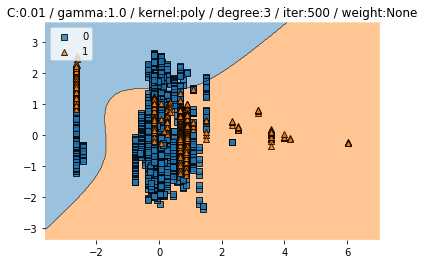

Test CV accuracy scores: [0.27404922 0.22844345 0.21276596 0.20940649 0.23852184]
Test CV accuracy: 0.233 +/- 0.023
Test CV f1 scores: [0.19982003 0.11482047 0.07782889 0.07290448 0.13078572]
Test CV f1: 0.119 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3413284132841328
Test f1 :  0.4870689655172414


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


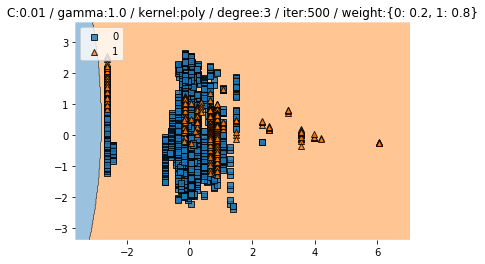

Test CV accuracy scores: [0.34004474 0.32026876 0.28107503 0.20828667 0.24636058]
Test CV accuracy: 0.279 +/- 0.048
Test CV f1 scores: [0.30815288 0.28157333 0.20873408 0.07258183 0.14739167]
Test CV f1: 0.204 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3339483394833948
Test f1 :  0.4805755395683453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


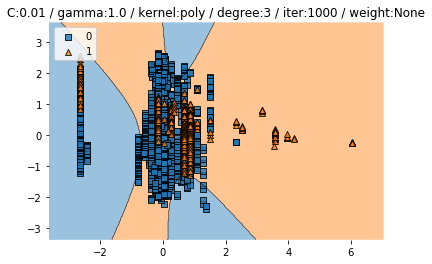

Test CV accuracy scores: [0.94966443 0.93169093 0.9406495  0.93393057 0.93393057]
Test CV accuracy: 0.938 +/- 0.007
Test CV f1 scores: [0.94990343 0.92847591 0.94186801 0.93386589 0.93484268]
Test CV f1: 0.938 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9160516605166051
Test f1 :  0.8548644338118022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


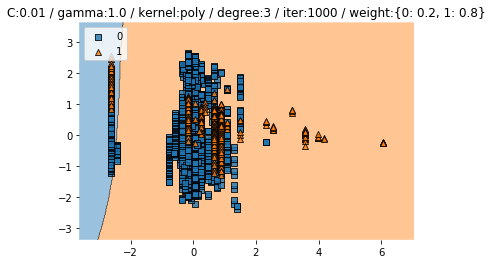

Test CV accuracy scores: [0.70022371 0.7581187  0.85890258 0.93840985 0.76259798]
Test CV accuracy: 0.804 +/- 0.084
Test CV f1 scores: [0.72728242 0.78034543 0.86931099 0.93904303 0.78438943]
Test CV f1: 0.820 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3662361623616236
Test f1 :  0.4967032967032967


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


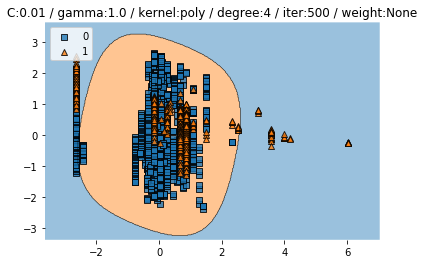

Test CV accuracy scores: [0.27404922 0.22844345 0.21276596 0.20940649 0.23852184]
Test CV accuracy: 0.233 +/- 0.023
Test CV f1 scores: [0.19982003 0.11482047 0.07782889 0.07290448 0.13078572]
Test CV f1: 0.119 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3413284132841328
Test f1 :  0.4870689655172414


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


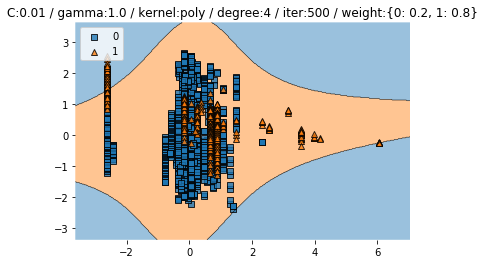

Test CV accuracy scores: [0.34004474 0.32026876 0.28107503 0.20828667 0.24636058]
Test CV accuracy: 0.279 +/- 0.048
Test CV f1 scores: [0.30815288 0.28157333 0.20873408 0.07258183 0.14739167]
Test CV f1: 0.204 +/- 0.086


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3339483394833948
Test f1 :  0.4805755395683453


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


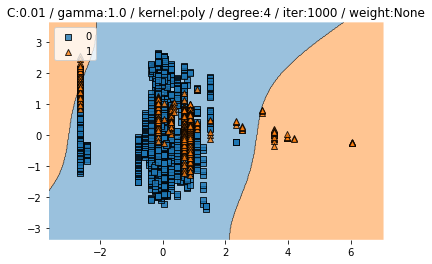

Test CV accuracy scores: [0.94966443 0.93169093 0.9406495  0.93393057 0.93393057]
Test CV accuracy: 0.938 +/- 0.007
Test CV f1 scores: [0.94990343 0.92847591 0.94186801 0.93386589 0.93484268]
Test CV f1: 0.938 +/- 0.007


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9160516605166051
Test f1 :  0.8548644338118022


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


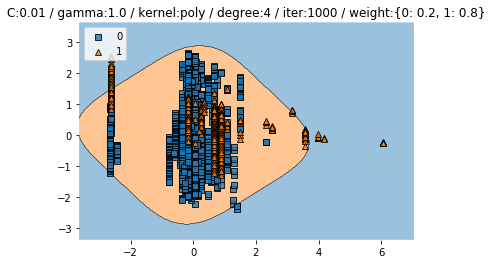

Test CV accuracy scores: [0.70022371 0.7581187  0.85890258 0.93840985 0.76259798]
Test CV accuracy: 0.804 +/- 0.084
Test CV f1 scores: [0.72728242 0.78034543 0.86931099 0.93904303 0.78438943]
Test CV f1: 0.820 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3662361623616236
Test f1 :  0.4967032967032967


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


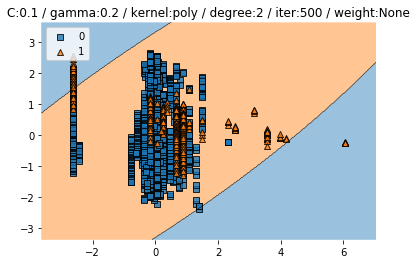

Test CV accuracy scores: [0.21364653 0.33482643 0.21164614 0.20940649 0.74356103]
Test CV accuracy: 0.343 +/- 0.206
Test CV f1 scores: [0.08613488 0.29978177 0.07553082 0.07290448 0.76723149]
Test CV f1: 0.260 +/- 0.268


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


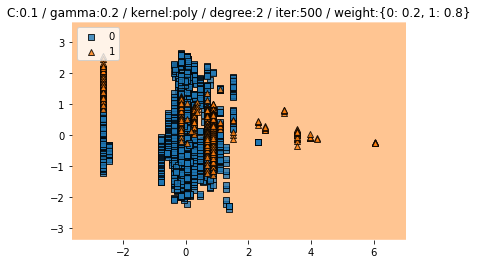

Test CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Test CV accuracy: 0.211 +/- 0.006
Test CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Test CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


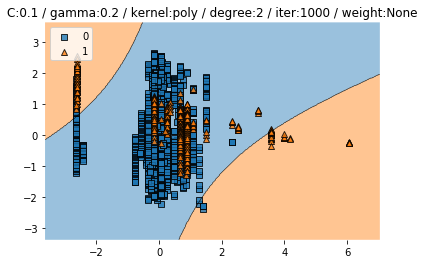

Test CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.89025756]
Test CV accuracy: 0.908 +/- 0.024
Test CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.8855286 ]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8505535055350554
Test f1 :  0.7


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


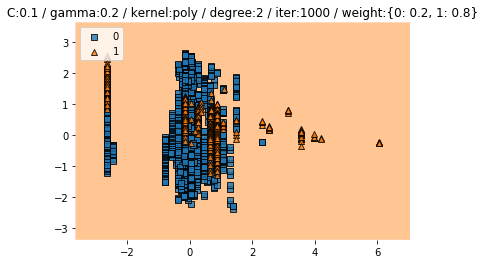

Test CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Test CV accuracy: 0.418 +/- 0.098
Test CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Test CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


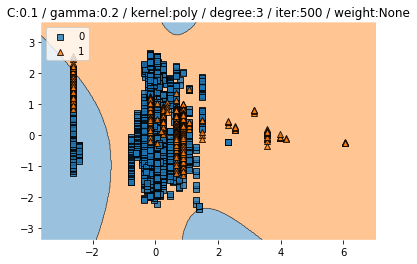

Test CV accuracy scores: [0.21364653 0.33482643 0.21164614 0.20940649 0.74356103]
Test CV accuracy: 0.343 +/- 0.206
Test CV f1 scores: [0.08613488 0.29978177 0.07553082 0.07290448 0.76723149]
Test CV f1: 0.260 +/- 0.268


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


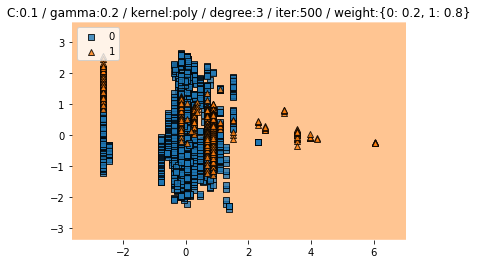

Test CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Test CV accuracy: 0.211 +/- 0.006
Test CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Test CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


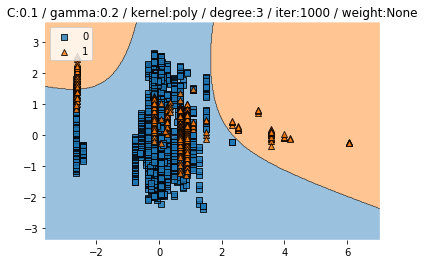

Test CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.89025756]
Test CV accuracy: 0.908 +/- 0.024
Test CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.8855286 ]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8505535055350554
Test f1 :  0.7


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


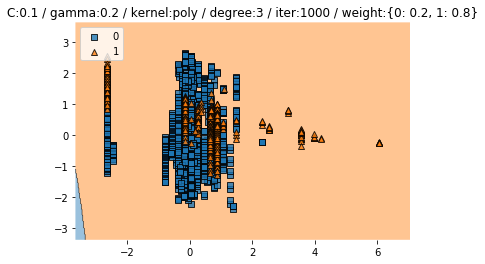

Test CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Test CV accuracy: 0.418 +/- 0.098
Test CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Test CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


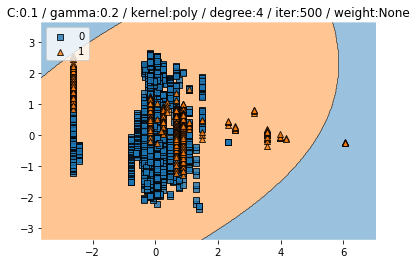

Test CV accuracy scores: [0.21364653 0.33482643 0.21164614 0.20940649 0.74356103]
Test CV accuracy: 0.343 +/- 0.206
Test CV f1 scores: [0.08613488 0.29978177 0.07553082 0.07290448 0.76723149]
Test CV f1: 0.260 +/- 0.268


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


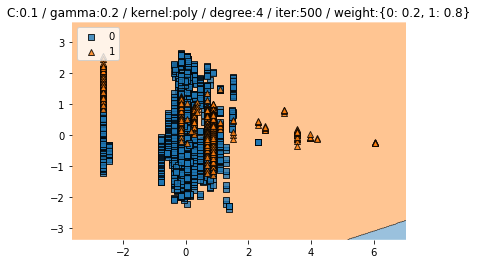

Test CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Test CV accuracy: 0.211 +/- 0.006
Test CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Test CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


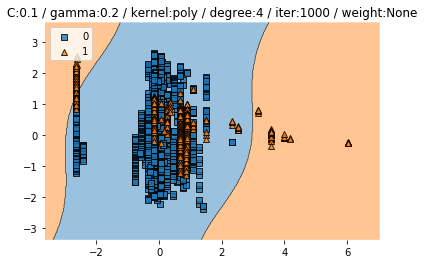

Test CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.89025756]
Test CV accuracy: 0.908 +/- 0.024
Test CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.8855286 ]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8505535055350554
Test f1 :  0.7


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


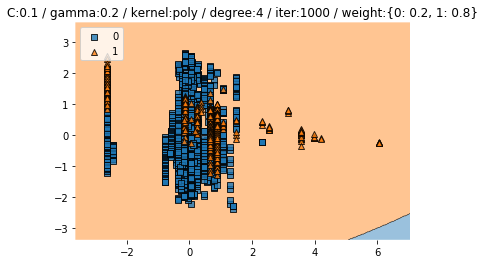

Test CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Test CV accuracy: 0.418 +/- 0.098
Test CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Test CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


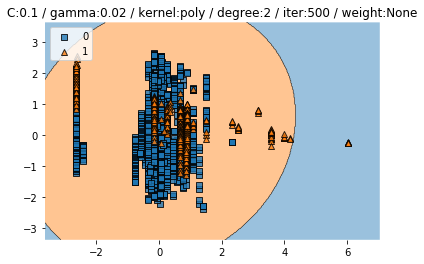

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


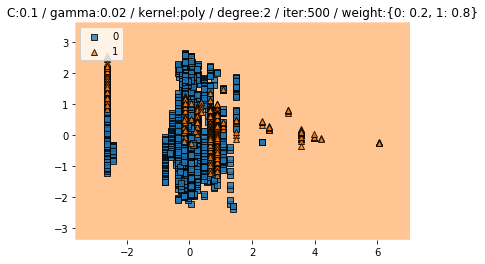

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


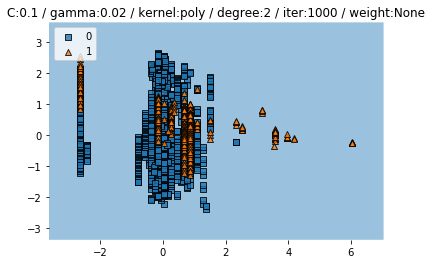

Test CV accuracy scores: [0.79977629 0.79619261 0.79059351 0.79731243 0.79955207]
Test CV accuracy: 0.797 +/- 0.003
Test CV f1 scores: [0.72100347 0.71224203 0.69925841 0.71477398 0.7197758 ]
Test CV f1: 0.713 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.690959409594096
Test f1 :  0.028985507246376812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


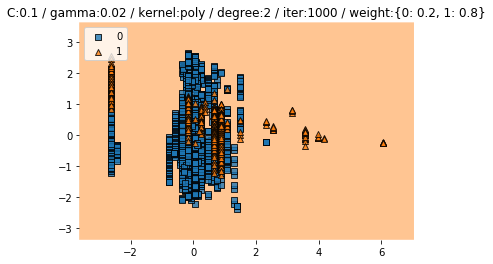

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


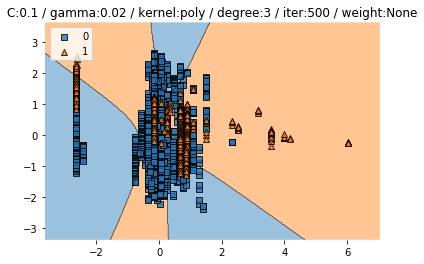

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


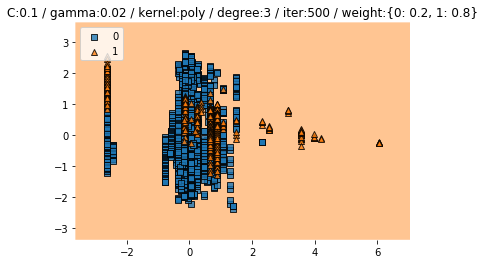

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


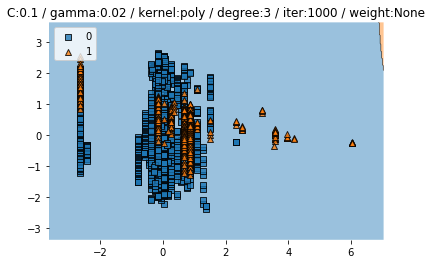

Test CV accuracy scores: [0.79977629 0.79619261 0.79059351 0.79731243 0.79955207]
Test CV accuracy: 0.797 +/- 0.003
Test CV f1 scores: [0.72100347 0.71224203 0.69925841 0.71477398 0.7197758 ]
Test CV f1: 0.713 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.690959409594096
Test f1 :  0.028985507246376812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


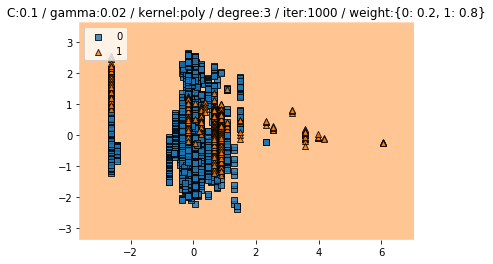

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


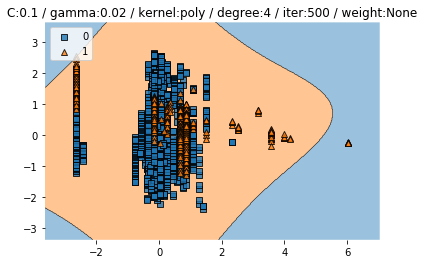

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


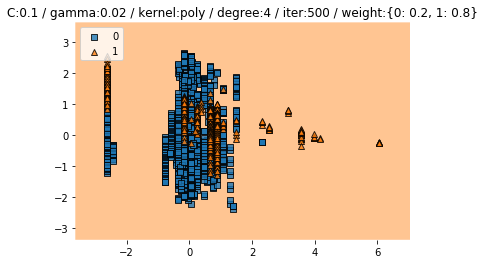

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


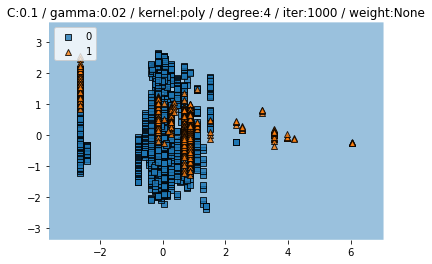

Test CV accuracy scores: [0.79977629 0.79619261 0.79059351 0.79731243 0.79955207]
Test CV accuracy: 0.797 +/- 0.003
Test CV f1 scores: [0.72100347 0.71224203 0.69925841 0.71477398 0.7197758 ]
Test CV f1: 0.713 +/- 0.008


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.690959409594096
Test f1 :  0.028985507246376812


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


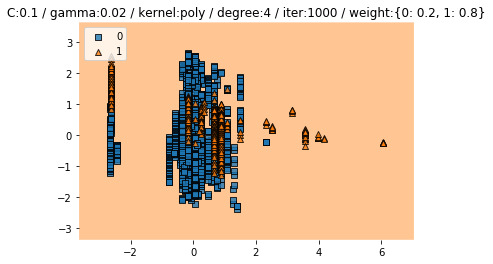

Test CV accuracy scores: [0.2114094  0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.211 +/- 0.000
Test CV f1 scores: [0.07378832 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


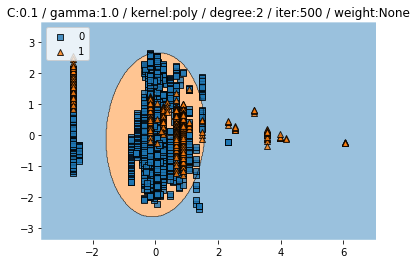

Test CV accuracy scores: [0.89709172 0.21388578 0.22508399 0.28331467 0.26539754]
Test CV accuracy: 0.377 +/- 0.261
Test CV f1 scores: [0.9006574  0.09162388 0.10824107 0.21548487 0.18087127]
Test CV f1: 0.299 +/- 0.304


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


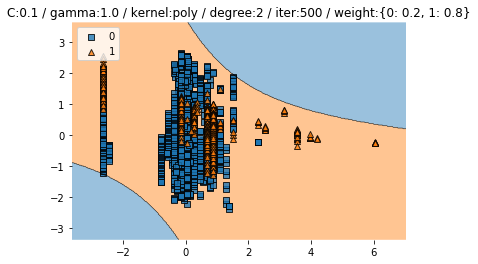

Test CV accuracy scores: [0.42393736 0.86450168 0.23180291 0.2206047  0.30347144]
Test CV accuracy: 0.409 +/- 0.239
Test CV f1 scores: [0.42722655 0.87350596 0.11597309 0.1030864  0.24694113]
Test CV f1: 0.353 +/- 0.285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.48554913294797686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


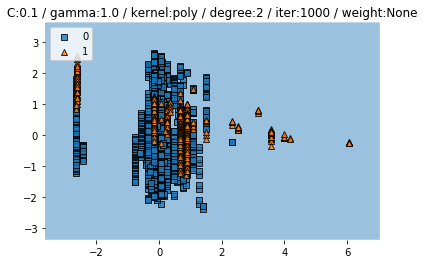

Test CV accuracy scores: [0.69127517 0.67861142 0.31243001 0.23628219 0.32922732]
Test CV accuracy: 0.450 +/- 0.195
Test CV f1 scores: [0.71908891 0.70741906 0.26046527 0.13342937 0.28872907]
Test CV f1: 0.422 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36900369003690037
Test f1 :  0.4955752212389381


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


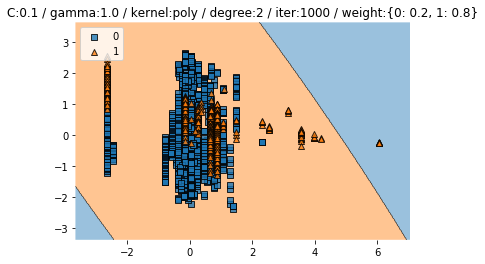

Test CV accuracy scores: [0.61856823 0.71556551 0.39865622 0.51511758 0.76483763]
Test CV accuracy: 0.603 +/- 0.133
Test CV f1 scores: [0.64855945 0.74175598 0.39055329 0.53786625 0.78636903]
Test CV f1: 0.621 +/- 0.143


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4022140221402214
Test f1 :  0.5113122171945701


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


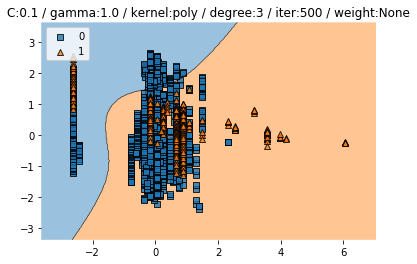

Test CV accuracy scores: [0.89709172 0.21388578 0.22508399 0.28331467 0.26539754]
Test CV accuracy: 0.377 +/- 0.261
Test CV f1 scores: [0.9006574  0.09162388 0.10824107 0.21548487 0.18087127]
Test CV f1: 0.299 +/- 0.304


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


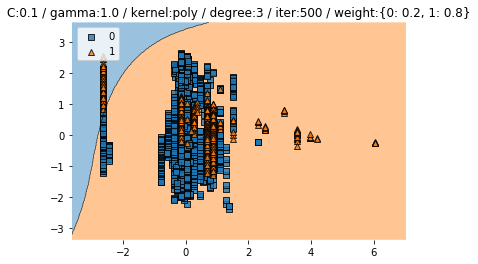

Test CV accuracy scores: [0.42393736 0.86450168 0.23180291 0.2206047  0.30347144]
Test CV accuracy: 0.409 +/- 0.239
Test CV f1 scores: [0.42722655 0.87350596 0.11597309 0.1030864  0.24694113]
Test CV f1: 0.353 +/- 0.285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.48554913294797686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


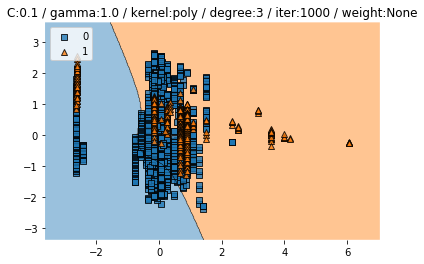

Test CV accuracy scores: [0.69127517 0.67861142 0.31243001 0.23628219 0.32922732]
Test CV accuracy: 0.450 +/- 0.195
Test CV f1 scores: [0.71908891 0.70741906 0.26046527 0.13342937 0.28872907]
Test CV f1: 0.422 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36900369003690037
Test f1 :  0.4955752212389381


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


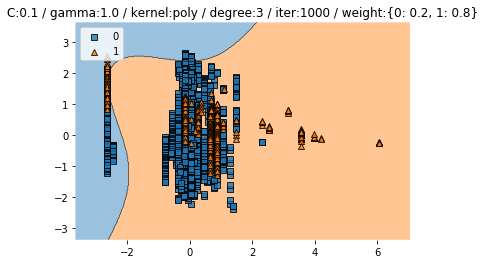

Test CV accuracy scores: [0.61856823 0.71556551 0.39865622 0.51511758 0.76483763]
Test CV accuracy: 0.603 +/- 0.133
Test CV f1 scores: [0.64855945 0.74175598 0.39055329 0.53786625 0.78636903]
Test CV f1: 0.621 +/- 0.143


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4022140221402214
Test f1 :  0.5113122171945701


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


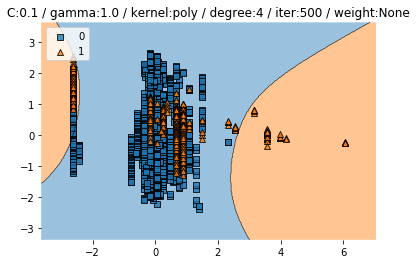

Test CV accuracy scores: [0.89709172 0.21388578 0.22508399 0.28331467 0.26539754]
Test CV accuracy: 0.377 +/- 0.261
Test CV f1 scores: [0.9006574  0.09162388 0.10824107 0.21548487 0.18087127]
Test CV f1: 0.299 +/- 0.304


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


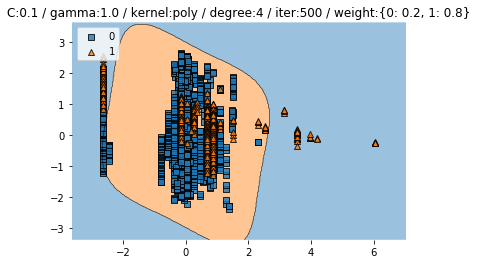

Test CV accuracy scores: [0.42393736 0.86450168 0.23180291 0.2206047  0.30347144]
Test CV accuracy: 0.409 +/- 0.239
Test CV f1 scores: [0.42722655 0.87350596 0.11597309 0.1030864  0.24694113]
Test CV f1: 0.353 +/- 0.285


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.48554913294797686


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


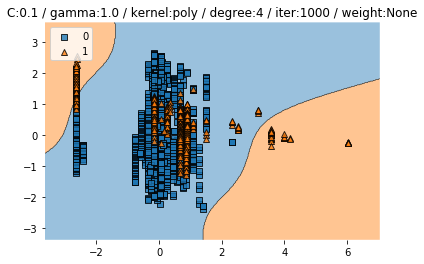

Test CV accuracy scores: [0.69127517 0.67861142 0.31243001 0.23628219 0.32922732]
Test CV accuracy: 0.450 +/- 0.195
Test CV f1 scores: [0.71908891 0.70741906 0.26046527 0.13342937 0.28872907]
Test CV f1: 0.422 +/- 0.244


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36900369003690037
Test f1 :  0.4955752212389381


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


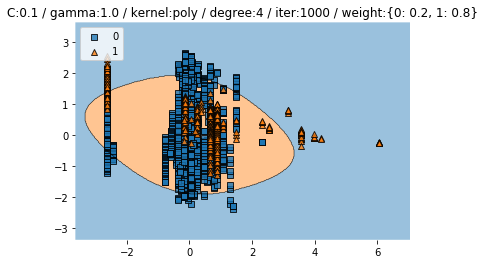

Test CV accuracy scores: [0.61856823 0.71556551 0.39865622 0.51511758 0.76483763]
Test CV accuracy: 0.603 +/- 0.133
Test CV f1 scores: [0.64855945 0.74175598 0.39055329 0.53786625 0.78636903]
Test CV f1: 0.621 +/- 0.143


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4022140221402214
Test f1 :  0.5113122171945701


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


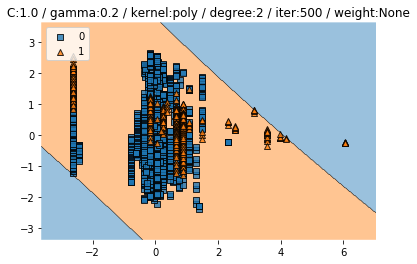

Test CV accuracy scores: [0.22706935 0.22284434 0.22956327 0.9193729  0.43337066]
Test CV accuracy: 0.406 +/- 0.269
Test CV f1 scores: [0.11277417 0.10382605 0.11157395 0.91336388 0.43802719]
Test CV f1: 0.336 +/- 0.316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4749823819591262


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


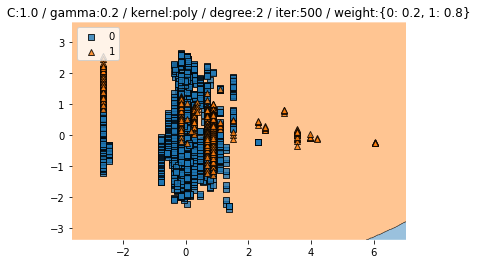

Test CV accuracy scores: [0.21588367 0.40425532 0.31690929 0.23404255 0.27883539]
Test CV accuracy: 0.290 +/- 0.067
Test CV f1 scores: [0.10356666 0.4069225  0.27146562 0.13934654 0.20481174]
Test CV f1: 0.225 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37084870848708484
Test f1 :  0.48952095808383234


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


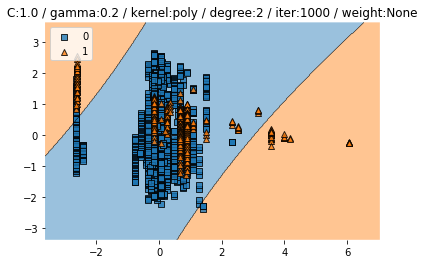

Test CV accuracy scores: [0.950783   0.93729003 0.93952968 0.92833147 0.92161254]
Test CV accuracy: 0.936 +/- 0.010
Test CV f1 scores: [0.95049036 0.93475072 0.94082023 0.92648796 0.9219136 ]
Test CV f1: 0.935 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9031365313653137
Test f1 :  0.8275862068965518


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


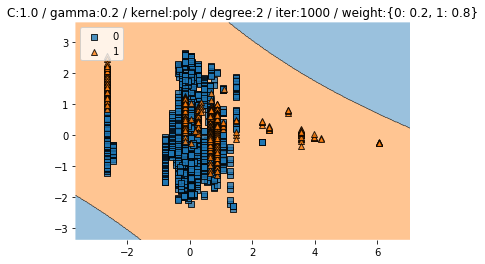

Test CV accuracy scores: [0.5704698  0.76595745 0.5162374  0.26315789 0.92721165]
Test CV accuracy: 0.609 +/- 0.226
Test CV f1 scores: [0.59947111 0.78726707 0.5387168  0.17681193 0.93081704]
Test CV f1: 0.607 +/- 0.256


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5618081180811808
Test f1 :  0.5858761987794245


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


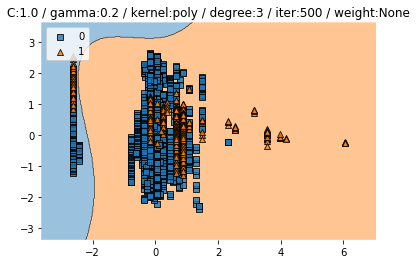

Test CV accuracy scores: [0.22706935 0.22284434 0.22956327 0.9193729  0.43337066]
Test CV accuracy: 0.406 +/- 0.269
Test CV f1 scores: [0.11277417 0.10382605 0.11157395 0.91336388 0.43802719]
Test CV f1: 0.336 +/- 0.316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4749823819591262


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


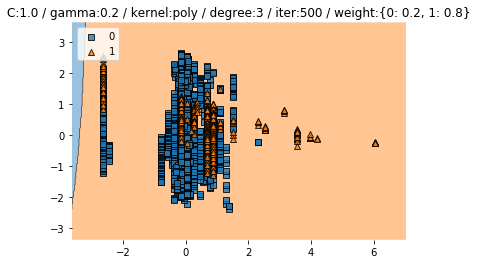

Test CV accuracy scores: [0.21588367 0.40425532 0.31690929 0.23404255 0.27883539]
Test CV accuracy: 0.290 +/- 0.067
Test CV f1 scores: [0.10356666 0.4069225  0.27146562 0.13934654 0.20481174]
Test CV f1: 0.225 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37084870848708484
Test f1 :  0.48952095808383234


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


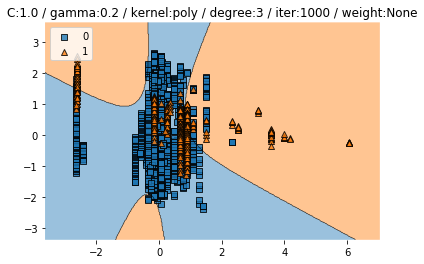

Test CV accuracy scores: [0.950783   0.93729003 0.93952968 0.92833147 0.92161254]
Test CV accuracy: 0.936 +/- 0.010
Test CV f1 scores: [0.95049036 0.93475072 0.94082023 0.92648796 0.9219136 ]
Test CV f1: 0.935 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9031365313653137
Test f1 :  0.8275862068965518


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


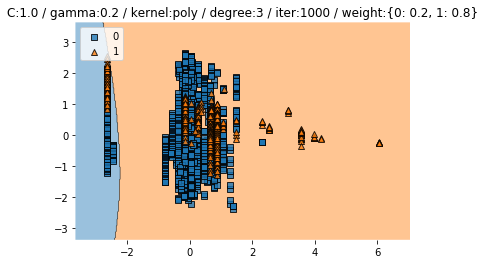

Test CV accuracy scores: [0.5704698  0.76595745 0.5162374  0.26315789 0.92721165]
Test CV accuracy: 0.609 +/- 0.226
Test CV f1 scores: [0.59947111 0.78726707 0.5387168  0.17681193 0.93081704]
Test CV f1: 0.607 +/- 0.256


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5618081180811808
Test f1 :  0.5858761987794245


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


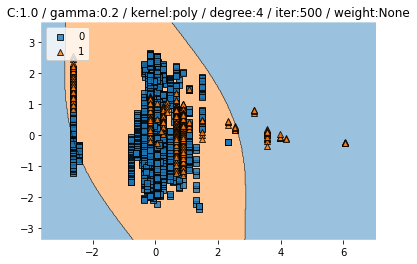

Test CV accuracy scores: [0.22706935 0.22284434 0.22956327 0.9193729  0.43337066]
Test CV accuracy: 0.406 +/- 0.269
Test CV f1 scores: [0.11277417 0.10382605 0.11157395 0.91336388 0.43802719]
Test CV f1: 0.336 +/- 0.316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4749823819591262


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


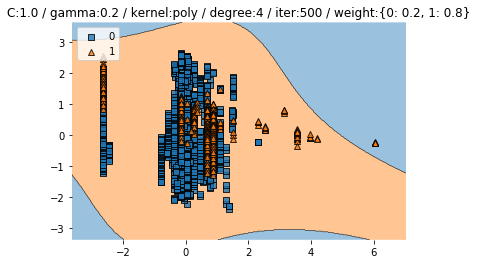

Test CV accuracy scores: [0.21588367 0.40425532 0.31690929 0.23404255 0.27883539]
Test CV accuracy: 0.290 +/- 0.067
Test CV f1 scores: [0.10356666 0.4069225  0.27146562 0.13934654 0.20481174]
Test CV f1: 0.225 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37084870848708484
Test f1 :  0.48952095808383234


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


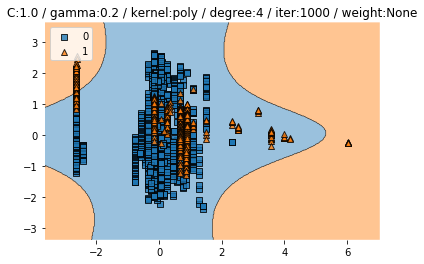

Test CV accuracy scores: [0.950783   0.93729003 0.93952968 0.92833147 0.92161254]
Test CV accuracy: 0.936 +/- 0.010
Test CV f1 scores: [0.95049036 0.93475072 0.94082023 0.92648796 0.9219136 ]
Test CV f1: 0.935 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9031365313653137
Test f1 :  0.8275862068965518


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


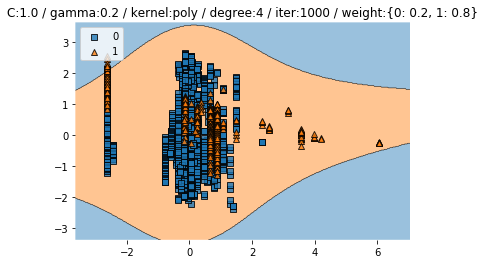

Test CV accuracy scores: [0.5704698  0.76595745 0.5162374  0.26315789 0.92721165]
Test CV accuracy: 0.609 +/- 0.226
Test CV f1 scores: [0.59947111 0.78726707 0.5387168  0.17681193 0.93081704]
Test CV f1: 0.607 +/- 0.256


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5618081180811808
Test f1 :  0.5858761987794245


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


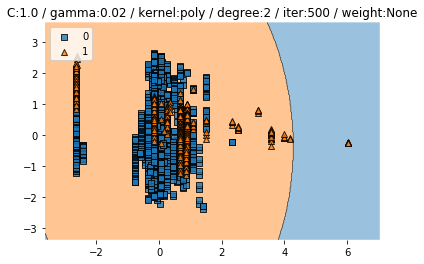

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


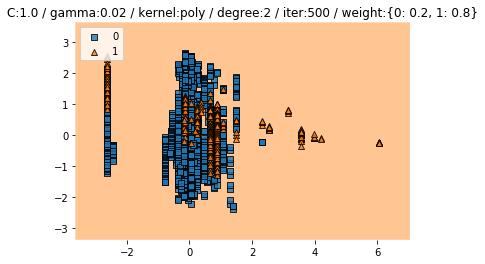

Test CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.000
Test CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


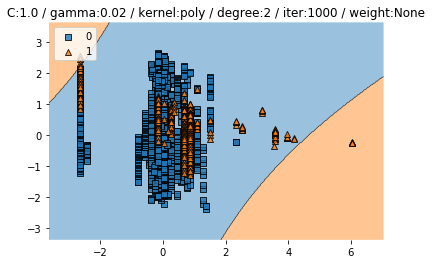

Test CV accuracy scores: [0.82102908 0.81522956 0.81634938 0.81410974 0.80515118]
Test CV accuracy: 0.814 +/- 0.005
Test CV f1 scores: [0.76447122 0.75266365 0.75488228 0.75042874 0.73193306]
Test CV f1: 0.751 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.709409594095941
Test f1 :  0.13698630136986303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


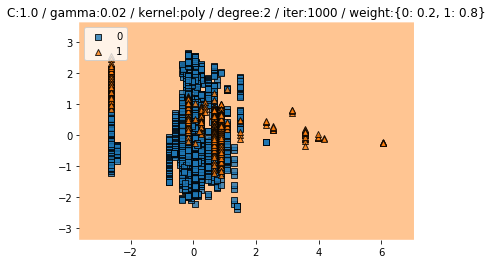

Test CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.000
Test CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


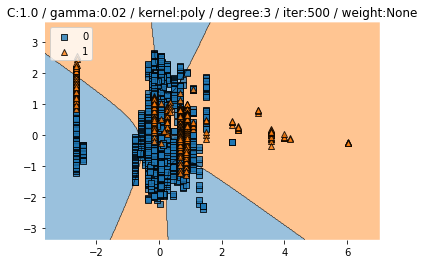

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


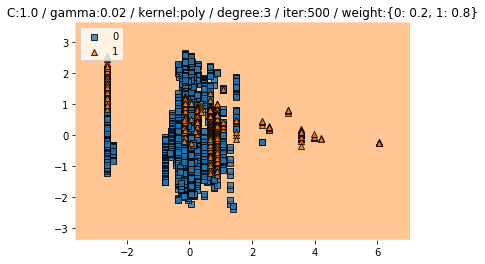

Test CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.000
Test CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


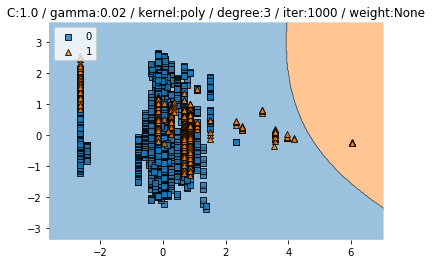

Test CV accuracy scores: [0.82102908 0.81522956 0.81634938 0.81410974 0.80515118]
Test CV accuracy: 0.814 +/- 0.005
Test CV f1 scores: [0.76447122 0.75266365 0.75488228 0.75042874 0.73193306]
Test CV f1: 0.751 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.709409594095941
Test f1 :  0.13698630136986303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


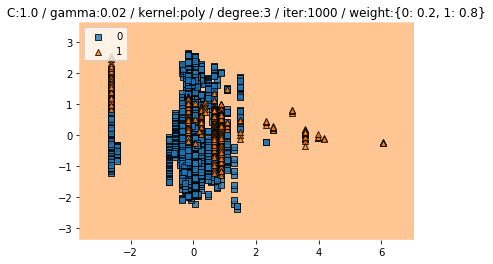

Test CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.000
Test CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


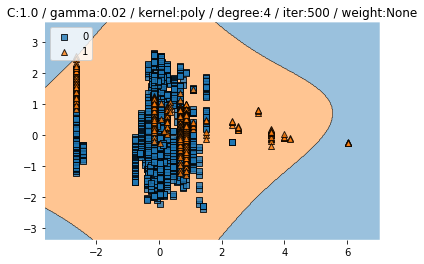

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


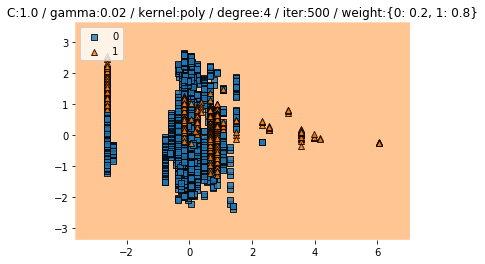

Test CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.000
Test CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


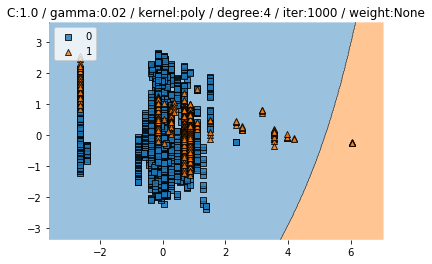

Test CV accuracy scores: [0.82102908 0.81522956 0.81634938 0.81410974 0.80515118]
Test CV accuracy: 0.814 +/- 0.005
Test CV f1 scores: [0.76447122 0.75266365 0.75488228 0.75042874 0.73193306]
Test CV f1: 0.751 +/- 0.011


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.709409594095941
Test f1 :  0.13698630136986303


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


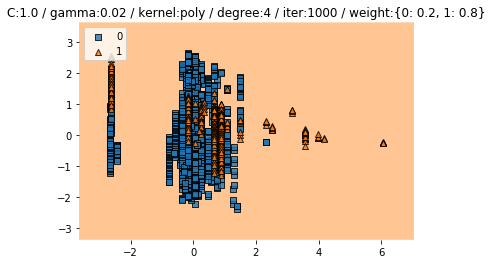

Test CV accuracy scores: [0.21029083 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.000
Test CV f1 scores: [0.07346574 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


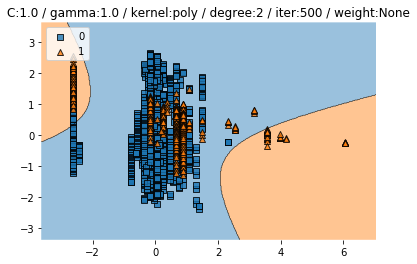

Test CV accuracy scores: [0.3098434  0.20268757 0.90929451 0.20716685 0.4031355 ]
Test CV accuracy: 0.406 +/- 0.262
Test CV f1 scores: [0.26040115 0.08804702 0.9097283  0.07811891 0.39838337]
Test CV f1: 0.347 +/- 0.305


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3284132841328413
Test f1 :  0.4785100286532951


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


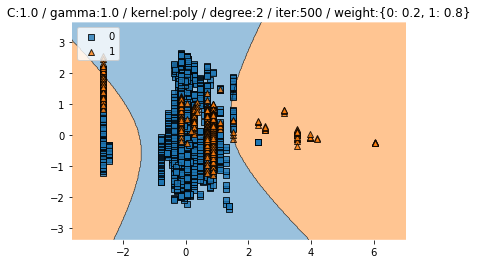

Test CV accuracy scores: [0.21812081 0.21052632 0.21724524 0.22284434 0.26091825]
Test CV accuracy: 0.226 +/- 0.018
Test CV f1 scores: [0.13013811 0.08679728 0.0869597  0.11110201 0.17273236]
Test CV f1: 0.118 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5249077490774908
Test f1 :  0.5661331086773378


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


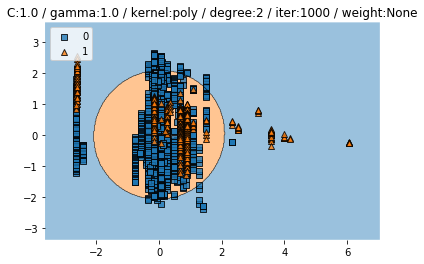

Test CV accuracy scores: [0.46868009 0.40761478 0.52071669 0.268757   0.30907055]
Test CV accuracy: 0.395 +/- 0.095
Test CV f1 scores: [0.48559975 0.40528361 0.54384045 0.19146328 0.25748705]
Test CV f1: 0.377 +/- 0.134


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7481549815498155
Test f1 :  0.6374501992031872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


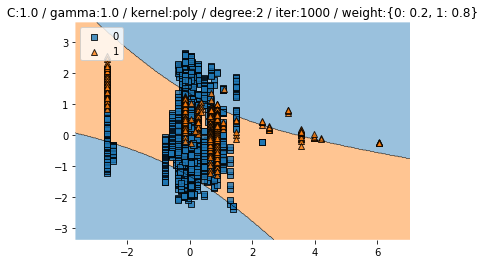

Test CV accuracy scores: [0.24944072 0.31354983 0.62262038 0.60806271 0.30907055]
Test CV accuracy: 0.421 +/- 0.161
Test CV f1 scores: [0.17117373 0.27090914 0.65254245 0.63804187 0.25621457]
Test CV f1: 0.398 +/- 0.205


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41789667896678967
Test f1 :  0.5157329240214888


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


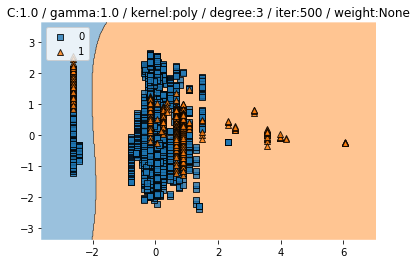

Test CV accuracy scores: [0.3098434  0.20268757 0.90929451 0.20716685 0.4031355 ]
Test CV accuracy: 0.406 +/- 0.262
Test CV f1 scores: [0.26040115 0.08804702 0.9097283  0.07811891 0.39838337]
Test CV f1: 0.347 +/- 0.305


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3284132841328413
Test f1 :  0.4785100286532951


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


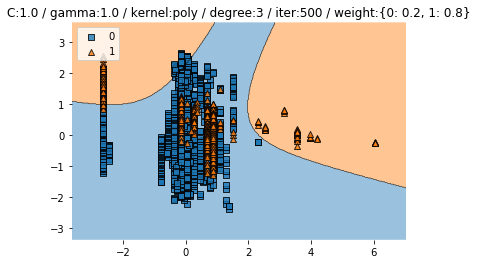

Test CV accuracy scores: [0.21812081 0.21052632 0.21724524 0.22284434 0.26091825]
Test CV accuracy: 0.226 +/- 0.018
Test CV f1 scores: [0.13013811 0.08679728 0.0869597  0.11110201 0.17273236]
Test CV f1: 0.118 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5249077490774908
Test f1 :  0.5661331086773378


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


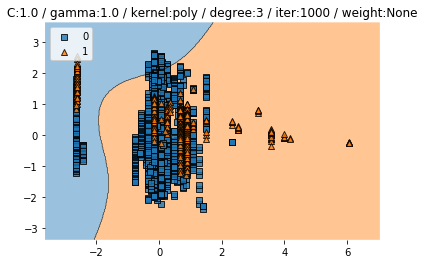

Test CV accuracy scores: [0.46868009 0.40761478 0.52071669 0.268757   0.30907055]
Test CV accuracy: 0.395 +/- 0.095
Test CV f1 scores: [0.48559975 0.40528361 0.54384045 0.19146328 0.25748705]
Test CV f1: 0.377 +/- 0.134


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7481549815498155
Test f1 :  0.6374501992031872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


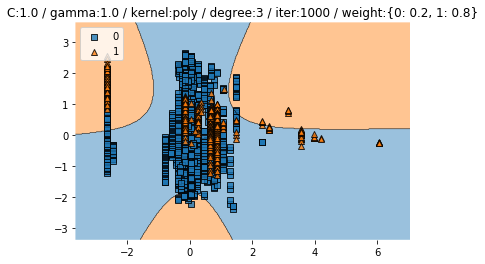

Test CV accuracy scores: [0.24944072 0.31354983 0.62262038 0.60806271 0.30907055]
Test CV accuracy: 0.421 +/- 0.161
Test CV f1 scores: [0.17117373 0.27090914 0.65254245 0.63804187 0.25621457]
Test CV f1: 0.398 +/- 0.205


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41789667896678967
Test f1 :  0.5157329240214888


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


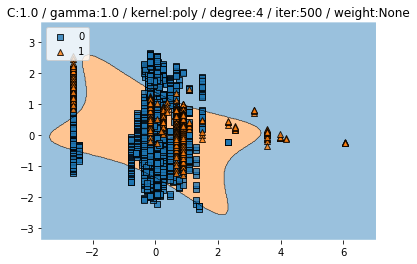

Test CV accuracy scores: [0.3098434  0.20268757 0.90929451 0.20716685 0.4031355 ]
Test CV accuracy: 0.406 +/- 0.262
Test CV f1 scores: [0.26040115 0.08804702 0.9097283  0.07811891 0.39838337]
Test CV f1: 0.347 +/- 0.305


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3284132841328413
Test f1 :  0.4785100286532951


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


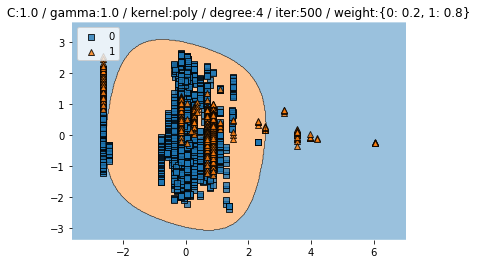

Test CV accuracy scores: [0.21812081 0.21052632 0.21724524 0.22284434 0.26091825]
Test CV accuracy: 0.226 +/- 0.018
Test CV f1 scores: [0.13013811 0.08679728 0.0869597  0.11110201 0.17273236]
Test CV f1: 0.118 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5249077490774908
Test f1 :  0.5661331086773378


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


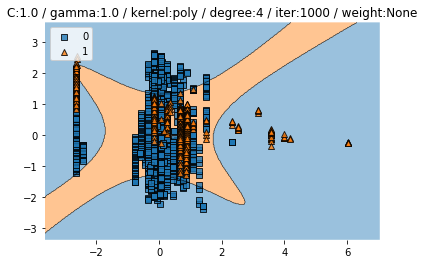

Test CV accuracy scores: [0.46868009 0.40761478 0.52071669 0.268757   0.30907055]
Test CV accuracy: 0.395 +/- 0.095
Test CV f1 scores: [0.48559975 0.40528361 0.54384045 0.19146328 0.25748705]
Test CV f1: 0.377 +/- 0.134


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7481549815498155
Test f1 :  0.6374501992031872


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


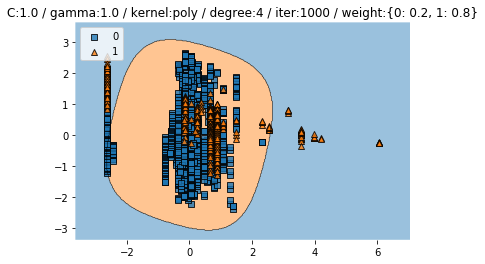

Test CV accuracy scores: [0.24944072 0.31354983 0.62262038 0.60806271 0.30907055]
Test CV accuracy: 0.421 +/- 0.161
Test CV f1 scores: [0.17117373 0.27090914 0.65254245 0.63804187 0.25621457]
Test CV f1: 0.398 +/- 0.205


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.41789667896678967
Test f1 :  0.5157329240214888


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


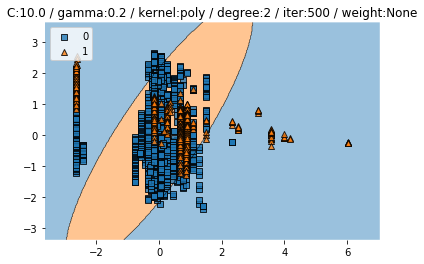

Test CV accuracy scores: [0.24608501 0.27883539 0.23740202 0.20380739 0.54983203]
Test CV accuracy: 0.303 +/- 0.126
Test CV f1 scores: [0.15241549 0.21199958 0.12687102 0.07128519 0.57671253]
Test CV f1: 0.228 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3219557195571956
Test f1 :  0.47761194029850745


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


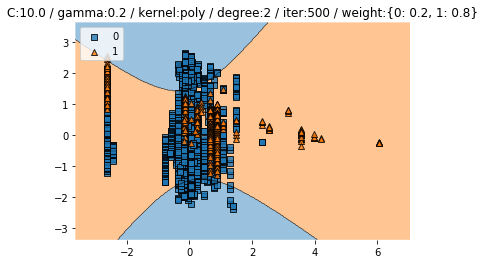

Test CV accuracy scores: [0.34228188 0.21388578 0.33034714 0.26763718 0.89137738]
Test CV accuracy: 0.409 +/- 0.246
Test CV f1 scores: [0.31157723 0.09162388 0.2893342  0.18491055 0.89840826]
Test CV f1: 0.355 +/- 0.283


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40313653136531363
Test f1 :  0.5094768764215316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


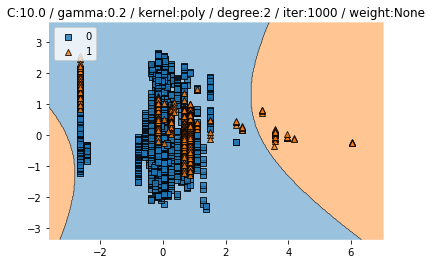

Test CV accuracy scores: [0.3590604  0.40985442 0.9462486  0.59014558 0.55767077]
Test CV accuracy: 0.573 +/- 0.206
Test CV f1 scores: [0.33679179 0.40985442 0.94635262 0.61963451 0.58490921]
Test CV f1: 0.580 +/- 0.212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3865313653136531
Test f1 :  0.5033607169529499


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


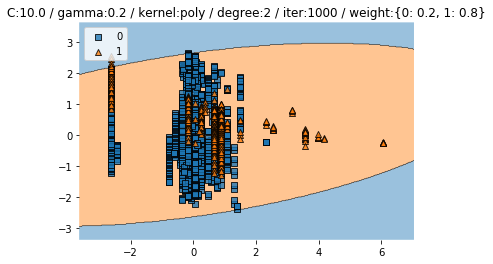

Test CV accuracy scores: [0.8557047  0.52631579 0.45128779 0.3225084  0.35386338]
Test CV accuracy: 0.502 +/- 0.191
Test CV f1 scores: [0.86661578 0.55218005 0.46039948 0.27803878 0.32672692]
Test CV f1: 0.497 +/- 0.209


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.518450184501845
Test f1 :  0.5650000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


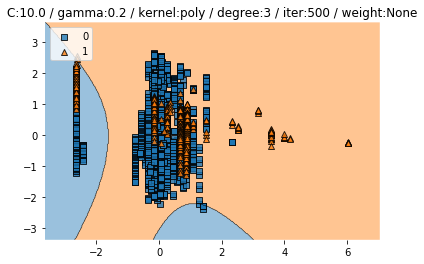

Test CV accuracy scores: [0.24608501 0.27883539 0.23740202 0.20380739 0.54983203]
Test CV accuracy: 0.303 +/- 0.126
Test CV f1 scores: [0.15241549 0.21199958 0.12687102 0.07128519 0.57671253]
Test CV f1: 0.228 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3219557195571956
Test f1 :  0.47761194029850745


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


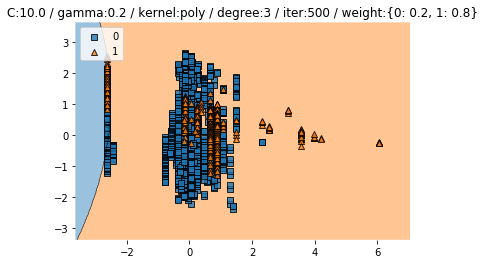

Test CV accuracy scores: [0.34228188 0.21388578 0.33034714 0.26763718 0.89137738]
Test CV accuracy: 0.409 +/- 0.246
Test CV f1 scores: [0.31157723 0.09162388 0.2893342  0.18491055 0.89840826]
Test CV f1: 0.355 +/- 0.283


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40313653136531363
Test f1 :  0.5094768764215316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


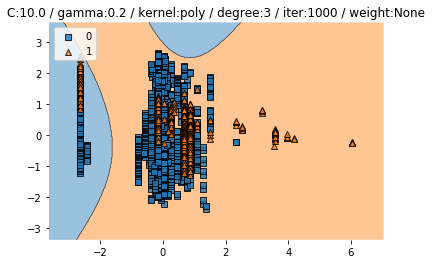

Test CV accuracy scores: [0.3590604  0.40985442 0.9462486  0.59014558 0.55767077]
Test CV accuracy: 0.573 +/- 0.206
Test CV f1 scores: [0.33679179 0.40985442 0.94635262 0.61963451 0.58490921]
Test CV f1: 0.580 +/- 0.212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3865313653136531
Test f1 :  0.5033607169529499


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


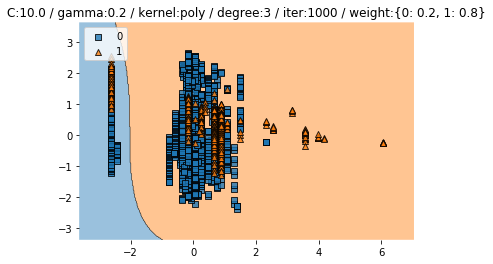

Test CV accuracy scores: [0.8557047  0.52631579 0.45128779 0.3225084  0.35386338]
Test CV accuracy: 0.502 +/- 0.191
Test CV f1 scores: [0.86661578 0.55218005 0.46039948 0.27803878 0.32672692]
Test CV f1: 0.497 +/- 0.209


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.518450184501845
Test f1 :  0.5650000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


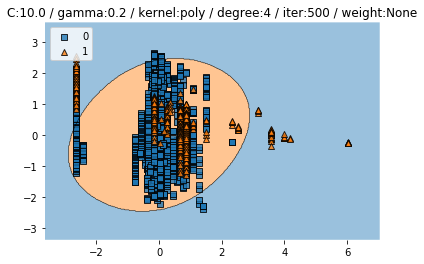

Test CV accuracy scores: [0.24608501 0.27883539 0.23740202 0.20380739 0.54983203]
Test CV accuracy: 0.303 +/- 0.126
Test CV f1 scores: [0.15241549 0.21199958 0.12687102 0.07128519 0.57671253]
Test CV f1: 0.228 +/- 0.180


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3219557195571956
Test f1 :  0.47761194029850745


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


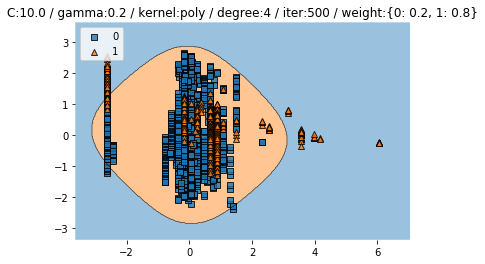

Test CV accuracy scores: [0.34228188 0.21388578 0.33034714 0.26763718 0.89137738]
Test CV accuracy: 0.409 +/- 0.246
Test CV f1 scores: [0.31157723 0.09162388 0.2893342  0.18491055 0.89840826]
Test CV f1: 0.355 +/- 0.283


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.40313653136531363
Test f1 :  0.5094768764215316


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


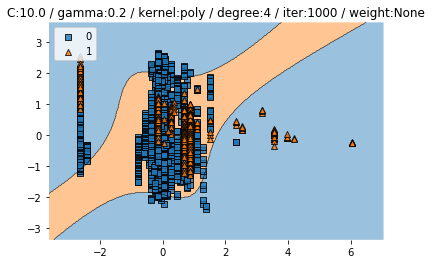

Test CV accuracy scores: [0.3590604  0.40985442 0.9462486  0.59014558 0.55767077]
Test CV accuracy: 0.573 +/- 0.206
Test CV f1 scores: [0.33679179 0.40985442 0.94635262 0.61963451 0.58490921]
Test CV f1: 0.580 +/- 0.212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3865313653136531
Test f1 :  0.5033607169529499


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


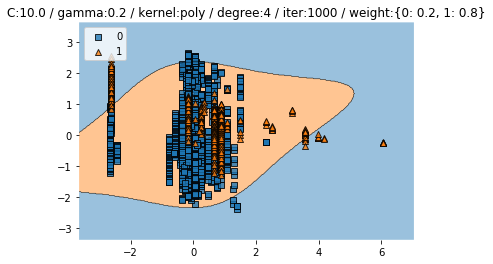

Test CV accuracy scores: [0.8557047  0.52631579 0.45128779 0.3225084  0.35386338]
Test CV accuracy: 0.502 +/- 0.191
Test CV f1 scores: [0.86661578 0.55218005 0.46039948 0.27803878 0.32672692]
Test CV f1: 0.497 +/- 0.209


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.518450184501845
Test f1 :  0.5650000000000001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


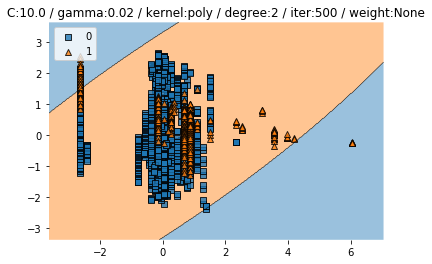

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


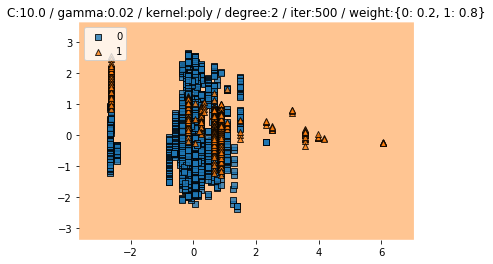

Test CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Test CV accuracy: 0.209 +/- 0.001
Test CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


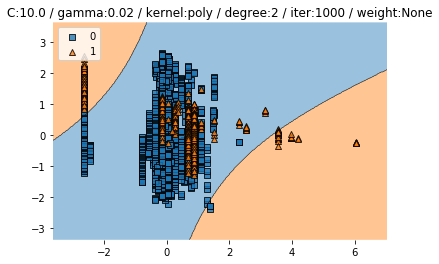

Test CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Test CV accuracy: 0.823 +/- 0.011
Test CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Test CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7435424354243543
Test f1 :  0.35046728971962615


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


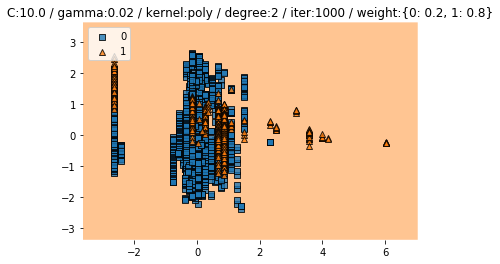

Test CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Test CV accuracy: 0.208 +/- 0.001
Test CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Test CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


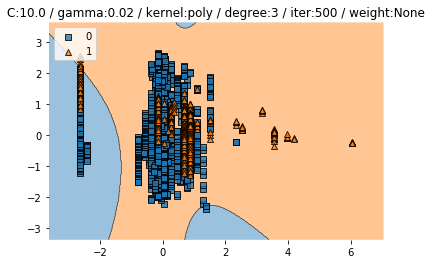

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


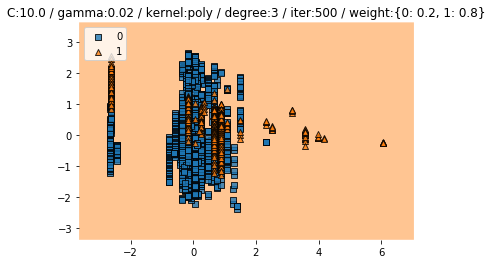

Test CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Test CV accuracy: 0.209 +/- 0.001
Test CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


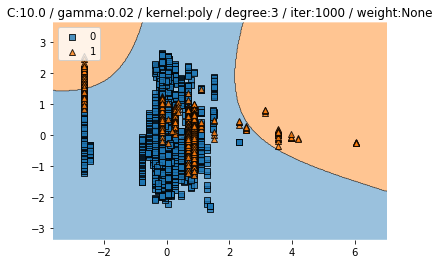

Test CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Test CV accuracy: 0.823 +/- 0.011
Test CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Test CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7435424354243543
Test f1 :  0.35046728971962615


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


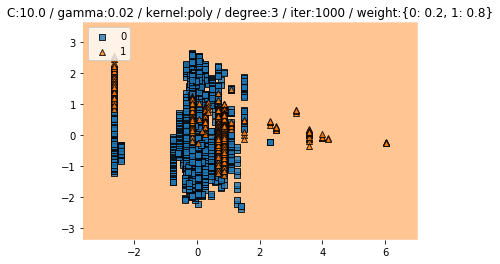

Test CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Test CV accuracy: 0.208 +/- 0.001
Test CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Test CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


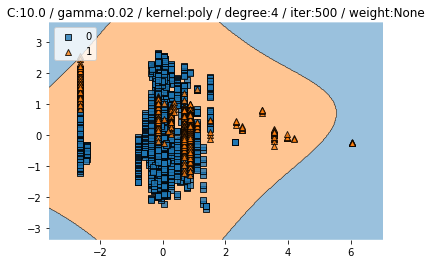

Test CV accuracy scores: [0.20693512 0.21052632 0.21052632 0.21052632 0.21052632]
Test CV accuracy: 0.210 +/- 0.001
Test CV f1 scores: [0.07249442 0.07322654 0.07322654 0.07322654 0.07322654]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31365313653136534
Test f1 :  0.4775280898876405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


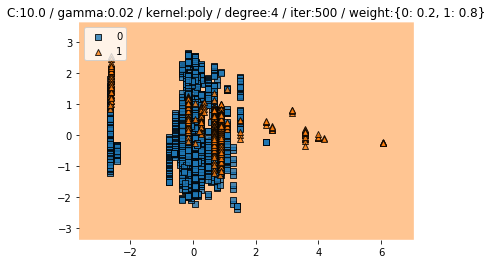

Test CV accuracy scores: [0.20693512 0.20716685 0.21052632 0.20940649 0.20940649]
Test CV accuracy: 0.209 +/- 0.001
Test CV f1 scores: [0.07249442 0.07225857 0.07322654 0.07290448 0.07290448]
Test CV f1: 0.073 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


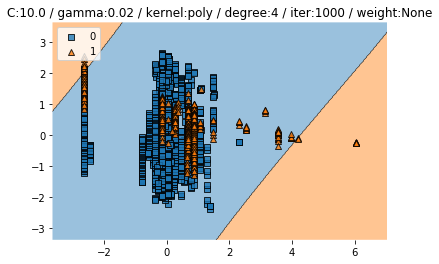

Test CV accuracy scores: [0.84116331 0.8174692  0.82306831 0.82418813 0.80739082]
Test CV accuracy: 0.823 +/- 0.011
Test CV f1 scores: [0.80064407 0.76628633 0.77635608 0.77124098 0.74729624]
Test CV f1: 0.772 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7435424354243543
Test f1 :  0.35046728971962615


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


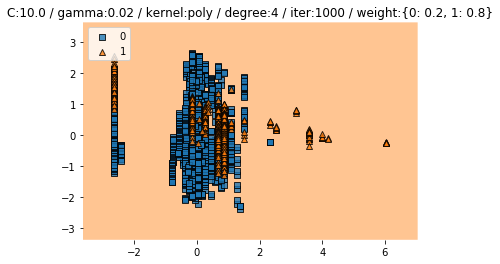

Test CV accuracy scores: [0.20693512 0.20828667 0.21052632 0.20716685 0.20940649]
Test CV accuracy: 0.208 +/- 0.001
Test CV f1 scores: [0.07249442 0.07455267 0.07322654 0.07225857 0.07290448]
Test CV f1: 0.073 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3118081180811808
Test f1 :  0.47538677918424754


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


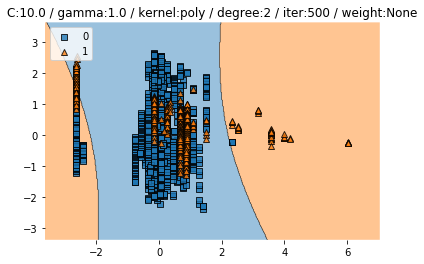

Test CV accuracy scores: [0.35011186 0.79507279 0.2743561  0.27771557 0.84546473]
Test CV accuracy: 0.509 +/- 0.256
Test CV f1 scores: [0.34274136 0.7429095  0.20567843 0.20284343 0.81369003]
Test CV f1: 0.462 +/- 0.264


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.4818049490538573


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


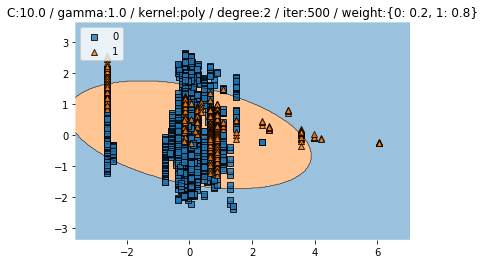

Test CV accuracy scores: [0.401566   0.39753639 0.31802912 0.20604703 0.21948488]
Test CV accuracy: 0.309 +/- 0.084
Test CV f1 scores: [0.40863971 0.39232997 0.26960048 0.07778324 0.09339199]
Test CV f1: 0.248 +/- 0.141


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5212177121771218
Test f1 :  0.5475152571926766


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


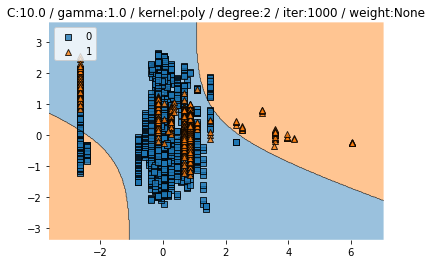

Test CV accuracy scores: [0.22595078 0.57446809 0.62486002 0.22732363 0.26427772]
Test CV accuracy: 0.383 +/- 0.178
Test CV f1 scores: [0.14444569 0.60583707 0.65411323 0.12152256 0.17884412]
Test CV f1: 0.341 +/- 0.237


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6964944649446494
Test f1 :  0.10354223433242507


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


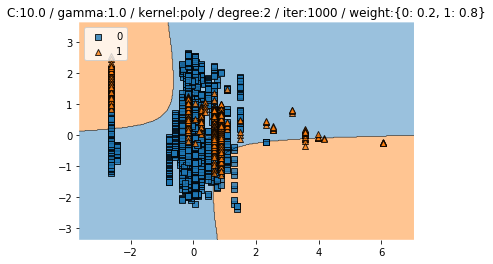

Test CV accuracy scores: [0.33668904 0.20156775 0.81634938 0.29227324 0.68645017]
Test CV accuracy: 0.467 +/- 0.240
Test CV f1 scores: [0.31669372 0.07063325 0.82674838 0.2387851  0.71484439]
Test CV f1: 0.434 +/- 0.289


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3459409594095941
Test f1 :  0.48511256354393606


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


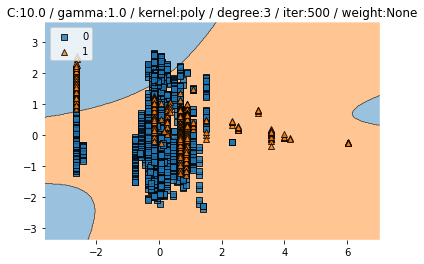

Test CV accuracy scores: [0.35011186 0.79507279 0.2743561  0.27771557 0.84546473]
Test CV accuracy: 0.509 +/- 0.256
Test CV f1 scores: [0.34274136 0.7429095  0.20567843 0.20284343 0.81369003]
Test CV f1: 0.462 +/- 0.264


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.4818049490538573


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


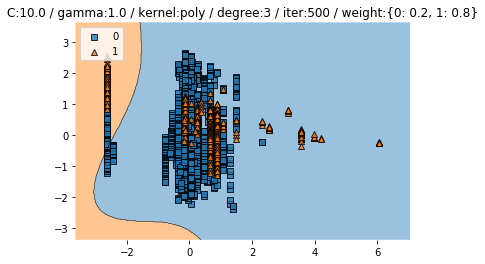

Test CV accuracy scores: [0.401566   0.39753639 0.31802912 0.20604703 0.21948488]
Test CV accuracy: 0.309 +/- 0.084
Test CV f1 scores: [0.40863971 0.39232997 0.26960048 0.07778324 0.09339199]
Test CV f1: 0.248 +/- 0.141


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5212177121771218
Test f1 :  0.5475152571926766


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


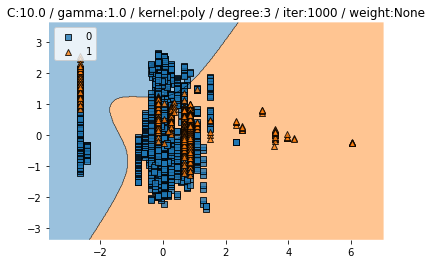

Test CV accuracy scores: [0.22595078 0.57446809 0.62486002 0.22732363 0.26427772]
Test CV accuracy: 0.383 +/- 0.178
Test CV f1 scores: [0.14444569 0.60583707 0.65411323 0.12152256 0.17884412]
Test CV f1: 0.341 +/- 0.237


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6964944649446494
Test f1 :  0.10354223433242507


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


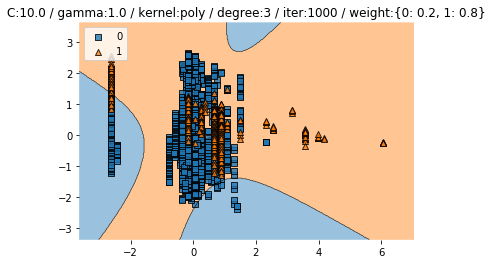

Test CV accuracy scores: [0.33668904 0.20156775 0.81634938 0.29227324 0.68645017]
Test CV accuracy: 0.467 +/- 0.240
Test CV f1 scores: [0.31669372 0.07063325 0.82674838 0.2387851  0.71484439]
Test CV f1: 0.434 +/- 0.289


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3459409594095941
Test f1 :  0.48511256354393606


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


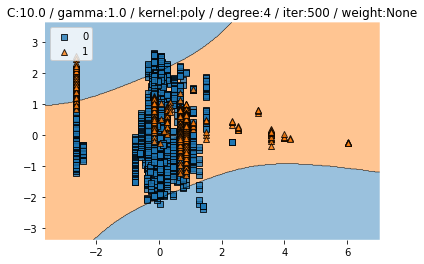

Test CV accuracy scores: [0.35011186 0.79507279 0.2743561  0.27771557 0.84546473]
Test CV accuracy: 0.509 +/- 0.256
Test CV f1 scores: [0.34274136 0.7429095  0.20567843 0.20284343 0.81369003]
Test CV f1: 0.462 +/- 0.264


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.34317343173431736
Test f1 :  0.4818049490538573


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


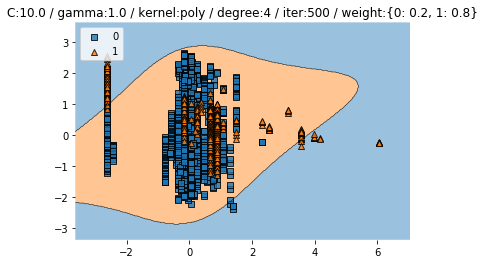

Test CV accuracy scores: [0.401566   0.39753639 0.31802912 0.20604703 0.21948488]
Test CV accuracy: 0.309 +/- 0.084
Test CV f1 scores: [0.40863971 0.39232997 0.26960048 0.07778324 0.09339199]
Test CV f1: 0.248 +/- 0.141


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5212177121771218
Test f1 :  0.5475152571926766


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


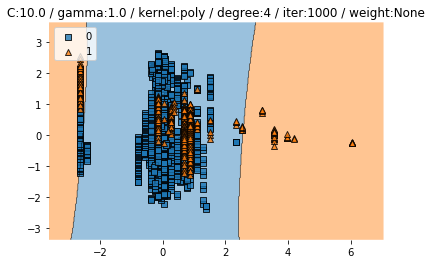

Test CV accuracy scores: [0.22595078 0.57446809 0.62486002 0.22732363 0.26427772]
Test CV accuracy: 0.383 +/- 0.178
Test CV f1 scores: [0.14444569 0.60583707 0.65411323 0.12152256 0.17884412]
Test CV f1: 0.341 +/- 0.237


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6964944649446494
Test f1 :  0.10354223433242507


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


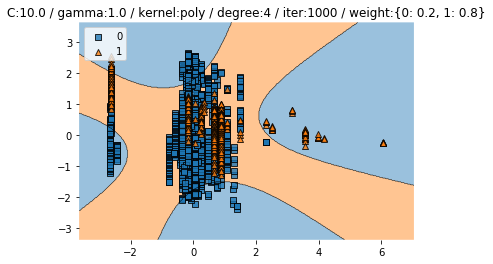

Test CV accuracy scores: [0.33668904 0.20156775 0.81634938 0.29227324 0.68645017]
Test CV accuracy: 0.467 +/- 0.240
Test CV f1 scores: [0.31669372 0.07063325 0.82674838 0.2387851  0.71484439]
Test CV f1: 0.434 +/- 0.289


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3459409594095941
Test f1 :  0.48511256354393606


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


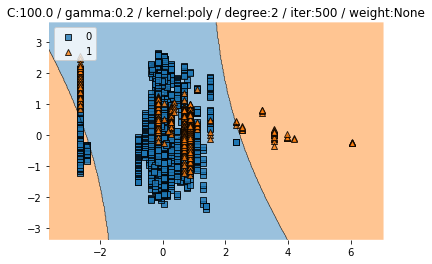

Test CV accuracy scores: [0.31991051 0.33146697 0.33930571 0.25419933 0.85106383]
Test CV accuracy: 0.419 +/- 0.218
Test CV f1 scores: [0.27664193 0.29792332 0.30995717 0.16521175 0.82869141]
Test CV f1: 0.376 +/- 0.232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8468634686346863
Test f1 :  0.7688022284122563


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


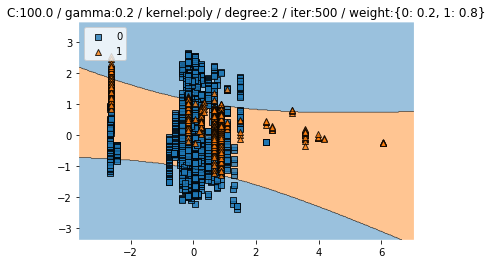

Test CV accuracy scores: [0.84228188 0.21052632 0.34378499 0.20156775 0.25083987]
Test CV accuracy: 0.370 +/- 0.242
Test CV f1 scores: [0.81297351 0.08679728 0.31140457 0.07063325 0.15411934]
Test CV f1: 0.287 +/- 0.276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.47424135497529996


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


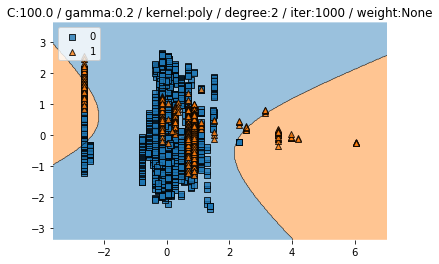

Test CV accuracy scores: [0.38926174 0.28443449 0.36618141 0.55879059 0.20380739]
Test CV accuracy: 0.360 +/- 0.119
Test CV f1 scores: [0.38106593 0.24613203 0.34407165 0.58828841 0.07128519]
Test CV f1: 0.326 +/- 0.169


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4474169741697417
Test f1 :  0.5242255758538522


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


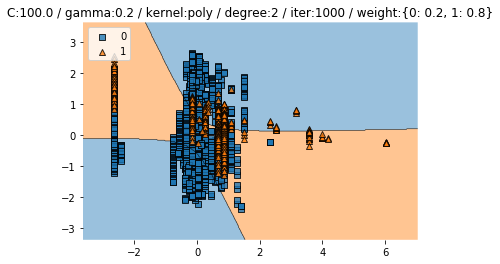

Test CV accuracy scores: [0.75391499 0.28555431 0.2743561  0.24636058 0.20940649]
Test CV accuracy: 0.354 +/- 0.202
Test CV f1 scores: [0.77639877 0.2248646  0.19839624 0.15562929 0.07290448]
Test CV f1: 0.286 +/- 0.251


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39114391143911437
Test f1 :  0.5030120481927711


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


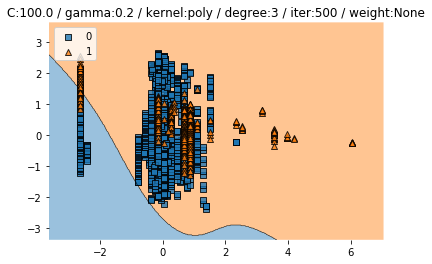

Test CV accuracy scores: [0.31991051 0.33146697 0.33930571 0.25419933 0.85106383]
Test CV accuracy: 0.419 +/- 0.218
Test CV f1 scores: [0.27664193 0.29792332 0.30995717 0.16521175 0.82869141]
Test CV f1: 0.376 +/- 0.232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8468634686346863
Test f1 :  0.7688022284122563


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


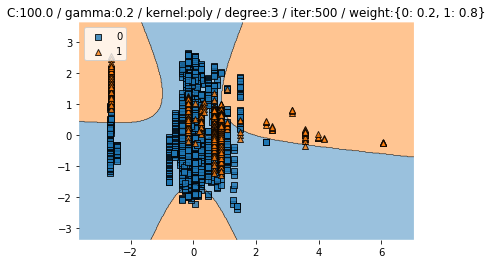

Test CV accuracy scores: [0.84228188 0.21052632 0.34378499 0.20156775 0.25083987]
Test CV accuracy: 0.370 +/- 0.242
Test CV f1 scores: [0.81297351 0.08679728 0.31140457 0.07063325 0.15411934]
Test CV f1: 0.287 +/- 0.276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.47424135497529996


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


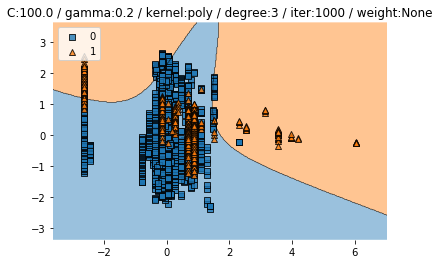

Test CV accuracy scores: [0.38926174 0.28443449 0.36618141 0.55879059 0.20380739]
Test CV accuracy: 0.360 +/- 0.119
Test CV f1 scores: [0.38106593 0.24613203 0.34407165 0.58828841 0.07128519]
Test CV f1: 0.326 +/- 0.169


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4474169741697417
Test f1 :  0.5242255758538522


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


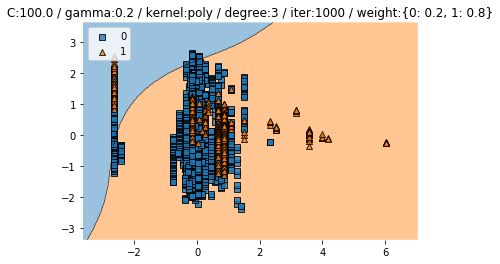

Test CV accuracy scores: [0.75391499 0.28555431 0.2743561  0.24636058 0.20940649]
Test CV accuracy: 0.354 +/- 0.202
Test CV f1 scores: [0.77639877 0.2248646  0.19839624 0.15562929 0.07290448]
Test CV f1: 0.286 +/- 0.251


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39114391143911437
Test f1 :  0.5030120481927711


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


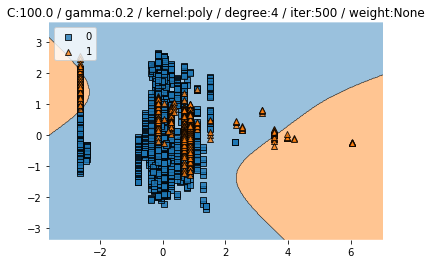

Test CV accuracy scores: [0.31991051 0.33146697 0.33930571 0.25419933 0.85106383]
Test CV accuracy: 0.419 +/- 0.218
Test CV f1 scores: [0.27664193 0.29792332 0.30995717 0.16521175 0.82869141]
Test CV f1: 0.376 +/- 0.232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8468634686346863
Test f1 :  0.7688022284122563


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


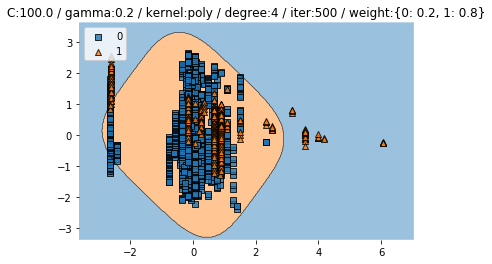

Test CV accuracy scores: [0.84228188 0.21052632 0.34378499 0.20156775 0.25083987]
Test CV accuracy: 0.370 +/- 0.242
Test CV f1 scores: [0.81297351 0.08679728 0.31140457 0.07063325 0.15411934]
Test CV f1: 0.287 +/- 0.276


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.47424135497529996


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


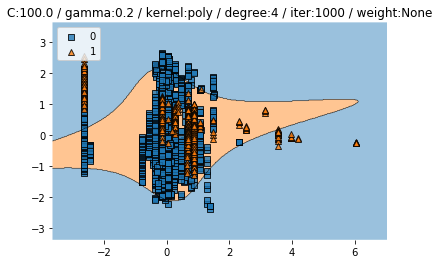

Test CV accuracy scores: [0.38926174 0.28443449 0.36618141 0.55879059 0.20380739]
Test CV accuracy: 0.360 +/- 0.119
Test CV f1 scores: [0.38106593 0.24613203 0.34407165 0.58828841 0.07128519]
Test CV f1: 0.326 +/- 0.169


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4474169741697417
Test f1 :  0.5242255758538522


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


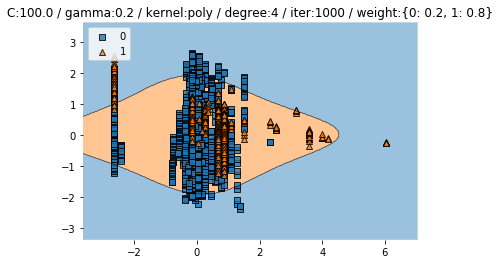

Test CV accuracy scores: [0.75391499 0.28555431 0.2743561  0.24636058 0.20940649]
Test CV accuracy: 0.354 +/- 0.202
Test CV f1 scores: [0.77639877 0.2248646  0.19839624 0.15562929 0.07290448]
Test CV f1: 0.286 +/- 0.251


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.39114391143911437
Test f1 :  0.5030120481927711


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


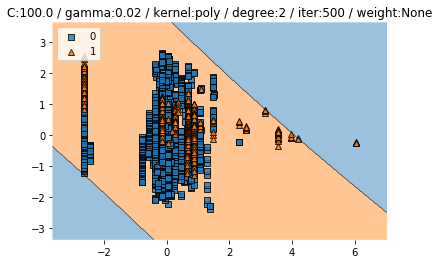

Test CV accuracy scores: [0.2147651  0.33482643 0.21164614 0.20940649 0.74356103]
Test CV accuracy: 0.343 +/- 0.206
Test CV f1 scores: [0.08838716 0.29978177 0.07553082 0.07290448 0.76723149]
Test CV f1: 0.261 +/- 0.267


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


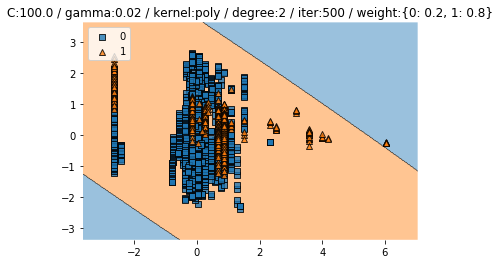

Test CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Test CV accuracy: 0.211 +/- 0.006
Test CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Test CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


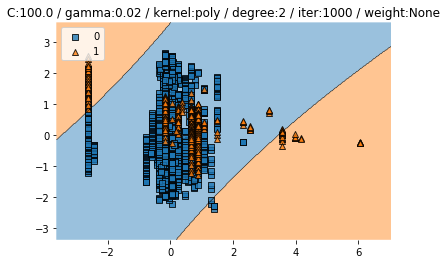

Test CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.88913774]
Test CV accuracy: 0.908 +/- 0.025
Test CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.88421479]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8477859778597786
Test f1 :  0.6927374301675977


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


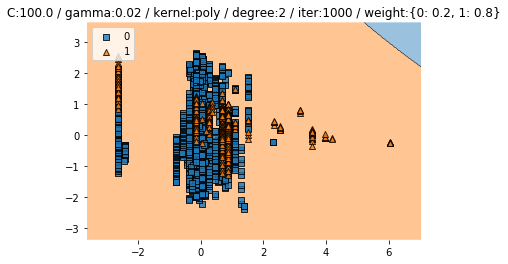

Test CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Test CV accuracy: 0.418 +/- 0.098
Test CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Test CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


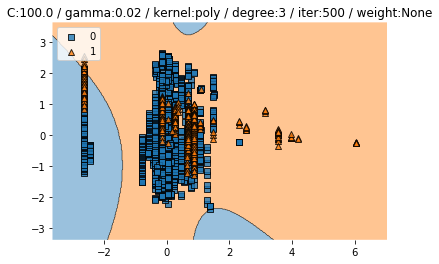

Test CV accuracy scores: [0.2147651  0.33482643 0.21164614 0.20940649 0.74356103]
Test CV accuracy: 0.343 +/- 0.206
Test CV f1 scores: [0.08838716 0.29978177 0.07553082 0.07290448 0.76723149]
Test CV f1: 0.261 +/- 0.267


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


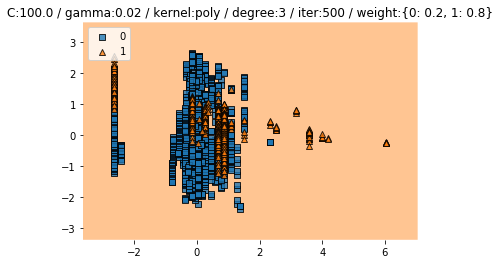

Test CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Test CV accuracy: 0.211 +/- 0.006
Test CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Test CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


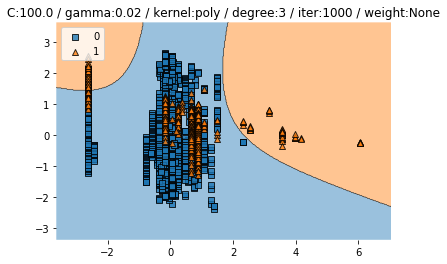

Test CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.88913774]
Test CV accuracy: 0.908 +/- 0.025
Test CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.88421479]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8477859778597786
Test f1 :  0.6927374301675977


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


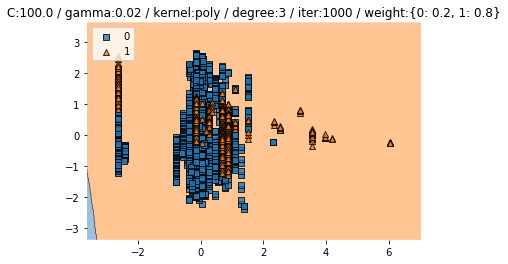

Test CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Test CV accuracy: 0.418 +/- 0.098
Test CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Test CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


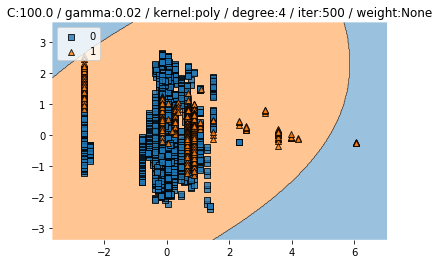

Test CV accuracy scores: [0.2147651  0.33482643 0.21164614 0.20940649 0.74356103]
Test CV accuracy: 0.343 +/- 0.206
Test CV f1 scores: [0.08838716 0.29978177 0.07553082 0.07290448 0.76723149]
Test CV f1: 0.261 +/- 0.267


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.31273062730627305
Test f1 :  0.4764581869290232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


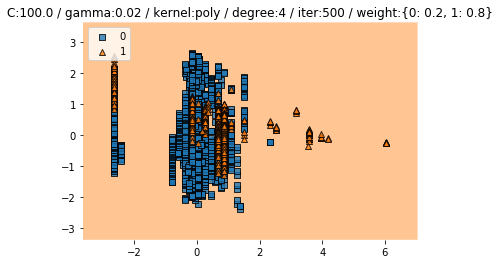

Test CV accuracy scores: [0.20917226 0.21388578 0.20828667 0.20268757 0.2206047 ]
Test CV accuracy: 0.211 +/- 0.006
Test CV f1 scores: [0.08475192 0.09162388 0.07258183 0.07095952 0.09563817]
Test CV f1: 0.083 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.30996309963099633
Test f1 :  0.47323943661971835


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


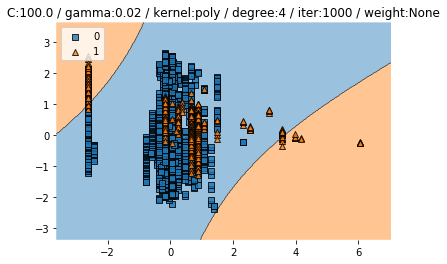

Test CV accuracy scores: [0.92393736 0.87010078 0.93617021 0.92161254 0.88913774]
Test CV accuracy: 0.908 +/- 0.025
Test CV f1 scores: [0.91965759 0.85303904 0.93635479 0.91781769 0.88421479]
Test CV f1: 0.902 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8477859778597786
Test f1 :  0.6927374301675977


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


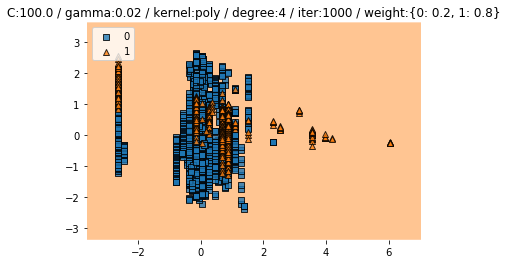

Test CV accuracy scores: [0.40268456 0.60470325 0.33146697 0.34378499 0.40761478]
Test CV accuracy: 0.418 +/- 0.098
Test CV f1 scores: [0.40572207 0.6369615  0.29680662 0.32590729 0.40606665]
Test CV f1: 0.414 +/- 0.119


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3671586715867159
Test f1 :  0.4918518518518519


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


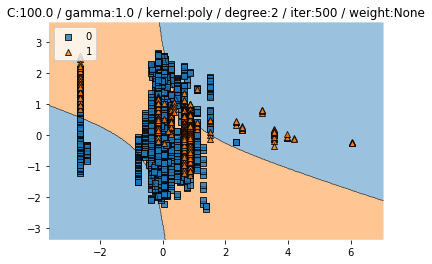

Test CV accuracy scores: [0.35011186 0.79507279 0.24300112 0.27995521 0.84546473]
Test CV accuracy: 0.503 +/- 0.262
Test CV f1 scores: [0.34274136 0.7429095  0.13934674 0.20966558 0.81369003]
Test CV f1: 0.450 +/- 0.277


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4769372693726937
Test f1 :  0.5317919075144508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


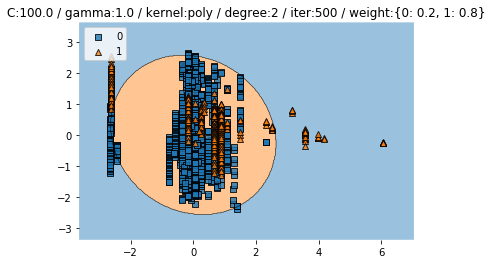

Test CV accuracy scores: [0.35011186 0.79507279 0.22284434 0.23068309 0.84546473]
Test CV accuracy: 0.489 +/- 0.275
Test CV f1 scores: [0.34274136 0.7429095  0.10011273 0.1262106  0.81369003]
Test CV f1: 0.425 +/- 0.301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6042435424354243
Test f1 :  0.6096451319381255


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


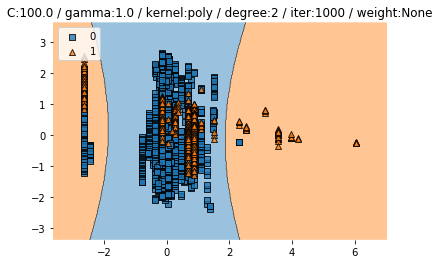

Test CV accuracy scores: [0.25391499 0.57446809 0.81075028 0.20604703 0.28219485]
Test CV accuracy: 0.425 +/- 0.232
Test CV f1 scores: [0.17762706 0.60583707 0.82604319 0.09097144 0.21068813]
Test CV f1: 0.382 +/- 0.284


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


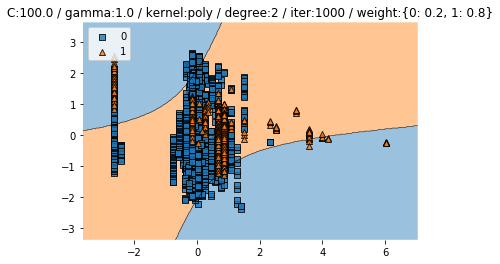

Test CV accuracy scores: [0.25391499 0.57446809 0.28331467 0.20492721 0.28219485]
Test CV accuracy: 0.320 +/- 0.130
Test CV f1 scores: [0.17762706 0.60583707 0.21119908 0.08127201 0.21068813]
Test CV f1: 0.257 +/- 0.181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7795202952029521
Test f1 :  0.6900129701686123


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


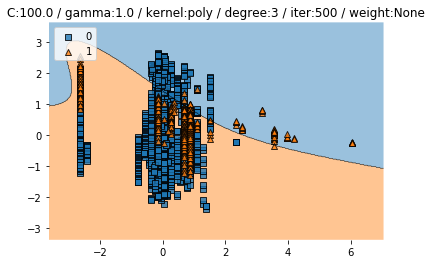

Test CV accuracy scores: [0.35011186 0.79507279 0.24300112 0.27995521 0.84546473]
Test CV accuracy: 0.503 +/- 0.262
Test CV f1 scores: [0.34274136 0.7429095  0.13934674 0.20966558 0.81369003]
Test CV f1: 0.450 +/- 0.277


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4769372693726937
Test f1 :  0.5317919075144508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


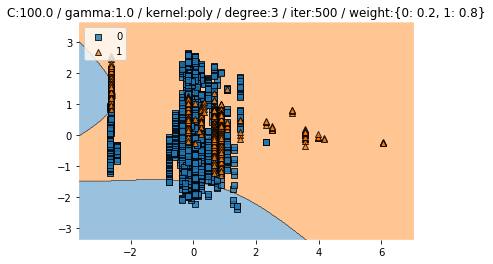

Test CV accuracy scores: [0.35011186 0.79507279 0.22284434 0.23068309 0.84546473]
Test CV accuracy: 0.489 +/- 0.275
Test CV f1 scores: [0.34274136 0.7429095  0.10011273 0.1262106  0.81369003]
Test CV f1: 0.425 +/- 0.301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6042435424354243
Test f1 :  0.6096451319381255


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


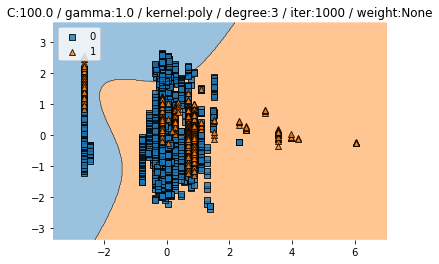

Test CV accuracy scores: [0.25391499 0.57446809 0.81075028 0.20604703 0.28219485]
Test CV accuracy: 0.425 +/- 0.232
Test CV f1 scores: [0.17762706 0.60583707 0.82604319 0.09097144 0.21068813]
Test CV f1: 0.382 +/- 0.284


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


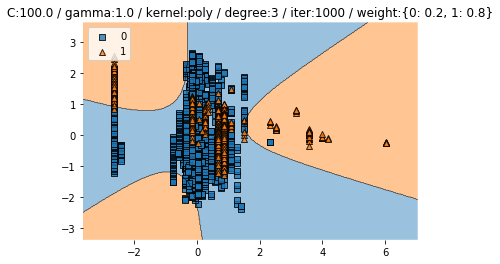

Test CV accuracy scores: [0.25391499 0.57446809 0.28331467 0.20492721 0.28219485]
Test CV accuracy: 0.320 +/- 0.130
Test CV f1 scores: [0.17762706 0.60583707 0.21119908 0.08127201 0.21068813]
Test CV f1: 0.257 +/- 0.181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7795202952029521
Test f1 :  0.6900129701686123


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


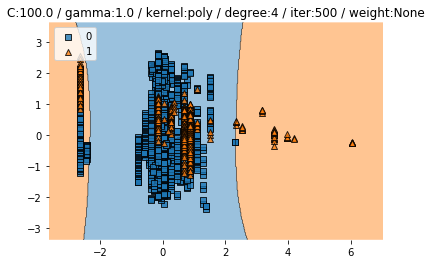

Test CV accuracy scores: [0.35011186 0.79507279 0.24300112 0.27995521 0.84546473]
Test CV accuracy: 0.503 +/- 0.262
Test CV f1 scores: [0.34274136 0.7429095  0.13934674 0.20966558 0.81369003]
Test CV f1: 0.450 +/- 0.277


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4769372693726937
Test f1 :  0.5317919075144508


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


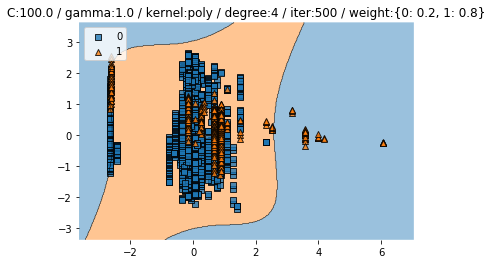

Test CV accuracy scores: [0.35011186 0.79507279 0.22284434 0.23068309 0.84546473]
Test CV accuracy: 0.489 +/- 0.275
Test CV f1 scores: [0.34274136 0.7429095  0.10011273 0.1262106  0.81369003]
Test CV f1: 0.425 +/- 0.301


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6042435424354243
Test f1 :  0.6096451319381255


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


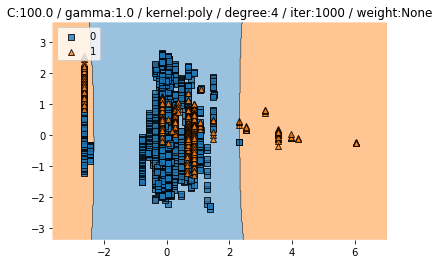

Test CV accuracy scores: [0.25391499 0.57446809 0.81075028 0.20604703 0.28219485]
Test CV accuracy: 0.425 +/- 0.232
Test CV f1 scores: [0.17762706 0.60583707 0.82604319 0.09097144 0.21068813]
Test CV f1: 0.382 +/- 0.284


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.37822878228782286
Test f1 :  0.5


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


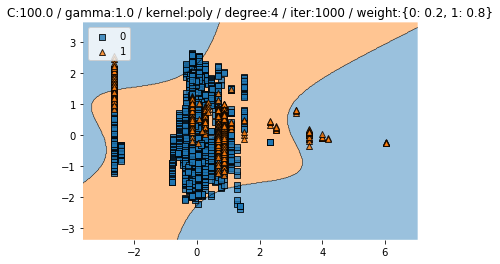

Test CV accuracy scores: [0.25391499 0.57446809 0.28331467 0.20492721 0.28219485]
Test CV accuracy: 0.320 +/- 0.130
Test CV f1 scores: [0.17762706 0.60583707 0.21119908 0.08127201 0.21068813]
Test CV f1: 0.257 +/- 0.181


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7795202952029521
Test f1 :  0.6900129701686123
1018.2835128307343 secs


In [14]:
# news poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
degree_range = [2, 3, 4]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "degree":degree, "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for degree in degree_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(1,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


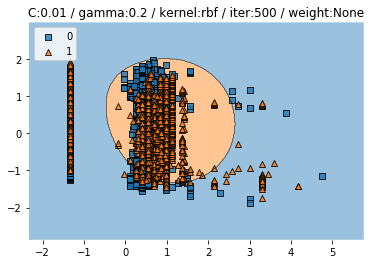

Test CV accuracy scores: [0.53312629 0.5320911  0.63316062 0.39107884 0.46473029]
Test CV accuracy: 0.511 +/- 0.080
Test CV f1 scores: [0.52947153 0.48304915 0.62720465 0.34990459 0.46761405]
Test CV f1: 0.491 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5411764705882353
Test f1 :  0.553921568627451


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


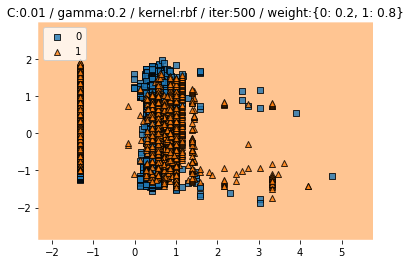

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


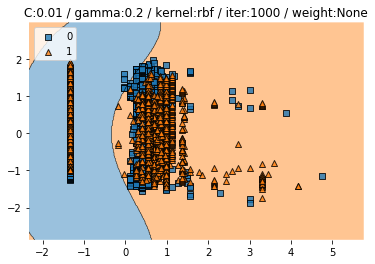

Test CV accuracy scores: [0.87060041 0.73188406 0.90569948 0.73340249 0.90767635]
Test CV accuracy: 0.830 +/- 0.080
Test CV f1 scores: [0.86738786 0.73344121 0.90610925 0.73470034 0.90763021]
Test CV f1: 0.830 +/- 0.080


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9092436974789916
Test f1 :  0.9078498293515358


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


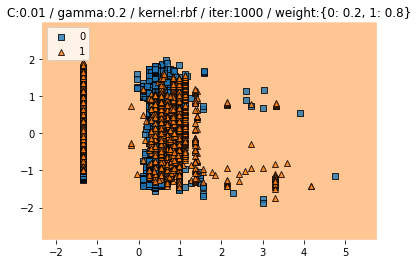

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


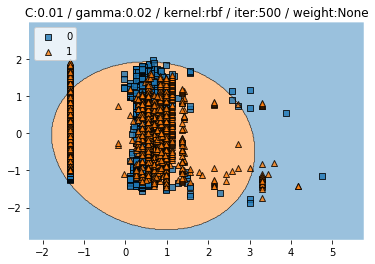

Test CV accuracy scores: [0.4689441  0.51242236 0.56787565 0.33921162 0.54149378]
Test CV accuracy: 0.486 +/- 0.080
Test CV f1 scores: [0.45148433 0.43223705 0.53232024 0.31212139 0.49935411]
Test CV f1: 0.446 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4722689075630252
Test f1 :  0.6357308584686775


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


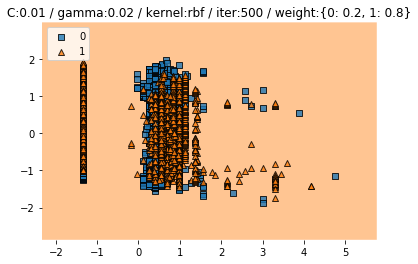

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


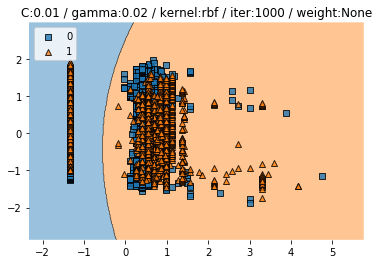

Test CV accuracy scores: [0.47412008 0.56418219 0.44248705 0.48340249 0.57261411]
Test CV accuracy: 0.507 +/- 0.052
Test CV f1 scores: [0.3557809  0.51681001 0.29610252 0.37558818 0.51853557]
Test CV f1: 0.413 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6630252100840336
Test f1 :  0.7232574189095928


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


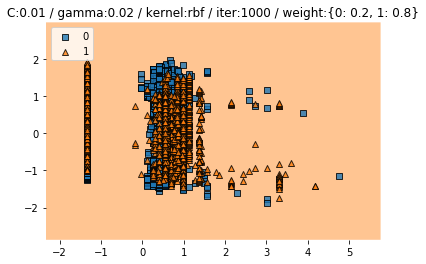

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


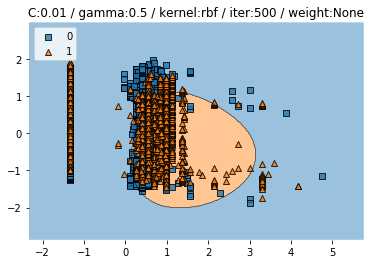

Test CV accuracy scores: [0.80331263 0.67287785 0.71917098 0.53630705 0.64834025]
Test CV accuracy: 0.676 +/- 0.088
Test CV f1 scores: [0.80409589 0.65546336 0.71742237 0.49335915 0.64964734]
Test CV f1: 0.664 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6512605042016807
Test f1 :  0.6677341873498799


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


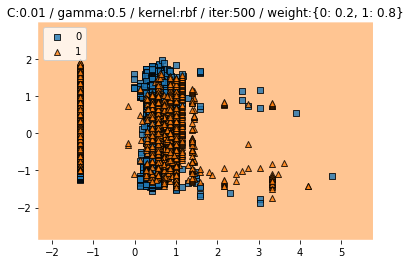

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


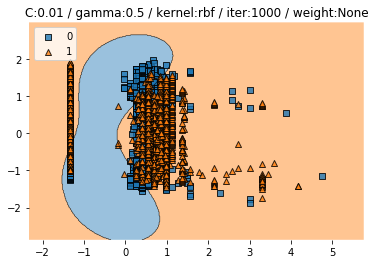

Test CV accuracy scores: [0.85196687 0.80848861 0.90880829 0.79460581 0.90145228]
Test CV accuracy: 0.853 +/- 0.047
Test CV f1 scores: [0.84691975 0.80958667 0.90830607 0.79540013 0.90009454]
Test CV f1: 0.852 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9411764705882353
Test f1 :  0.9360146252285192


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


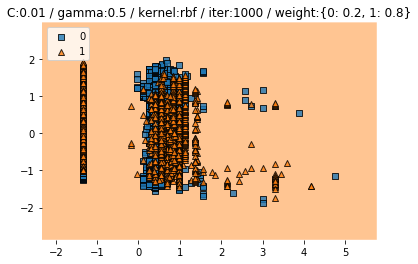

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


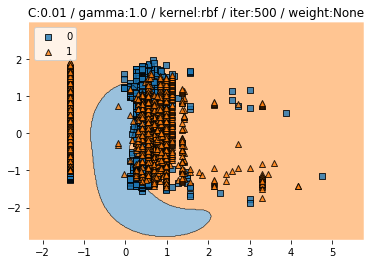

Test CV accuracy scores: [0.91511387 0.80331263 0.89119171 0.66182573 0.85165975]
Test CV accuracy: 0.825 +/- 0.090
Test CV f1 scores: [0.91457106 0.80235839 0.89166452 0.64811884 0.8524193 ]
Test CV f1: 0.822 +/- 0.095


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8277310924369747
Test f1 :  0.8358686949559647


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


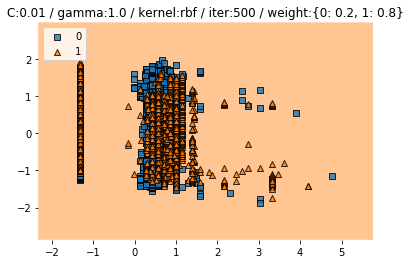

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


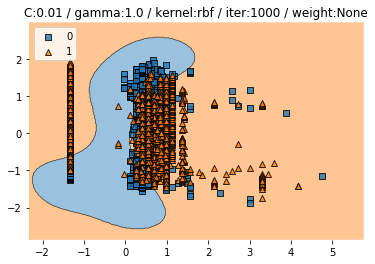

Test CV accuracy scores: [0.86438923 0.80538302 0.90673575 0.78838174 0.91390041]
Test CV accuracy: 0.856 +/- 0.051
Test CV f1 scores: [0.86047434 0.80650917 0.90626456 0.7895942  0.91306215]
Test CV f1: 0.855 +/- 0.050


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9420168067226891
Test f1 :  0.9362880886426594


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


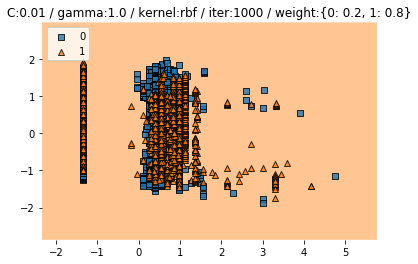

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


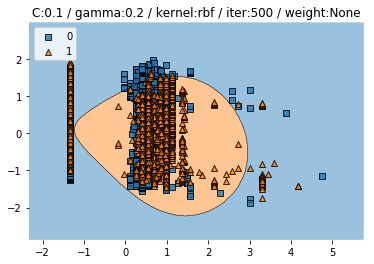

Test CV accuracy scores: [0.77329193 0.61801242 0.69740933 0.61721992 0.65352697]
Test CV accuracy: 0.672 +/- 0.059
Test CV f1 scores: [0.77204375 0.58749742 0.69736059 0.59572475 0.65374662]
Test CV f1: 0.661 +/- 0.068


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5378151260504201
Test f1 :  0.5542949756888168


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


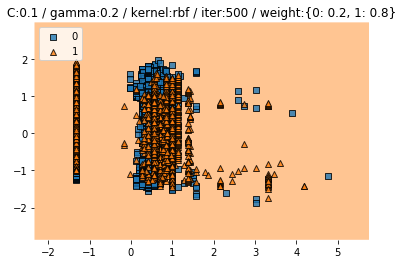

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


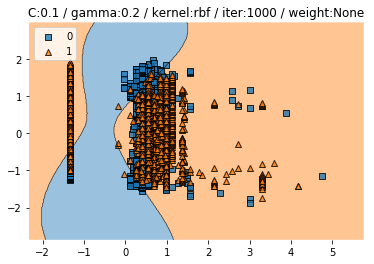

Test CV accuracy scores: [0.8447205  0.81055901 0.90466321 0.7873444  0.89315353]
Test CV accuracy: 0.848 +/- 0.045
Test CV f1 scores: [0.8387747  0.81143314 0.90380845 0.78796548 0.89119573]
Test CV f1: 0.847 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.915126050420168
Test f1 :  0.9026036644165863


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


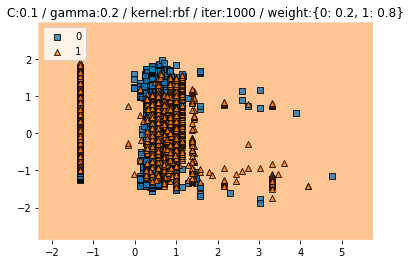

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


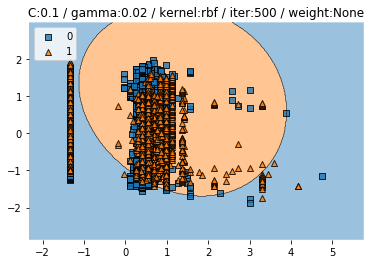

Test CV accuracy scores: [0.48136646 0.51345756 0.54818653 0.33921162 0.52178423]
Test CV accuracy: 0.481 +/- 0.074
Test CV f1 scores: [0.46207734 0.42888396 0.5050113  0.31212139 0.44663935]
Test CV f1: 0.431 +/- 0.065


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5394957983193277
Test f1 :  0.6600496277915633


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


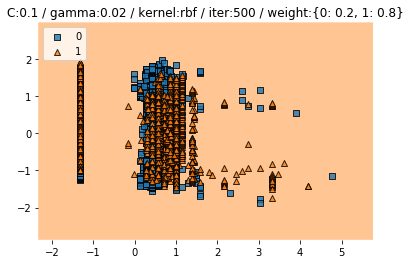

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


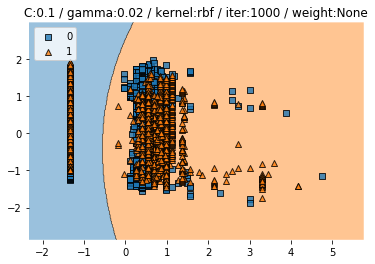

Test CV accuracy scores: [0.49585921 0.61697723 0.49222798 0.4253112  0.42323651]
Test CV accuracy: 0.491 +/- 0.070
Test CV f1 scores: [0.39532164 0.61452794 0.39051783 0.25622282 0.25172084]
Test CV f1: 0.382 +/- 0.132


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


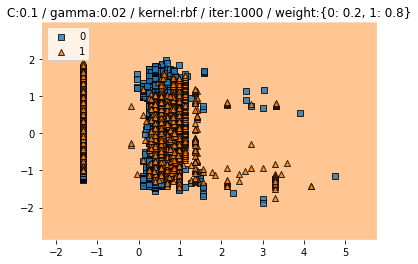

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


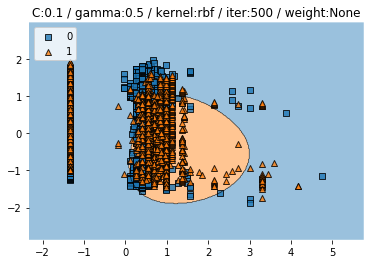

Test CV accuracy scores: [0.90993789 0.79296066 0.90984456 0.68568465 0.90975104]
Test CV accuracy: 0.842 +/- 0.090
Test CV f1 scores: [0.90934044 0.79168129 0.9100192  0.68019652 0.90976565]
Test CV f1: 0.840 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6369747899159663
Test f1 :  0.6717325227963526


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


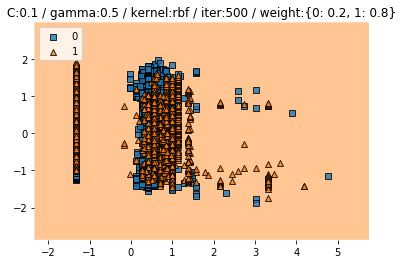

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


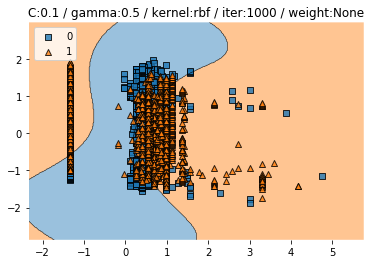

Test CV accuracy scores: [0.85093168 0.82815735 0.90673575 0.78112033 0.906639  ]
Test CV accuracy: 0.855 +/- 0.048
Test CV f1 scores: [0.84578152 0.82906908 0.90584982 0.78235303 0.90526579]
Test CV f1: 0.854 +/- 0.047


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.934453781512605
Test f1 :  0.9261363636363636


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


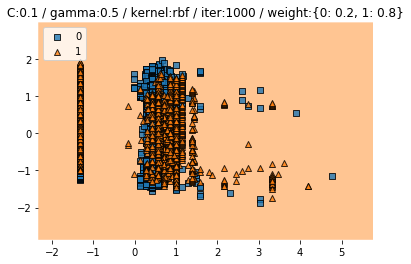

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


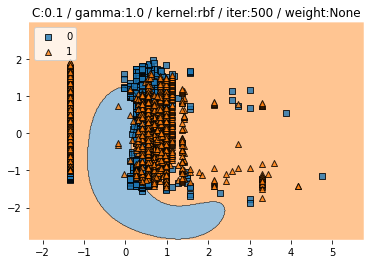

Test CV accuracy scores: [0.9068323  0.81573499 0.92331606 0.74792531 0.87863071]
Test CV accuracy: 0.854 +/- 0.065
Test CV f1 scores: [0.90563847 0.81573499 0.92323745 0.74852958 0.87922746]
Test CV f1: 0.854 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9512605042016806
Test f1 :  0.946886446886447


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


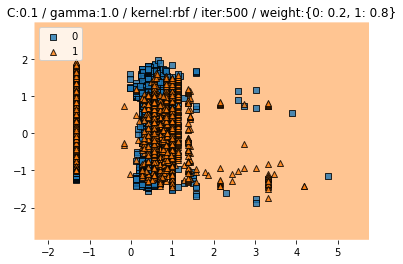

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


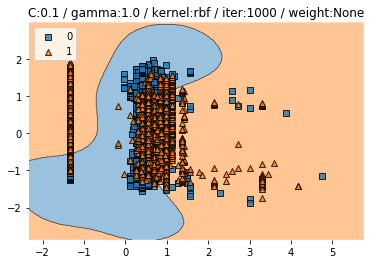

Test CV accuracy scores: [0.86749482 0.82194617 0.91088083 0.80186722 0.90975104]
Test CV accuracy: 0.862 +/- 0.045
Test CV f1 scores: [0.86383417 0.82299482 0.91017424 0.8029964  0.9085625 ]
Test CV f1: 0.862 +/- 0.044


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9378151260504202
Test f1 :  0.9303201506591338


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


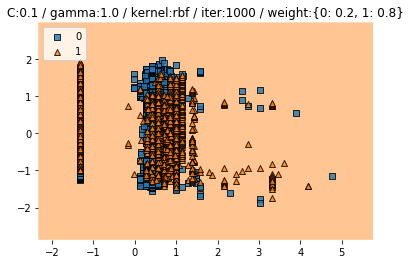

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


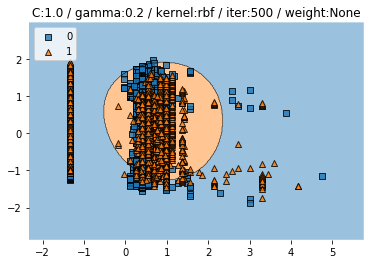

Test CV accuracy scores: [0.87888199 0.80538302 0.90984456 0.73651452 0.9253112 ]
Test CV accuracy: 0.851 +/- 0.071
Test CV f1 scores: [0.87606143 0.80649342 0.90915258 0.737468   0.92500097]
Test CV f1: 0.851 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6949579831932773
Test f1 :  0.7405289492494639


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


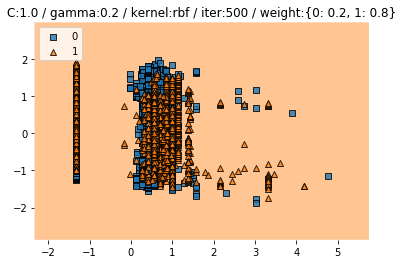

Test CV accuracy scores: [0.48240166 0.44513458 0.39896373 0.36307054 0.40041494]
Test CV accuracy: 0.418 +/- 0.041
Test CV f1 scores: [0.44139295 0.30243452 0.24115141 0.32833775 0.25048519]
Test CV f1: 0.313 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3798319327731092
Test f1 :  0.5505481120584653


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


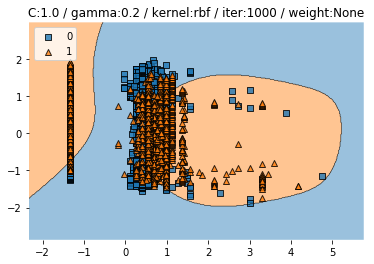

Test CV accuracy scores: [0.86542443 0.82401656 0.90984456 0.74688797 0.92634855]
Test CV accuracy: 0.855 +/- 0.065
Test CV f1 scores: [0.86136884 0.82505495 0.90896378 0.74802824 0.92550838]
Test CV f1: 0.854 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9378151260504202
Test f1 :  0.9300567107750473


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


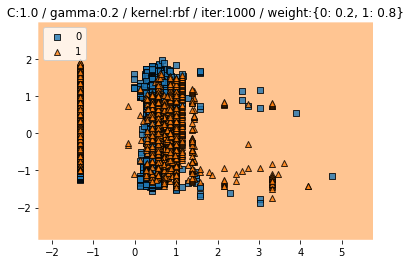

Test CV accuracy scores: [0.61076605 0.58178054 0.64974093 0.59128631 0.62759336]
Test CV accuracy: 0.612 +/- 0.025
Test CV f1 scores: [0.58963077 0.53466025 0.65183954 0.56190016 0.62051203]
Test CV f1: 0.592 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5596638655462185
Test f1 :  0.5618729096989966


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


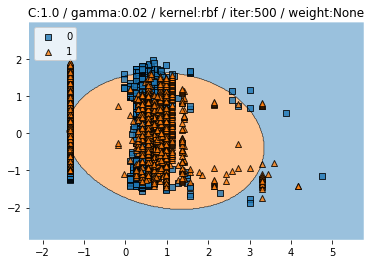

Test CV accuracy scores: [0.41511387 0.42339545 0.47979275 0.4253112  0.4346473 ]
Test CV accuracy: 0.436 +/- 0.023
Test CV f1 scores: [0.24840025 0.25369495 0.38616267 0.25622282 0.27951818]
Test CV f1: 0.285 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4722689075630252
Test f1 :  0.636574074074074


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


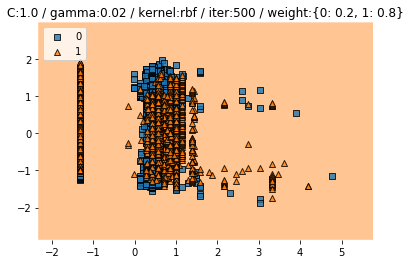

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


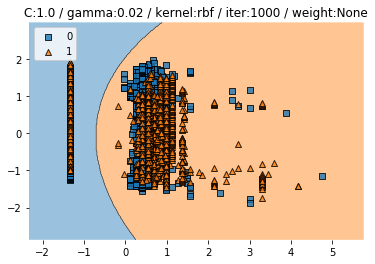

Test CV accuracy scores: [0.83436853 0.73291925 0.89948187 0.80290456 0.89107884]
Test CV accuracy: 0.832 +/- 0.061
Test CV f1 scores: [0.82669006 0.733896   0.89895128 0.80308927 0.8893728 ]
Test CV f1: 0.830 +/- 0.060


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7840336134453781
Test f1 :  0.8106116433308769


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


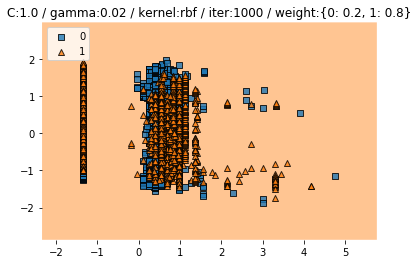

Test CV accuracy scores: [0.41718427 0.44409938 0.42176166 0.33921162 0.42323651]
Test CV accuracy: 0.409 +/- 0.036
Test CV f1 scores: [0.24927445 0.29717781 0.25265408 0.31212139 0.25172084]
Test CV f1: 0.273 +/- 0.027


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


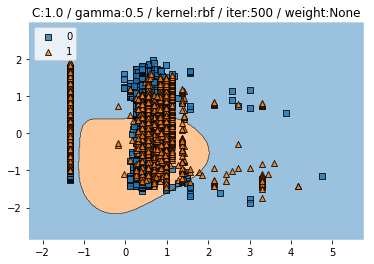

Test CV accuracy scores: [0.87163561 0.83436853 0.90673575 0.79149378 0.9346473 ]
Test CV accuracy: 0.868 +/- 0.051
Test CV f1 scores: [0.86808935 0.83522974 0.90530055 0.79271734 0.93404612]
Test CV f1: 0.867 +/- 0.050


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9470588235294117
Test f1 :  0.9407337723424272


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


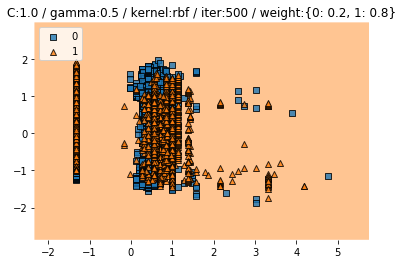

Test CV accuracy scores: [0.41925466 0.42546584 0.42279793 0.39626556 0.42427386]
Test CV accuracy: 0.418 +/- 0.011
Test CV f1 scores: [0.25194133 0.25637468 0.25127685 0.38704643 0.25397541]
Test CV f1: 0.280 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5588235294117647
Test f1 :  0.680073126142596


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


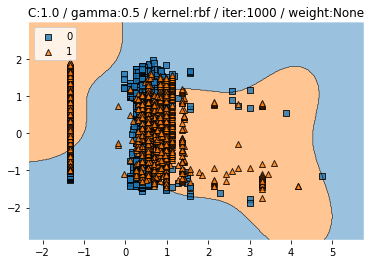

Test CV accuracy scores: [0.87784679 0.83643892 0.8984456  0.79045643 0.92842324]
Test CV accuracy: 0.866 +/- 0.048
Test CV f1 scores: [0.87466961 0.8372706  0.89681728 0.79169411 0.92752338]
Test CV f1: 0.866 +/- 0.047


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9478991596638655
Test f1 :  0.9417293233082706


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


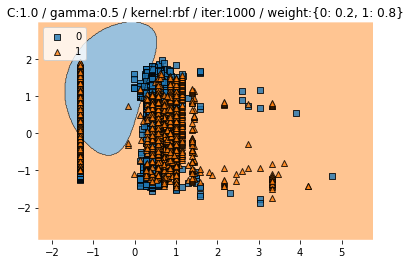

Test CV accuracy scores: [0.86231884 0.67908903 0.81243523 0.64315353 0.71058091]
Test CV accuracy: 0.742 +/- 0.083
Test CV f1 scores: [0.86312852 0.66166366 0.81218224 0.62628391 0.70332083]
Test CV f1: 0.733 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8563025210084033
Test f1 :  0.8547153780798641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


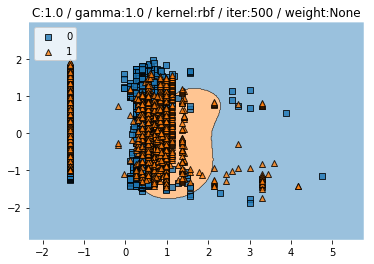

Test CV accuracy scores: [0.89440994 0.85403727 0.90673575 0.8153527  0.9253112 ]
Test CV accuracy: 0.879 +/- 0.040
Test CV f1 scores: [0.89214761 0.85475194 0.90530055 0.81638579 0.92460418]
Test CV f1: 0.879 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9470588235294117
Test f1 :  0.9408450704225352


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


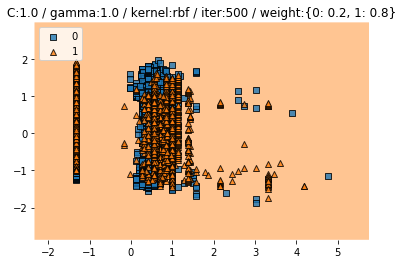

Test CV accuracy scores: [0.43478261 0.46480331 0.42279793 0.42427386 0.42323651]
Test CV accuracy: 0.434 +/- 0.016
Test CV f1 scores: [0.27624638 0.33669576 0.25127685 0.25934691 0.25172084]
Test CV f1: 0.275 +/- 0.032


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


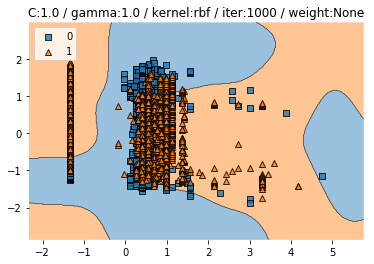

Test CV accuracy scores: [0.89026915 0.85403727 0.90466321 0.81639004 0.9253112 ]
Test CV accuracy: 0.878 +/- 0.039
Test CV f1 scores: [0.88775524 0.854732   0.90313459 0.81741016 0.9245637 ]
Test CV f1: 0.878 +/- 0.038


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9478991596638655
Test f1 :  0.9418386491557225


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


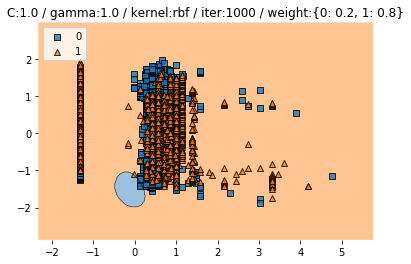

Test CV accuracy scores: [0.89440994 0.73395445 0.90362694 0.6473029  0.85165975]
Test CV accuracy: 0.806 +/- 0.100
Test CV f1 scores: [0.89479609 0.72710997 0.90419214 0.63365418 0.8524361 ]
Test CV f1: 0.802 +/- 0.105


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8596638655462185
Test f1 :  0.868607395751377


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


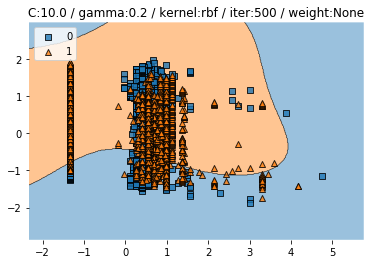

Test CV accuracy scores: [0.87060041 0.81469979 0.87875648 0.73547718 0.90352697]
Test CV accuracy: 0.841 +/- 0.060
Test CV f1 scores: [0.86768443 0.81558176 0.8761848  0.7362367  0.90314686]
Test CV f1: 0.840 +/- 0.059


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9369747899159664
Test f1 :  0.9291784702549574


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


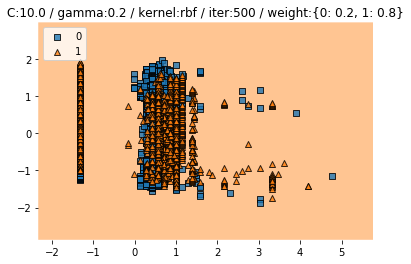

Test CV accuracy scores: [0.62318841 0.5931677  0.5119171  0.50829876 0.50829876]
Test CV accuracy: 0.549 +/- 0.049
Test CV f1 scores: [0.5975922  0.56429389 0.47917792 0.44349999 0.51053962]
Test CV f1: 0.519 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7445378151260504
Test f1 :  0.6813417190775681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


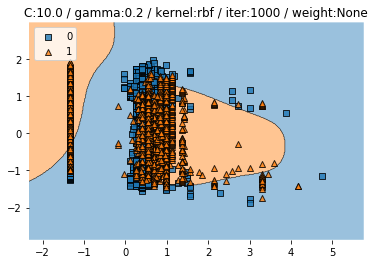

Test CV accuracy scores: [0.89440994 0.8447205  0.90984456 0.78423237 0.93568465]
Test CV accuracy: 0.874 +/- 0.054
Test CV f1 scores: [0.89229976 0.84563198 0.90842823 0.78549486 0.93500546]
Test CV f1: 0.873 +/- 0.053


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9470588235294117
Test f1 :  0.9406220546654099


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


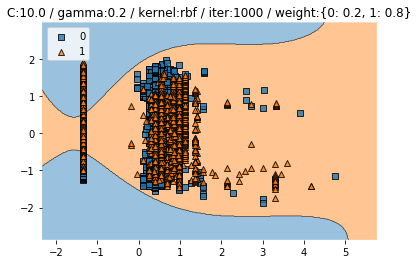

Test CV accuracy scores: [0.93064182 0.77950311 0.92849741 0.67427386 0.88070539]
Test CV accuracy: 0.839 +/- 0.099
Test CV f1 scores: [0.93050821 0.77828913 0.92846151 0.66573556 0.88136818]
Test CV f1: 0.837 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9420168067226891
Test f1 :  0.9389920424403183


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


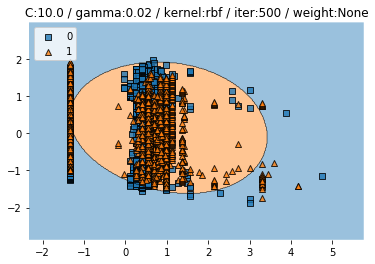

Test CV accuracy scores: [0.89958592 0.51242236 0.41968912 0.41908714 0.52074689]
Test CV accuracy: 0.554 +/- 0.178
Test CV f1 scores: [0.8986125  0.42505606 0.28172344 0.25533266 0.43705327]
Test CV f1: 0.460 +/- 0.231


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.44201680672268906
Test f1 :  0.5875776397515529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


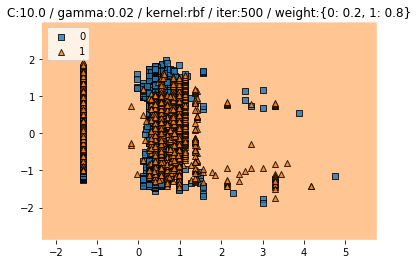

Test CV accuracy scores: [0.30538302 0.50310559 0.49637306 0.35062241 0.42116183]
Test CV accuracy: 0.415 +/- 0.078
Test CV f1 scores: [0.2243024  0.41567412 0.48588137 0.32835532 0.25085259]
Test CV f1: 0.341 +/- 0.098


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.44789915966386556
Test f1 :  0.6182452062754211


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


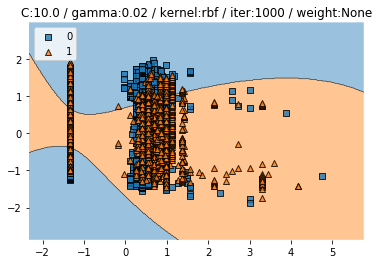

Test CV accuracy scores: [0.86749482 0.76708075 0.91295337 0.76659751 0.90248963]
Test CV accuracy: 0.843 +/- 0.064
Test CV f1 scores: [0.86372482 0.76834129 0.91251359 0.76797809 0.90099359]
Test CV f1: 0.843 +/- 0.063


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9193277310924369
Test f1 :  0.9102803738317758


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


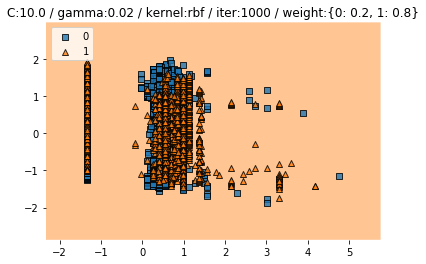

Test CV accuracy scores: [0.56418219 0.56004141 0.6        0.5653527  0.47614108]
Test CV accuracy: 0.553 +/- 0.041
Test CV f1 scores: [0.53535872 0.50270897 0.59053464 0.51789819 0.47893761]
Test CV f1: 0.525 +/- 0.038


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5159663865546219
Test f1 :  0.5534883720930233


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


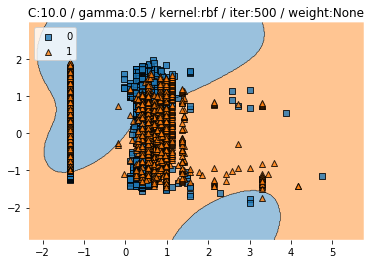

Test CV accuracy scores: [0.90062112 0.85196687 0.90569948 0.82883817 0.90145228]
Test CV accuracy: 0.878 +/- 0.031
Test CV f1 scores: [0.89884191 0.85275964 0.904031   0.82984895 0.8993676 ]
Test CV f1: 0.877 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9008403361344538
Test f1 :  0.8931159420289855


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


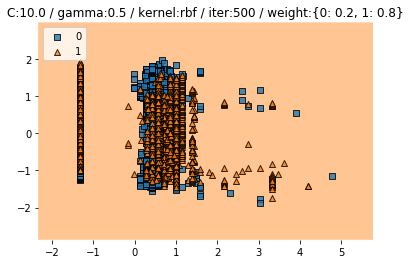

Test CV accuracy scores: [0.80641822 0.71635611 0.79585492 0.66701245 0.81950207]
Test CV accuracy: 0.761 +/- 0.059
Test CV f1 scores: [0.80756052 0.71254797 0.79495922 0.65684477 0.82011862]
Test CV f1: 0.758 +/- 0.063


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8428571428571429
Test f1 :  0.8316831683168318


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


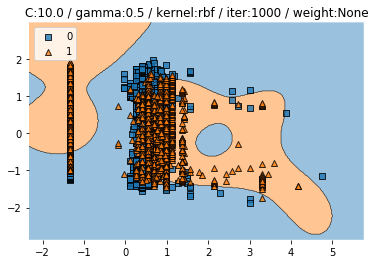

Test CV accuracy scores: [0.9047619  0.88302277 0.90051813 0.82780083 0.90560166]
Test CV accuracy: 0.884 +/- 0.029
Test CV f1 scores: [0.90299177 0.88356254 0.89844424 0.82879678 0.90552194]
Test CV f1: 0.884 +/- 0.029


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.946218487394958
Test f1 :  0.9397363465160075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


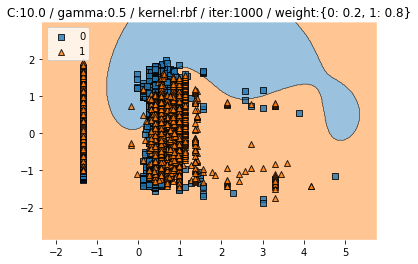

Test CV accuracy scores: [0.91925466 0.82401656 0.91606218 0.6659751  0.90975104]
Test CV accuracy: 0.847 +/- 0.097
Test CV f1 scores: [0.91885007 0.82441497 0.91573008 0.65591103 0.90997138]
Test CV f1: 0.845 +/- 0.101


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9563025210084034
Test f1 :  0.9523809523809524


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


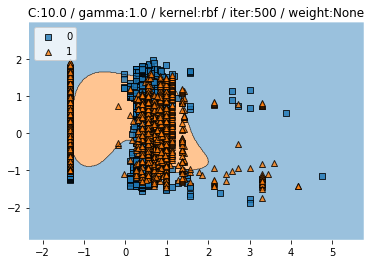

Test CV accuracy scores: [0.89648033 0.86024845 0.89637306 0.81846473 0.87863071]
Test CV accuracy: 0.870 +/- 0.029
Test CV f1 scores: [0.89395054 0.86091362 0.89421275 0.81953002 0.87830198]
Test CV f1: 0.869 +/- 0.028


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9294117647058824
Test f1 :  0.9192307692307693


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


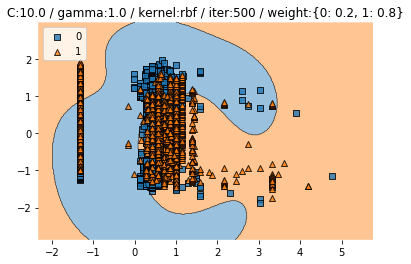

Test CV accuracy scores: [0.84989648 0.80227743 0.81761658 0.74585062 0.86721992]
Test CV accuracy: 0.817 +/- 0.042
Test CV f1 scores: [0.85061092 0.80152509 0.81749363 0.74409663 0.86799684]
Test CV f1: 0.816 +/- 0.043


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7747899159663866
Test f1 :  0.7372549019607842


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


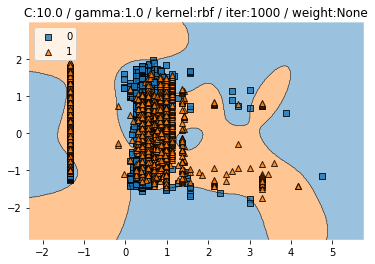

Test CV accuracy scores: [0.89958592 0.8747412  0.88601036 0.81120332 0.88589212]
Test CV accuracy: 0.871 +/- 0.031
Test CV f1 scores: [0.89754342 0.87545208 0.88283962 0.81232242 0.88573475]
Test CV f1: 0.871 +/- 0.030


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9403361344537815
Test f1 :  0.9327014218009478


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


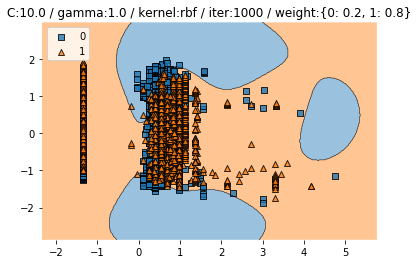

Test CV accuracy scores: [0.9047619  0.81987578 0.9119171  0.73547718 0.88589212]
Test CV accuracy: 0.852 +/- 0.067
Test CV f1 scores: [0.9042847  0.82023797 0.91137027 0.7331347  0.88631118]
Test CV f1: 0.851 +/- 0.067


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9487394957983193
Test f1 :  0.9440879926672777


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


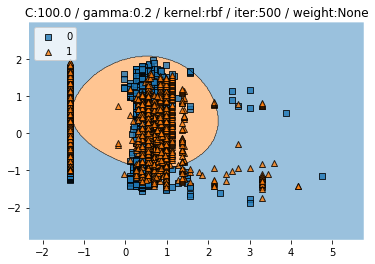

Test CV accuracy scores: [0.75879917 0.7805383  0.64974093 0.71473029 0.68360996]
Test CV accuracy: 0.717 +/- 0.048
Test CV f1 scores: [0.75764421 0.78170268 0.62500809 0.71561334 0.64429431]
Test CV f1: 0.705 +/- 0.061


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6554621848739496
Test f1 :  0.6611570247933884


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


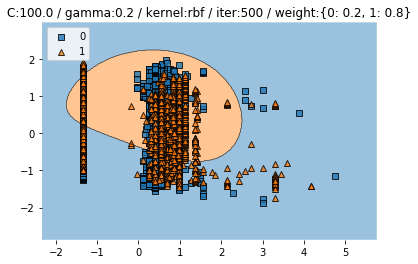

Test CV accuracy scores: [0.72463768 0.59006211 0.74611399 0.53215768 0.75311203]
Test CV accuracy: 0.669 +/- 0.091
Test CV f1 scores: [0.72361526 0.5850266  0.74571562 0.52428703 0.74408587]
Test CV f1: 0.665 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7025210084033613
Test f1 :  0.6304801670146137


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


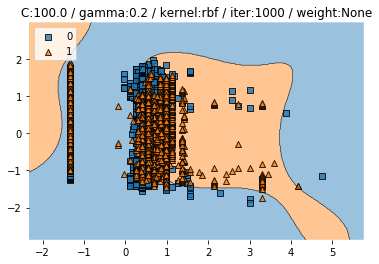

Test CV accuracy scores: [0.83643892 0.81055901 0.84041451 0.81327801 0.85373444]
Test CV accuracy: 0.831 +/- 0.017
Test CV f1 scores: [0.83659156 0.81167596 0.83515313 0.81409924 0.84997159]
Test CV f1: 0.829 +/- 0.015


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8126050420168067
Test f1 :  0.7948482060717571


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


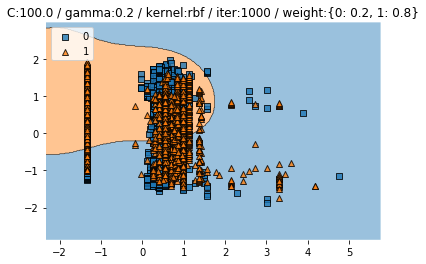

Test CV accuracy scores: [0.88405797 0.77122153 0.77409326 0.61929461 0.90248963]
Test CV accuracy: 0.790 +/- 0.101
Test CV f1 scores: [0.88381269 0.7698597  0.76581658 0.60607672 0.90171931]
Test CV f1: 0.785 +/- 0.106


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8714285714285714
Test f1 :  0.8668407310704961


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


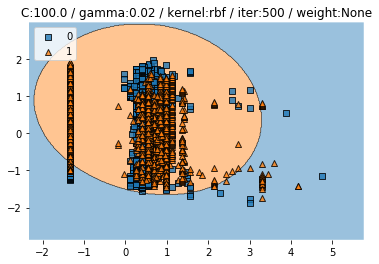

Test CV accuracy scores: [0.72567288 0.65113872 0.76683938 0.57365145 0.68879668]
Test CV accuracy: 0.681 +/- 0.066
Test CV f1 scores: [0.72604842 0.63657123 0.76796672 0.55063043 0.6818693 ]
Test CV f1: 0.673 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.36554621848739494
Test f1 :  0.4694307800421645


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


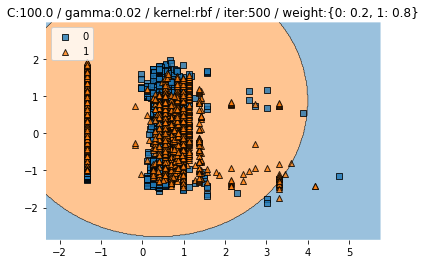

Test CV accuracy scores: [0.46480331 0.52484472 0.59792746 0.3973029  0.49481328]
Test CV accuracy: 0.496 +/- 0.066
Test CV f1 scores: [0.46161749 0.5017623  0.60000228 0.39102621 0.49769238]
Test CV f1: 0.490 +/- 0.068


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6327731092436975
Test f1 :  0.6641045349730975


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


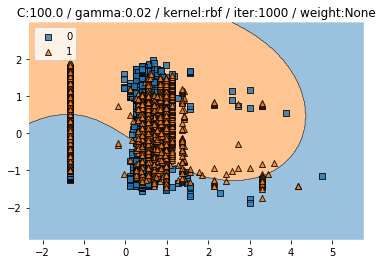

Test CV accuracy scores: [0.78778468 0.75258799 0.81865285 0.68049793 0.81742739]
Test CV accuracy: 0.771 +/- 0.051
Test CV f1 scores: [0.78111484 0.75323809 0.81777726 0.67655693 0.81833699]
Test CV f1: 0.769 +/- 0.052


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9
Test f1 :  0.898550724637681


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


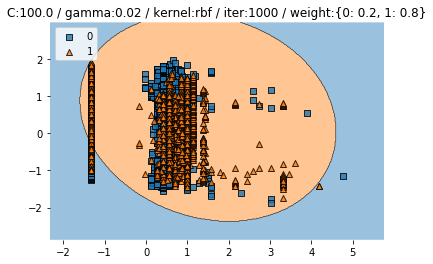

Test CV accuracy scores: [0.74223602 0.6863354  0.55854922 0.62448133 0.73340249]
Test CV accuracy: 0.669 +/- 0.069
Test CV f1 scores: [0.73983177 0.67466953 0.54357561 0.60318862 0.72675448]
Test CV f1: 0.658 +/- 0.075


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7
Test f1 :  0.7433501078360892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


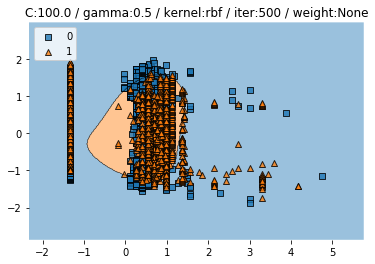

Test CV accuracy scores: [0.74120083 0.72360248 0.79896373 0.6473029  0.82987552]
Test CV accuracy: 0.748 +/- 0.063
Test CV f1 scores: [0.72438575 0.72149783 0.79082218 0.6492479  0.82487068]
Test CV f1: 0.742 +/- 0.061


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7453781512605042
Test f1 :  0.7282511210762331


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


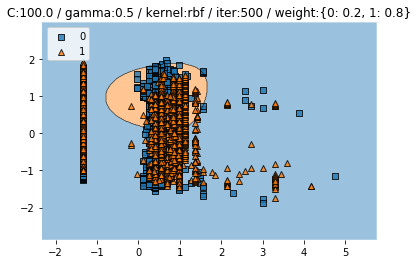

Test CV accuracy scores: [0.78571429 0.70496894 0.82176166 0.6939834  0.6846473 ]
Test CV accuracy: 0.738 +/- 0.055
Test CV f1 scores: [0.78005504 0.70653738 0.82176166 0.68940343 0.66485984]
Test CV f1: 0.733 +/- 0.059


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6243697478991597
Test f1 :  0.6068601583113455


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


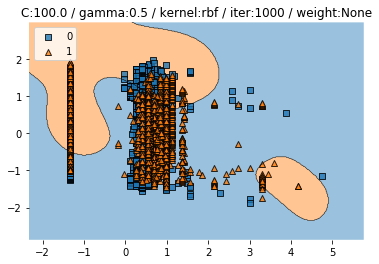

Test CV accuracy scores: [0.86438923 0.8436853  0.8611399  0.69294606 0.81431535]
Test CV accuracy: 0.815 +/- 0.064
Test CV f1 scores: [0.85988769 0.84458156 0.85966854 0.69340208 0.81358373]
Test CV f1: 0.814 +/- 0.063


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9033613445378151
Test f1 :  0.886025768087215


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


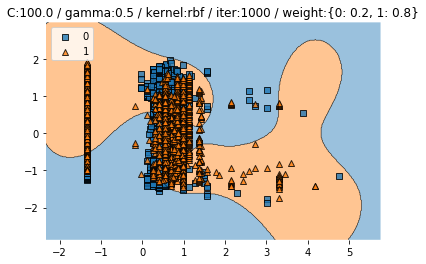

Test CV accuracy scores: [0.90062112 0.83540373 0.89948187 0.72406639 0.85580913]
Test CV accuracy: 0.843 +/- 0.065
Test CV f1 scores: [0.90033337 0.83634356 0.89855397 0.71933667 0.85663933]
Test CV f1: 0.842 +/- 0.066


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8899159663865546
Test f1 :  0.8833481745325021


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


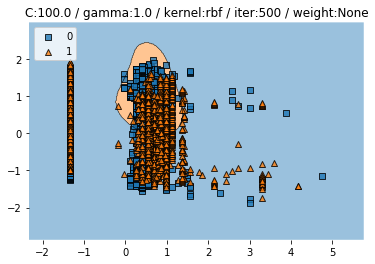

Test CV accuracy scores: [0.69875776 0.79296066 0.75336788 0.64522822 0.62448133]
Test CV accuracy: 0.703 +/- 0.063
Test CV f1 scores: [0.66793448 0.78939324 0.73847781 0.64499019 0.61496947]
Test CV f1: 0.691 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7403361344537815
Test f1 :  0.6236297198538368


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


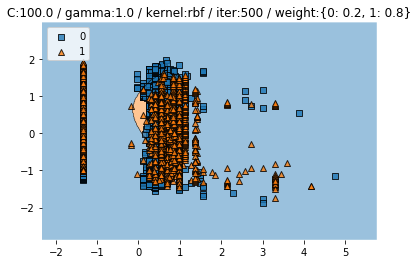

Test CV accuracy scores: [0.76501035 0.76501035 0.79481865 0.70124481 0.6939834 ]
Test CV accuracy: 0.744 +/- 0.039
Test CV f1 scores: [0.74573733 0.76552245 0.78710701 0.70295652 0.69013617]
Test CV f1: 0.738 +/- 0.037


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.7739495798319328
Test f1 :  0.7365328109696375


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


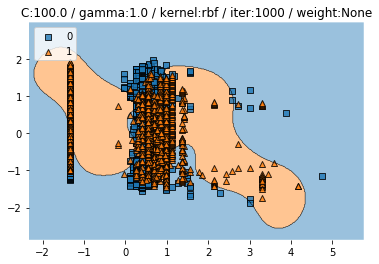

Test CV accuracy scores: [0.86749482 0.8426501  0.88704663 0.76763485 0.87136929]
Test CV accuracy: 0.847 +/- 0.042
Test CV f1 scores: [0.86638497 0.84308949 0.88413356 0.76777888 0.8695575 ]
Test CV f1: 0.846 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.8571428571428571
Test f1 :  0.8471223021582733


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


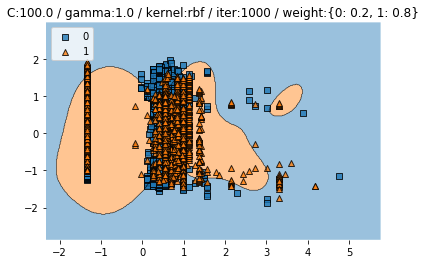

Test CV accuracy scores: [0.9047619  0.84886128 0.89015544 0.79045643 0.86825726]
Test CV accuracy: 0.860 +/- 0.040
Test CV f1 scores: [0.90386424 0.84975028 0.88832216 0.79010012 0.86861107]
Test CV f1: 0.860 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.9361344537815126
Test f1 :  0.9284369114877589
733.6237428188324 secs


In [15]:
# blog rbf
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 0.5, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
param_list =[{"C": c, "gamma": gamma, "kernel": "rbf", "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(3,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")

C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


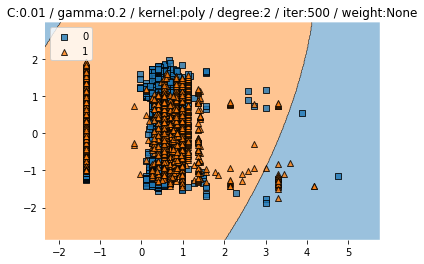

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


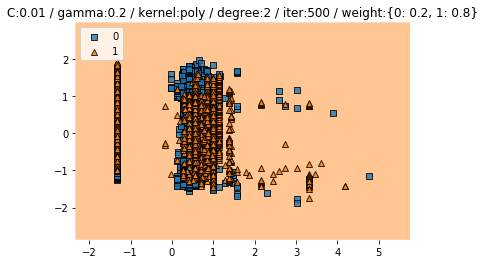

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


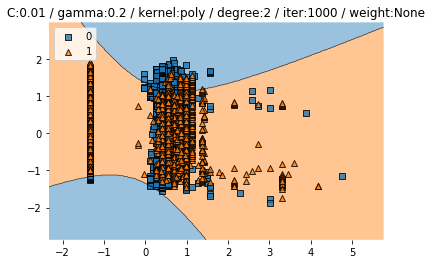

Test CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Test CV accuracy: 0.469 +/- 0.095
Test CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Test CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


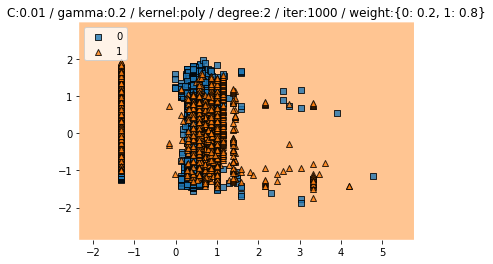

Test CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


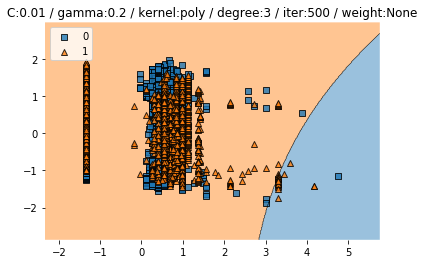

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


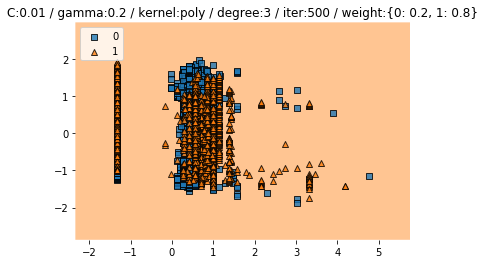

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


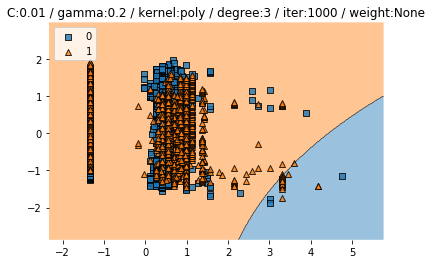

Test CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Test CV accuracy: 0.469 +/- 0.095
Test CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Test CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


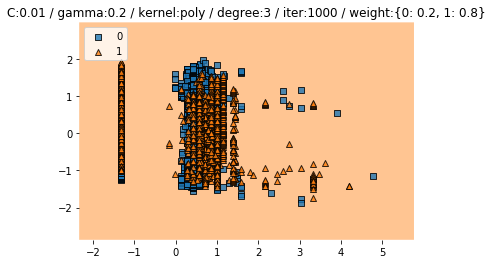

Test CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


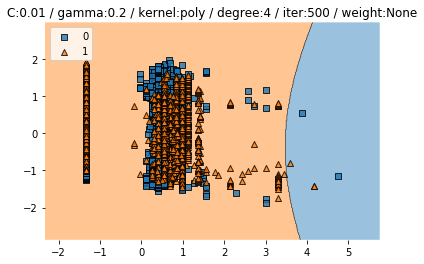

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


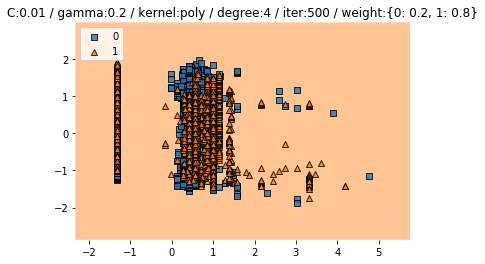

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


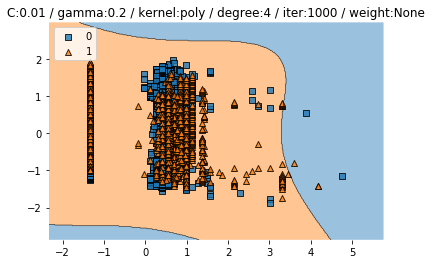

Test CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Test CV accuracy: 0.469 +/- 0.095
Test CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Test CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


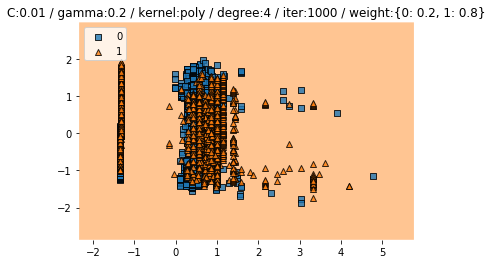

Test CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


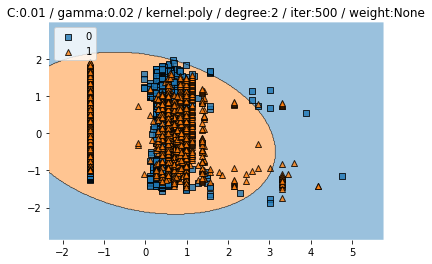

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


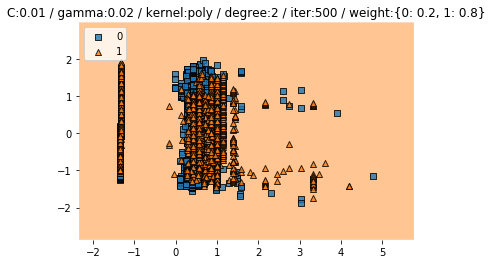

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


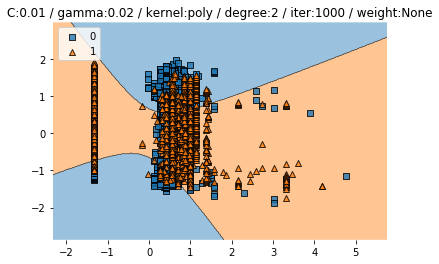

Test CV accuracy scores: [0.42339545 0.53519669 0.42279793 0.42323651 0.43568465]
Test CV accuracy: 0.448 +/- 0.044
Test CV f1 scores: [0.2518818  0.48170095 0.25127685 0.25172084 0.28167569]
Test CV f1: 0.304 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


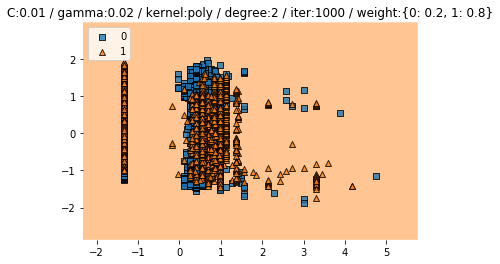

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


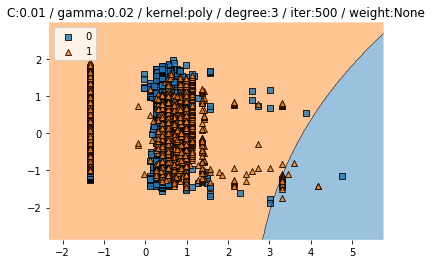

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


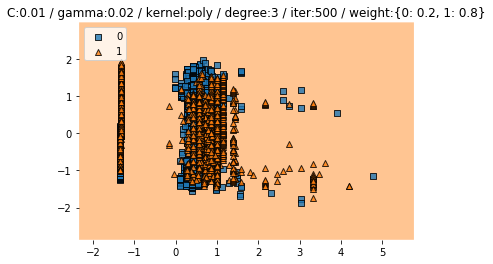

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


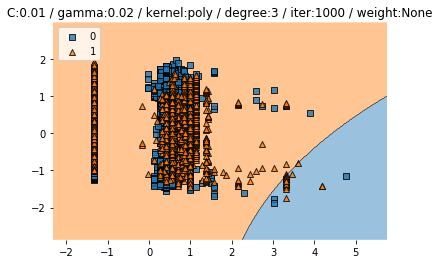

Test CV accuracy scores: [0.42339545 0.53519669 0.42279793 0.42323651 0.43568465]
Test CV accuracy: 0.448 +/- 0.044
Test CV f1 scores: [0.2518818  0.48170095 0.25127685 0.25172084 0.28167569]
Test CV f1: 0.304 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


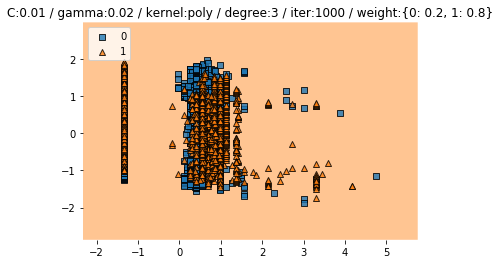

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


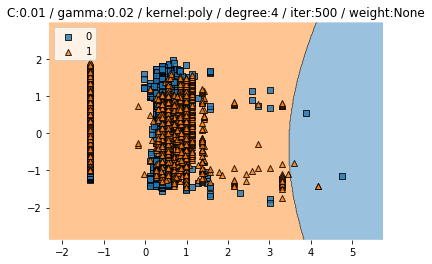

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


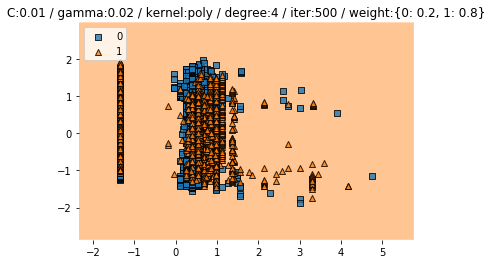

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


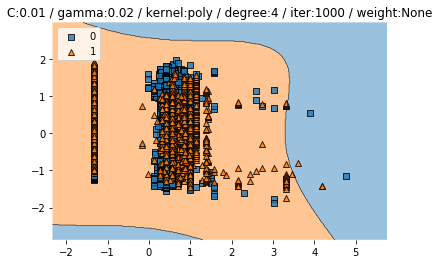

Test CV accuracy scores: [0.42339545 0.53519669 0.42279793 0.42323651 0.43568465]
Test CV accuracy: 0.448 +/- 0.044
Test CV f1 scores: [0.2518818  0.48170095 0.25127685 0.25172084 0.28167569]
Test CV f1: 0.304 +/- 0.090


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


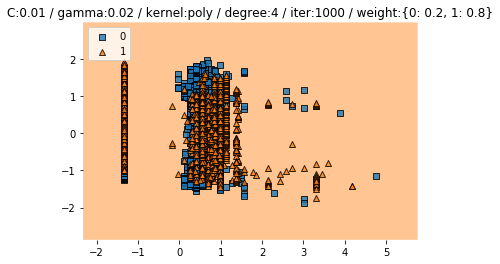

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


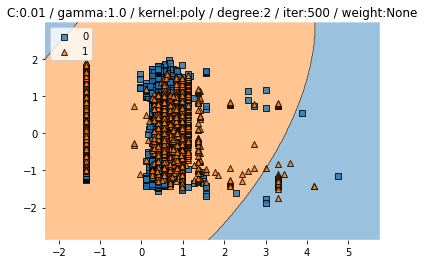

Test CV accuracy scores: [0.42339545 0.42443064 0.4134715  0.42323651 0.42323651]
Test CV accuracy: 0.422 +/- 0.004
Test CV f1 scores: [0.2518818  0.25593397 0.24913016 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4689075630252101
Test f1 :  0.6384439359267735


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


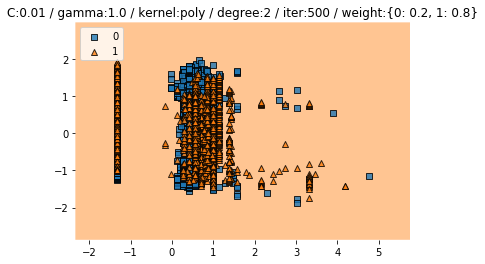

Test CV accuracy scores: [0.42236025 0.43271222 0.40310881 0.41493776 0.42116183]
Test CV accuracy: 0.419 +/- 0.010
Test CV f1 scores: [0.25144882 0.27187859 0.24466824 0.24823256 0.25085259]
Test CV f1: 0.253 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


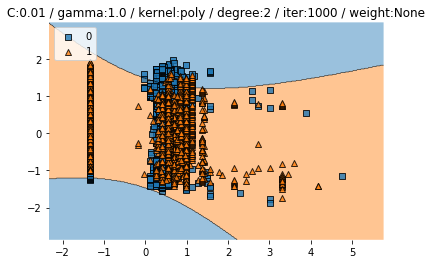

Test CV accuracy scores: [0.42339545 0.66977226 0.41761658 0.43983402 0.42842324]
Test CV accuracy: 0.476 +/- 0.097
Test CV f1 scores: [0.2518818  0.66718718 0.25089713 0.29506091 0.26292254]
Test CV f1: 0.346 +/- 0.162


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4781512605042017
Test f1 :  0.6428982173663025


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


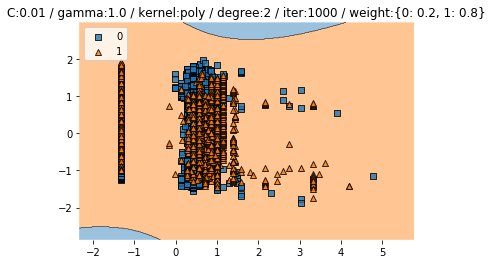

Test CV accuracy scores: [0.42132505 0.54451346 0.40414508 0.41804979 0.4159751 ]
Test CV accuracy: 0.441 +/- 0.052
Test CV f1 scores: [0.25101522 0.47896186 0.24511732 0.24954545 0.25045632]
Test CV f1: 0.295 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6372492836676217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


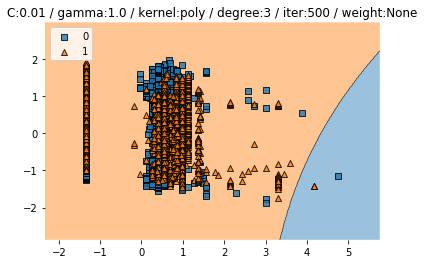

Test CV accuracy scores: [0.42339545 0.42443064 0.4134715  0.42323651 0.42323651]
Test CV accuracy: 0.422 +/- 0.004
Test CV f1 scores: [0.2518818  0.25593397 0.24913016 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4689075630252101
Test f1 :  0.6384439359267735


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


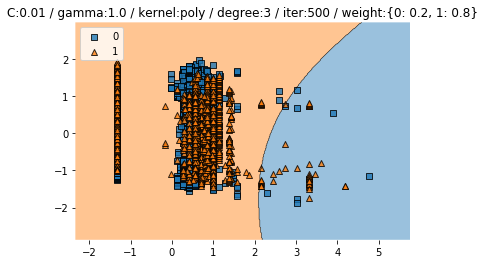

Test CV accuracy scores: [0.42236025 0.43271222 0.40310881 0.41493776 0.42116183]
Test CV accuracy: 0.419 +/- 0.010
Test CV f1 scores: [0.25144882 0.27187859 0.24466824 0.24823256 0.25085259]
Test CV f1: 0.253 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


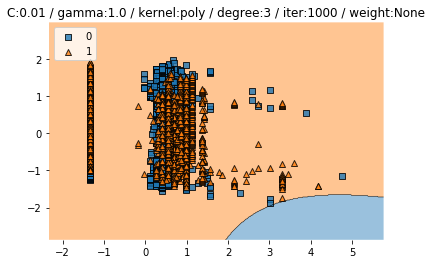

Test CV accuracy scores: [0.42339545 0.66977226 0.41761658 0.43983402 0.42842324]
Test CV accuracy: 0.476 +/- 0.097
Test CV f1 scores: [0.2518818  0.66718718 0.25089713 0.29506091 0.26292254]
Test CV f1: 0.346 +/- 0.162


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4781512605042017
Test f1 :  0.6428982173663025


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


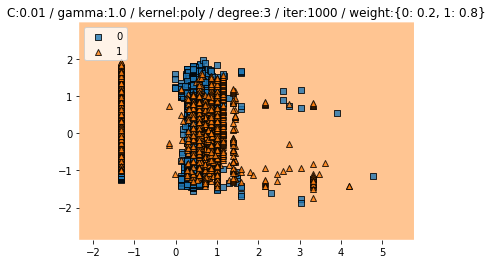

Test CV accuracy scores: [0.42132505 0.54451346 0.40414508 0.41804979 0.4159751 ]
Test CV accuracy: 0.441 +/- 0.052
Test CV f1 scores: [0.25101522 0.47896186 0.24511732 0.24954545 0.25045632]
Test CV f1: 0.295 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6372492836676217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


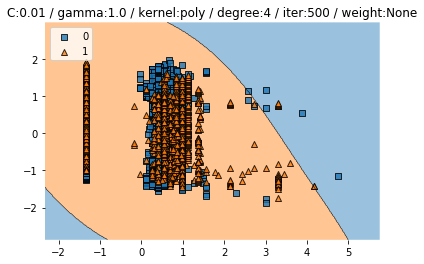

Test CV accuracy scores: [0.42339545 0.42443064 0.4134715  0.42323651 0.42323651]
Test CV accuracy: 0.422 +/- 0.004
Test CV f1 scores: [0.2518818  0.25593397 0.24913016 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4689075630252101
Test f1 :  0.6384439359267735


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


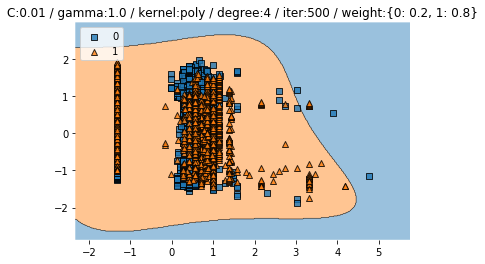

Test CV accuracy scores: [0.42236025 0.43271222 0.40310881 0.41493776 0.42116183]
Test CV accuracy: 0.419 +/- 0.010
Test CV f1 scores: [0.25144882 0.27187859 0.24466824 0.24823256 0.25085259]
Test CV f1: 0.253 +/- 0.010


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


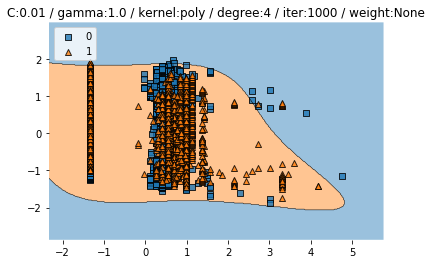

Test CV accuracy scores: [0.42339545 0.66977226 0.41761658 0.43983402 0.42842324]
Test CV accuracy: 0.476 +/- 0.097
Test CV f1 scores: [0.2518818  0.66718718 0.25089713 0.29506091 0.26292254]
Test CV f1: 0.346 +/- 0.162


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4781512605042017
Test f1 :  0.6428982173663025


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


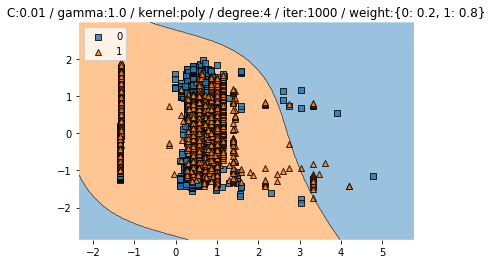

Test CV accuracy scores: [0.42132505 0.54451346 0.40414508 0.41804979 0.4159751 ]
Test CV accuracy: 0.441 +/- 0.052
Test CV f1 scores: [0.25101522 0.47896186 0.24511732 0.24954545 0.25045632]
Test CV f1: 0.295 +/- 0.092


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6372492836676217


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


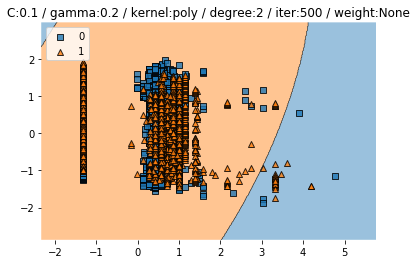

Test CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Test CV accuracy: 0.427 +/- 0.041
Test CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Test CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


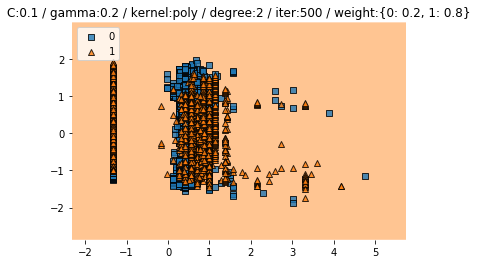

Test CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.005
Test CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


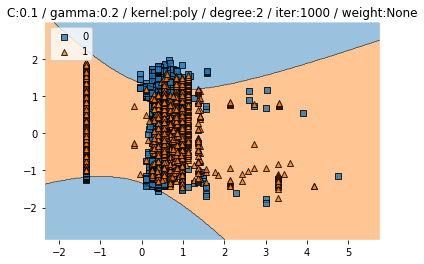

Test CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Test CV accuracy: 0.550 +/- 0.161
Test CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Test CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


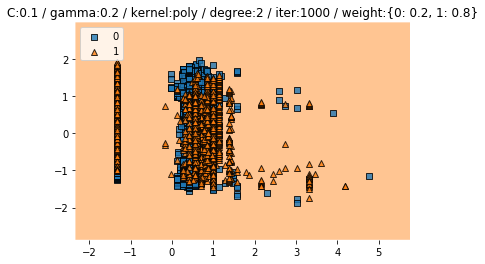

Test CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Test CV accuracy: 0.420 +/- 0.005
Test CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Test CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


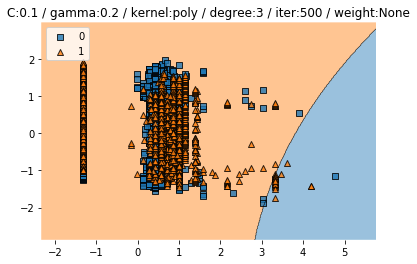

Test CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Test CV accuracy: 0.427 +/- 0.041
Test CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Test CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


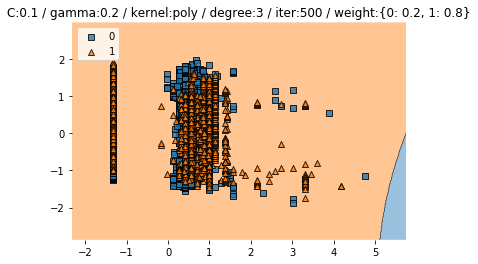

Test CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.005
Test CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


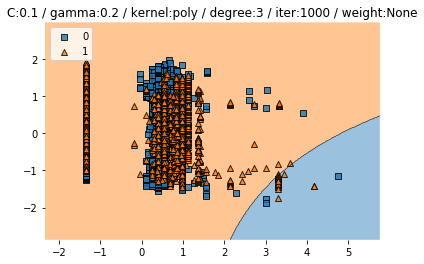

Test CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Test CV accuracy: 0.550 +/- 0.161
Test CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Test CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


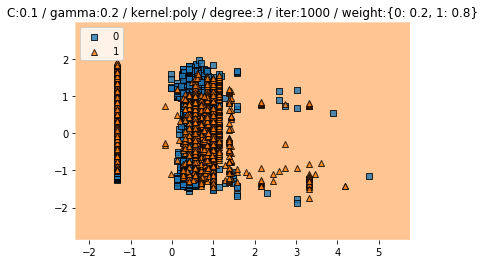

Test CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Test CV accuracy: 0.420 +/- 0.005
Test CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Test CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


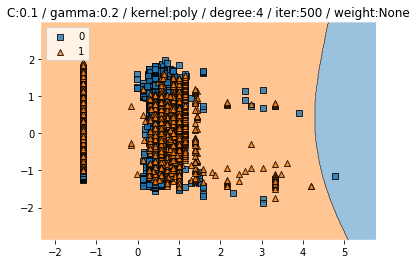

Test CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Test CV accuracy: 0.427 +/- 0.041
Test CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Test CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


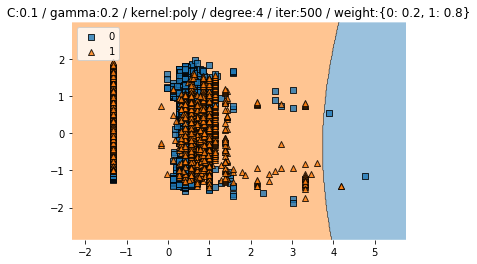

Test CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.005
Test CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


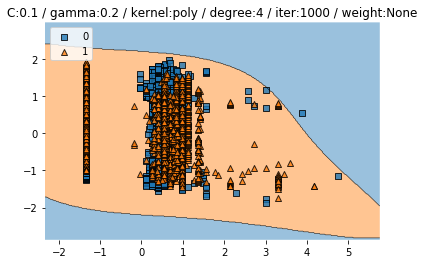

Test CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Test CV accuracy: 0.550 +/- 0.161
Test CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Test CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


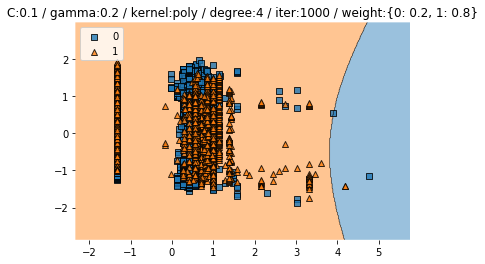

Test CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Test CV accuracy: 0.420 +/- 0.005
Test CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Test CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


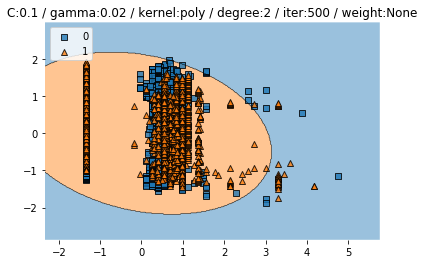

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


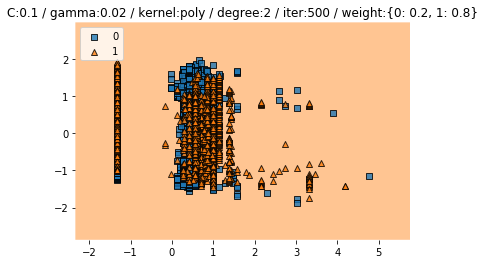

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


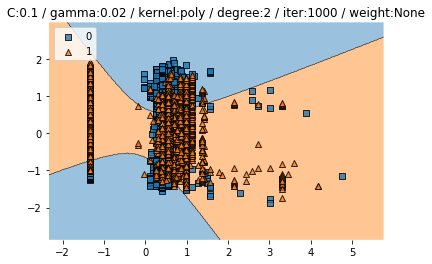

Test CV accuracy scores: [0.42339545 0.53416149 0.42279793 0.42323651 0.43568465]
Test CV accuracy: 0.448 +/- 0.043
Test CV f1 scores: [0.2518818  0.4809247  0.25127685 0.25172084 0.28167569]
Test CV f1: 0.303 +/- 0.089


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


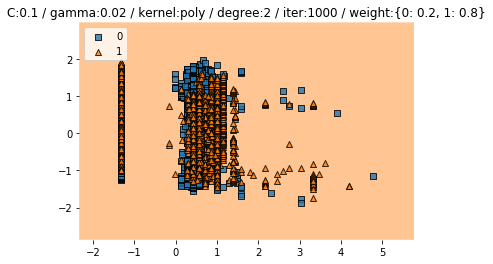

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


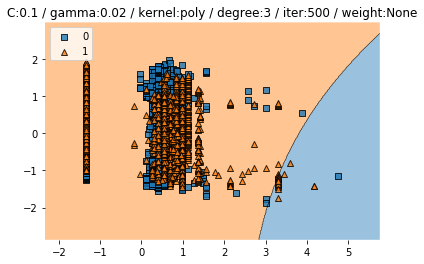

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


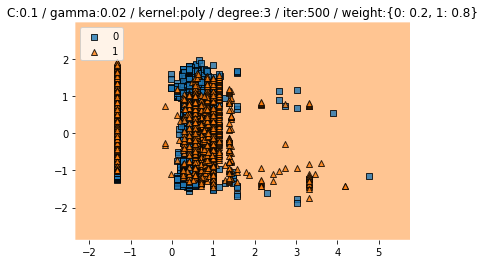

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


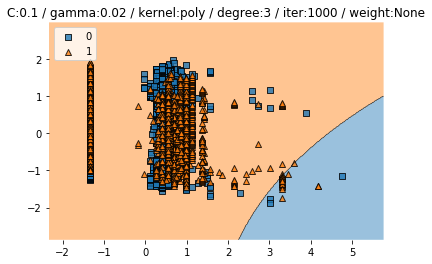

Test CV accuracy scores: [0.42339545 0.53416149 0.42279793 0.42323651 0.43568465]
Test CV accuracy: 0.448 +/- 0.043
Test CV f1 scores: [0.2518818  0.4809247  0.25127685 0.25172084 0.28167569]
Test CV f1: 0.303 +/- 0.089


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


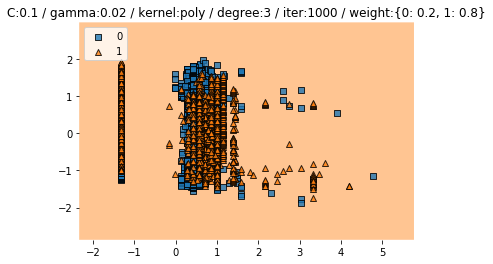

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


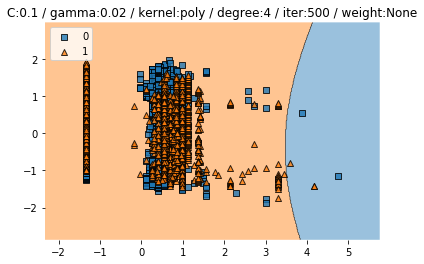

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42219917]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25309938]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


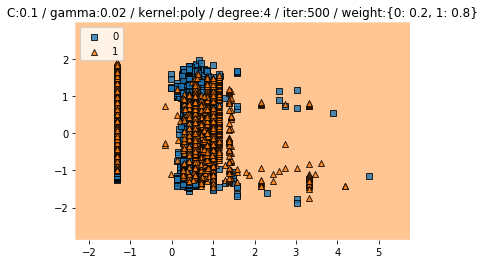

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


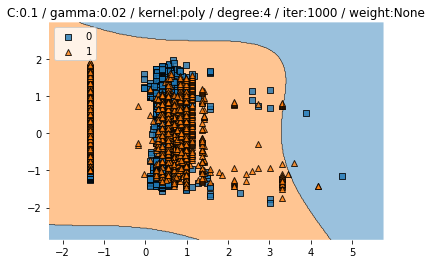

Test CV accuracy scores: [0.42339545 0.53416149 0.42279793 0.42323651 0.43568465]
Test CV accuracy: 0.448 +/- 0.043
Test CV f1 scores: [0.2518818  0.4809247  0.25127685 0.25172084 0.28167569]
Test CV f1: 0.303 +/- 0.089


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


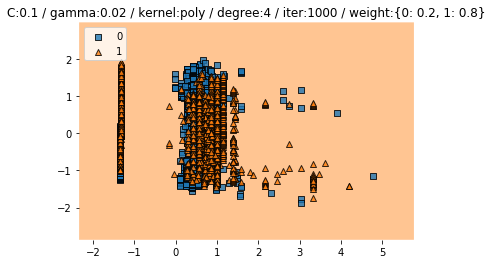

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


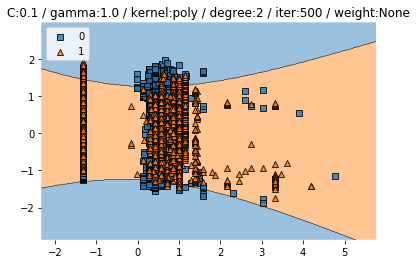

Test CV accuracy scores: [0.41511387 0.42236025 0.48601036 0.42323651 0.42219917]
Test CV accuracy: 0.434 +/- 0.026
Test CV f1 scores: [0.24840025 0.2585917  0.39237704 0.25172084 0.25309938]
Test CV f1: 0.281 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6249261665682221


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


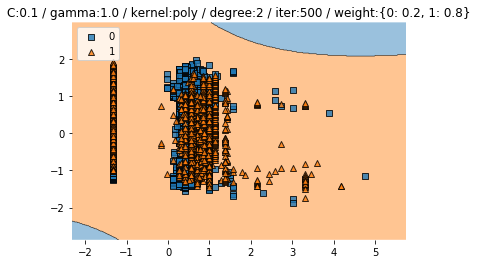

Test CV accuracy scores: [0.41614907 0.5610766  0.40725389 0.4253112  0.60165975]
Test CV accuracy: 0.482 +/- 0.082
Test CV f1 scores: [0.24883767 0.50349271 0.27554234 0.25622282 0.5754382 ]
Test CV f1: 0.372 +/- 0.139


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


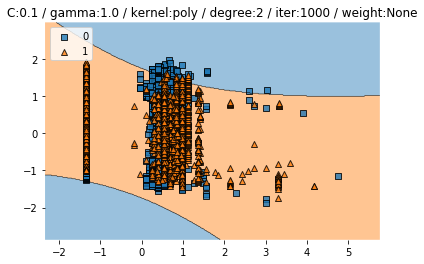

Test CV accuracy scores: [0.42339545 0.49585921 0.40932642 0.41908714 0.62136929]
Test CV accuracy: 0.474 +/- 0.080
Test CV f1 scores: [0.25369495 0.4066124  0.24735307 0.2499818  0.59099099]
Test CV f1: 0.350 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6345381526104418


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


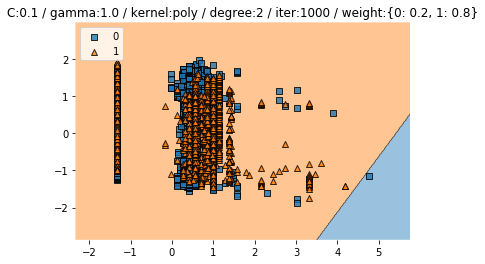

Test CV accuracy scores: [0.58385093 0.50517598 0.43108808 0.42323651 0.41804979]
Test CV accuracy: 0.472 +/- 0.064
Test CV f1 scores: [0.54087109 0.41159737 0.31376351 0.28373242 0.26846907]
Test CV f1: 0.364 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6277030976037405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


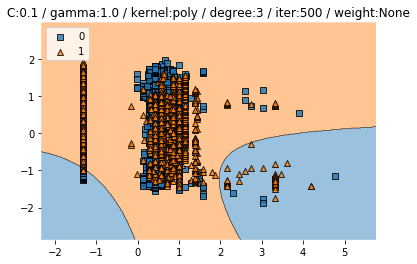

Test CV accuracy scores: [0.41511387 0.42236025 0.48601036 0.42323651 0.42219917]
Test CV accuracy: 0.434 +/- 0.026
Test CV f1 scores: [0.24840025 0.2585917  0.39237704 0.25172084 0.25309938]
Test CV f1: 0.281 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6249261665682221


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


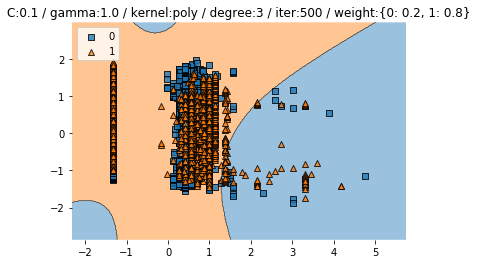

Test CV accuracy scores: [0.41614907 0.5610766  0.40725389 0.4253112  0.60165975]
Test CV accuracy: 0.482 +/- 0.082
Test CV f1 scores: [0.24883767 0.50349271 0.27554234 0.25622282 0.5754382 ]
Test CV f1: 0.372 +/- 0.139


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


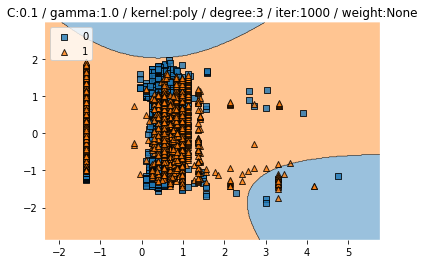

Test CV accuracy scores: [0.42339545 0.49585921 0.40932642 0.41908714 0.62136929]
Test CV accuracy: 0.474 +/- 0.080
Test CV f1 scores: [0.25369495 0.4066124  0.24735307 0.2499818  0.59099099]
Test CV f1: 0.350 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6345381526104418


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


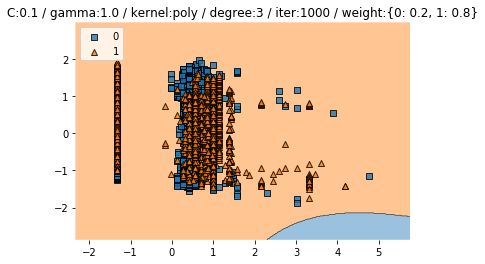

Test CV accuracy scores: [0.58385093 0.50517598 0.43108808 0.42323651 0.41804979]
Test CV accuracy: 0.472 +/- 0.064
Test CV f1 scores: [0.54087109 0.41159737 0.31376351 0.28373242 0.26846907]
Test CV f1: 0.364 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6277030976037405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


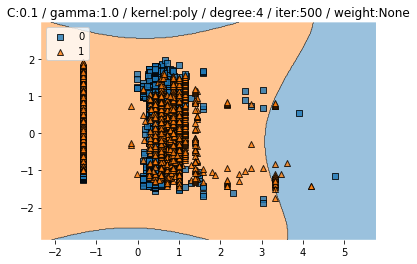

Test CV accuracy scores: [0.41511387 0.42236025 0.48601036 0.42323651 0.42219917]
Test CV accuracy: 0.434 +/- 0.026
Test CV f1 scores: [0.24840025 0.2585917  0.39237704 0.25172084 0.25309938]
Test CV f1: 0.281 +/- 0.056


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6249261665682221


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


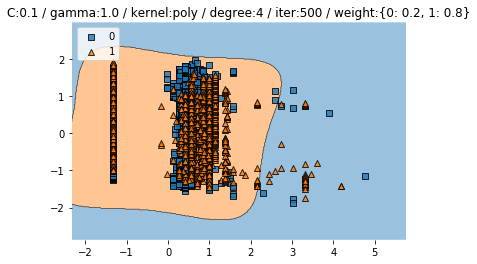

Test CV accuracy scores: [0.41614907 0.5610766  0.40725389 0.4253112  0.60165975]
Test CV accuracy: 0.482 +/- 0.082
Test CV f1 scores: [0.24883767 0.50349271 0.27554234 0.25622282 0.5754382 ]
Test CV f1: 0.372 +/- 0.139


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4672268907563025
Test f1 :  0.6364678899082569


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


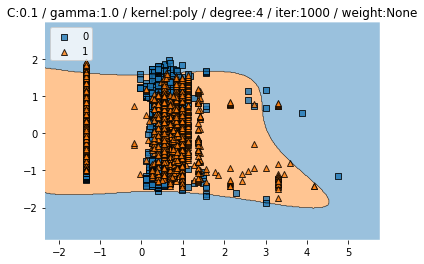

Test CV accuracy scores: [0.42339545 0.49585921 0.40932642 0.41908714 0.62136929]
Test CV accuracy: 0.474 +/- 0.080
Test CV f1 scores: [0.25369495 0.4066124  0.24735307 0.2499818  0.59099099]
Test CV f1: 0.350 +/- 0.135


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6345381526104418


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


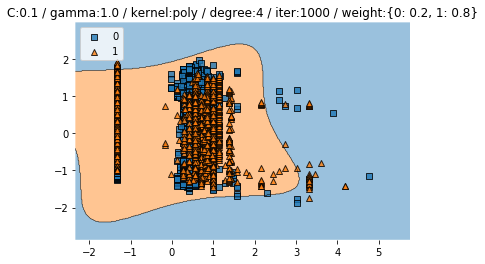

Test CV accuracy scores: [0.58385093 0.50517598 0.43108808 0.42323651 0.41804979]
Test CV accuracy: 0.472 +/- 0.064
Test CV f1 scores: [0.54087109 0.41159737 0.31376351 0.28373242 0.26846907]
Test CV f1: 0.364 +/- 0.102


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4647058823529412
Test f1 :  0.6277030976037405


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


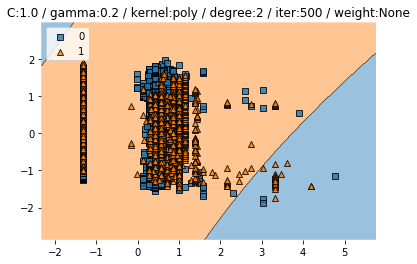

Test CV accuracy scores: [0.42236025 0.42443064 0.4134715  0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.004
Test CV f1 scores: [0.25144882 0.25593397 0.24913016 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6340057636887608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


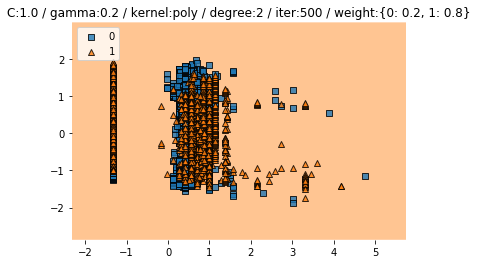

Test CV accuracy scores: [0.41304348 0.42236025 0.3865285  0.42323651 0.42323651]
Test CV accuracy: 0.414 +/- 0.014
Test CV f1 scores: [0.25104586 0.25682876 0.24550506 0.25172084 0.25353771]
Test CV f1: 0.252 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6356855995410212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


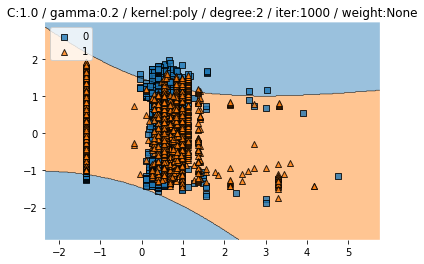

Test CV accuracy scores: [0.4389234  0.6563147  0.41761658 0.45539419 0.4253112 ]
Test CV accuracy: 0.479 +/- 0.090
Test CV f1 scores: [0.28490141 0.65387166 0.25089713 0.33570148 0.25622282]
Test CV f1: 0.356 +/- 0.152


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5134453781512605
Test f1 :  0.6551518761167361


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


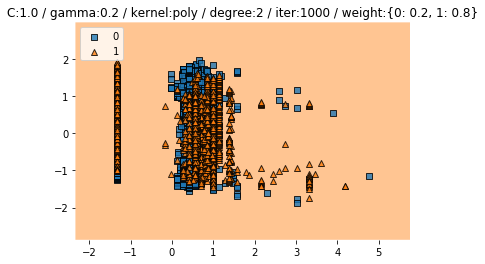

Test CV accuracy scores: [0.42028986 0.46376812 0.39481865 0.39107884 0.42116183]
Test CV accuracy: 0.418 +/- 0.026
Test CV f1 scores: [0.25238067 0.34034504 0.26487226 0.24132129 0.25266044]
Test CV f1: 0.270 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


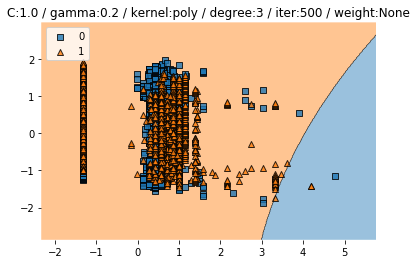

Test CV accuracy scores: [0.42236025 0.42443064 0.4134715  0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.004
Test CV f1 scores: [0.25144882 0.25593397 0.24913016 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6340057636887608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


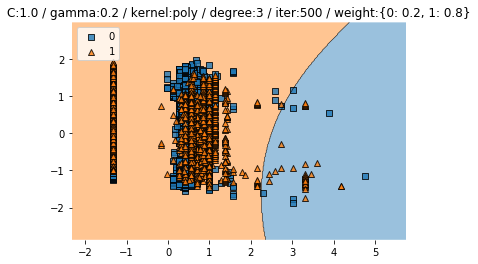

Test CV accuracy scores: [0.41304348 0.42236025 0.3865285  0.42323651 0.42323651]
Test CV accuracy: 0.414 +/- 0.014
Test CV f1 scores: [0.25104586 0.25682876 0.24550506 0.25172084 0.25353771]
Test CV f1: 0.252 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6356855995410212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


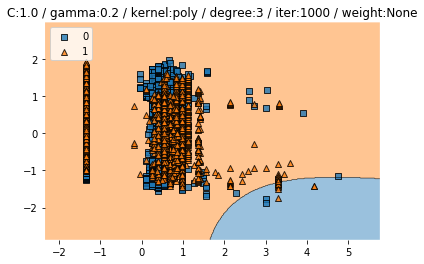

Test CV accuracy scores: [0.4389234  0.6563147  0.41761658 0.45539419 0.4253112 ]
Test CV accuracy: 0.479 +/- 0.090
Test CV f1 scores: [0.28490141 0.65387166 0.25089713 0.33570148 0.25622282]
Test CV f1: 0.356 +/- 0.152


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5134453781512605
Test f1 :  0.6551518761167361


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


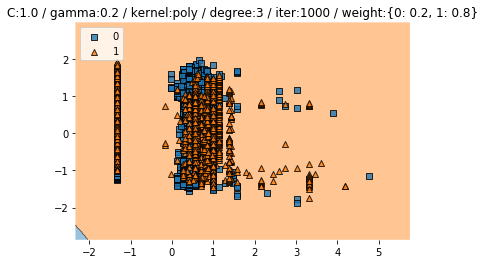

Test CV accuracy scores: [0.42028986 0.46376812 0.39481865 0.39107884 0.42116183]
Test CV accuracy: 0.418 +/- 0.026
Test CV f1 scores: [0.25238067 0.34034504 0.26487226 0.24132129 0.25266044]
Test CV f1: 0.270 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


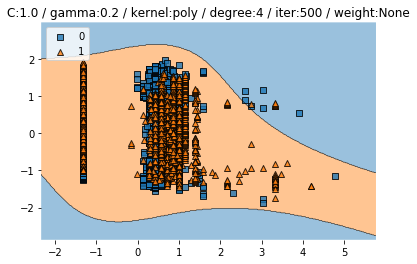

Test CV accuracy scores: [0.42236025 0.42443064 0.4134715  0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.004
Test CV f1 scores: [0.25144882 0.25593397 0.24913016 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.002


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6340057636887608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


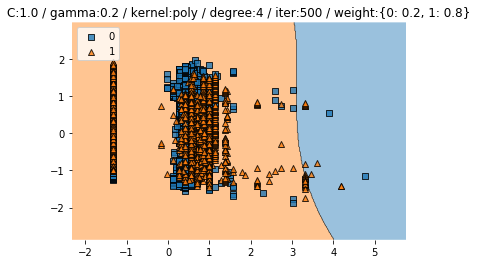

Test CV accuracy scores: [0.41304348 0.42236025 0.3865285  0.42323651 0.42323651]
Test CV accuracy: 0.414 +/- 0.014
Test CV f1 scores: [0.25104586 0.25682876 0.24550506 0.25172084 0.25353771]
Test CV f1: 0.252 +/- 0.004


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6356855995410212


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


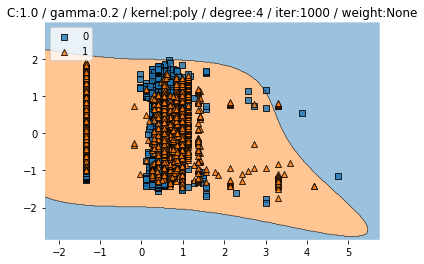

Test CV accuracy scores: [0.4389234  0.6563147  0.41761658 0.45539419 0.4253112 ]
Test CV accuracy: 0.479 +/- 0.090
Test CV f1 scores: [0.28490141 0.65387166 0.25089713 0.33570148 0.25622282]
Test CV f1: 0.356 +/- 0.152


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.5134453781512605
Test f1 :  0.6551518761167361


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


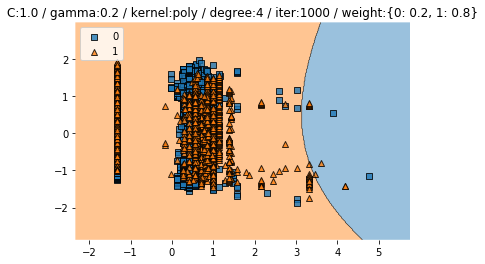

Test CV accuracy scores: [0.42028986 0.46376812 0.39481865 0.39107884 0.42116183]
Test CV accuracy: 0.418 +/- 0.026
Test CV f1 scores: [0.25238067 0.34034504 0.26487226 0.24132129 0.25266044]
Test CV f1: 0.270 +/- 0.036


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


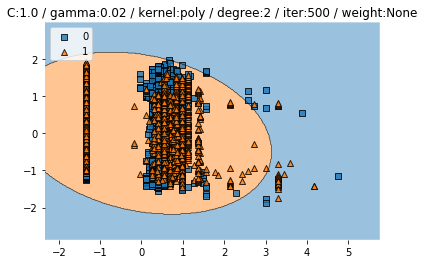

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


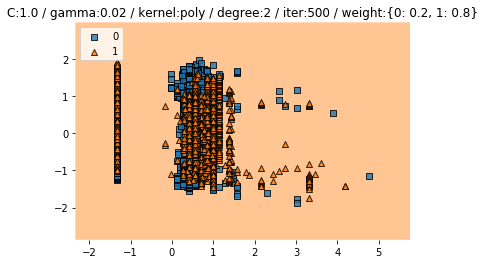

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


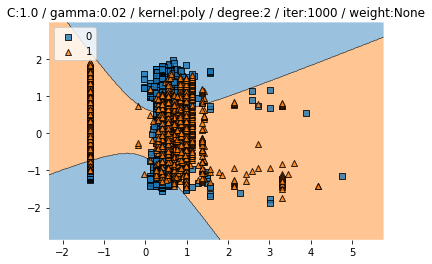

Test CV accuracy scores: [0.42339545 0.42443064 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.2541318  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


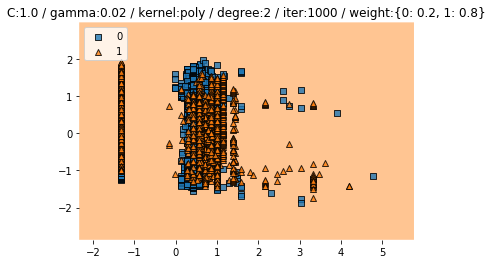

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


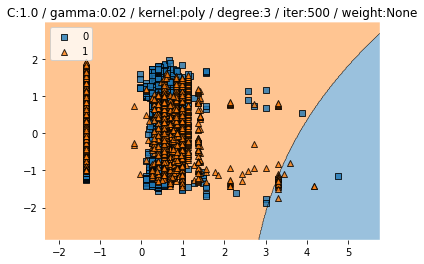

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


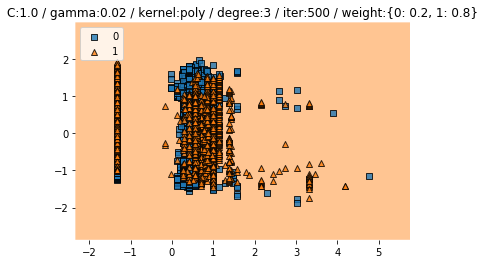

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


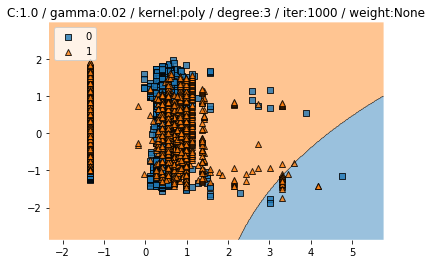

Test CV accuracy scores: [0.42339545 0.42443064 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.2541318  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


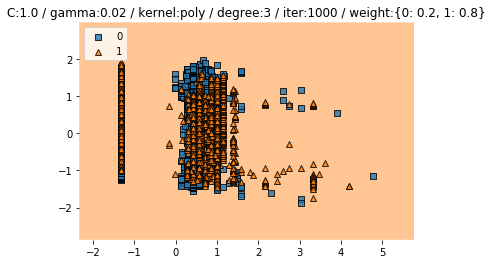

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


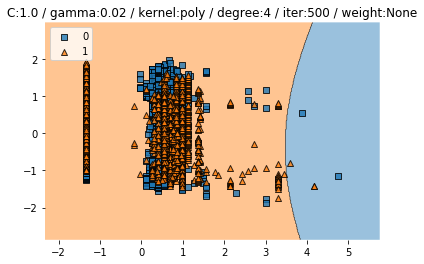

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


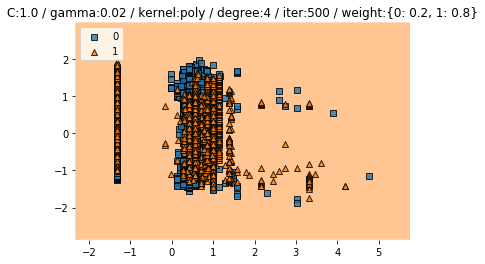

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


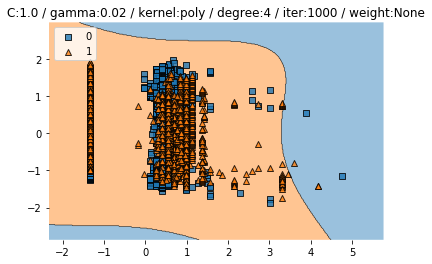

Test CV accuracy scores: [0.42339545 0.42443064 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.2541318  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


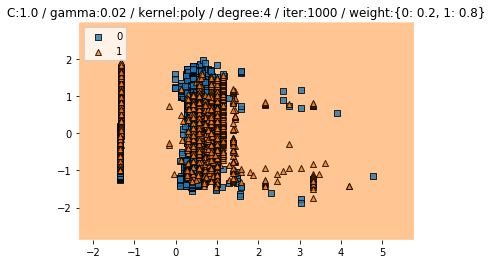

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.2518818  0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.000


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


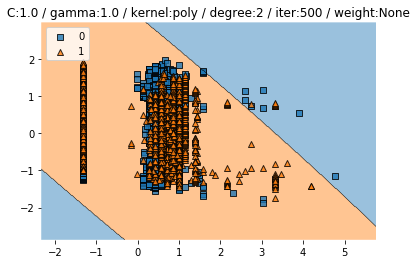

Test CV accuracy scores: [0.46273292 0.45859213 0.54818653 0.39004149 0.42738589]
Test CV accuracy: 0.457 +/- 0.052
Test CV f1 scores: [0.35048922 0.36619352 0.54904449 0.23751781 0.26941287]
Test CV f1: 0.355 +/- 0.109


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47394957983193275
Test f1 :  0.6317647058823529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


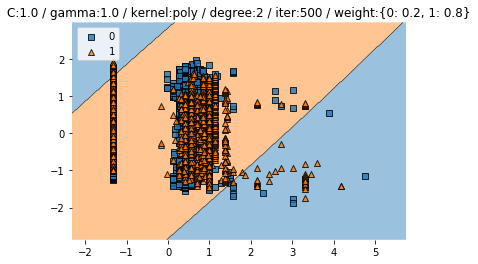

Test CV accuracy scores: [0.41614907 0.44616977 0.4238342  0.4159751  0.39419087]
Test CV accuracy: 0.419 +/- 0.017
Test CV f1 scores: [0.24883767 0.36490039 0.33556941 0.25572245 0.32063698]
Test CV f1: 0.305 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47983193277310926
Test f1 :  0.639067055393586


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


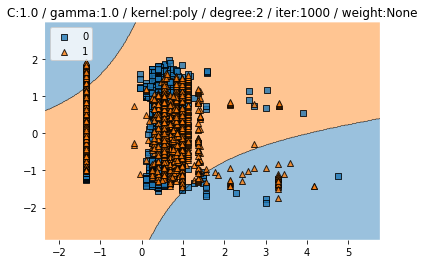

Test CV accuracy scores: [0.41097308 0.58902692 0.3761658  0.44190871 0.37655602]
Test CV accuracy: 0.439 +/- 0.079
Test CV f1 scores: [0.25014908 0.55171182 0.23596423 0.31855081 0.24109358]
Test CV f1: 0.319 +/- 0.120


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4512605042016807
Test f1 :  0.5996321275291232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


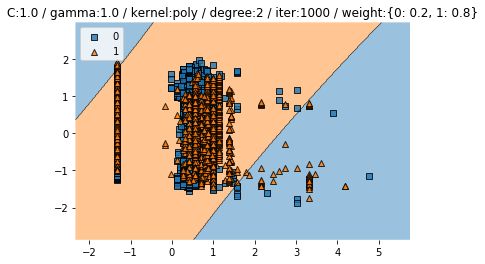

Test CV accuracy scores: [0.41614907 0.45031056 0.43419689 0.40871369 0.43360996]
Test CV accuracy: 0.429 +/- 0.015
Test CV f1 scores: [0.24883767 0.35061932 0.31130643 0.24908383 0.29813387]
Test CV f1: 0.292 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6206088992974239


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


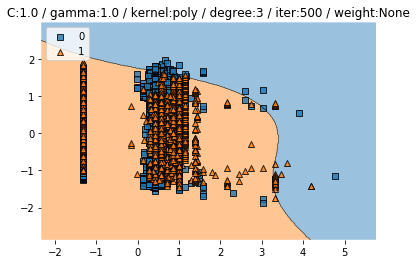

Test CV accuracy scores: [0.46273292 0.45859213 0.54818653 0.39004149 0.42738589]
Test CV accuracy: 0.457 +/- 0.052
Test CV f1 scores: [0.35048922 0.36619352 0.54904449 0.23751781 0.26941287]
Test CV f1: 0.355 +/- 0.109


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47394957983193275
Test f1 :  0.6317647058823529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


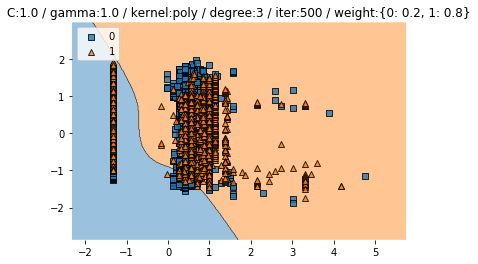

Test CV accuracy scores: [0.41614907 0.44616977 0.4238342  0.4159751  0.39419087]
Test CV accuracy: 0.419 +/- 0.017
Test CV f1 scores: [0.24883767 0.36490039 0.33556941 0.25572245 0.32063698]
Test CV f1: 0.305 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47983193277310926
Test f1 :  0.639067055393586


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


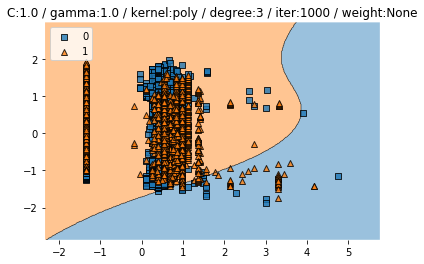

Test CV accuracy scores: [0.41097308 0.58902692 0.3761658  0.44190871 0.37655602]
Test CV accuracy: 0.439 +/- 0.079
Test CV f1 scores: [0.25014908 0.55171182 0.23596423 0.31855081 0.24109358]
Test CV f1: 0.319 +/- 0.120


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4512605042016807
Test f1 :  0.5996321275291232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


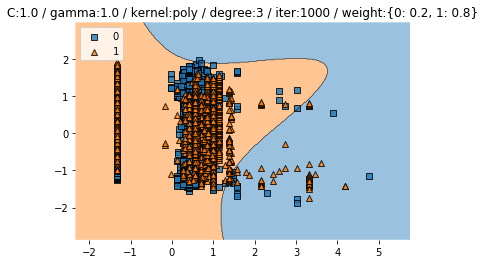

Test CV accuracy scores: [0.41614907 0.45031056 0.43419689 0.40871369 0.43360996]
Test CV accuracy: 0.429 +/- 0.015
Test CV f1 scores: [0.24883767 0.35061932 0.31130643 0.24908383 0.29813387]
Test CV f1: 0.292 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6206088992974239


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


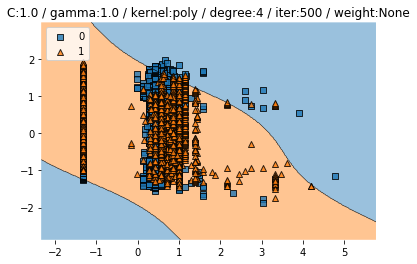

Test CV accuracy scores: [0.46273292 0.45859213 0.54818653 0.39004149 0.42738589]
Test CV accuracy: 0.457 +/- 0.052
Test CV f1 scores: [0.35048922 0.36619352 0.54904449 0.23751781 0.26941287]
Test CV f1: 0.355 +/- 0.109


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47394957983193275
Test f1 :  0.6317647058823529


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


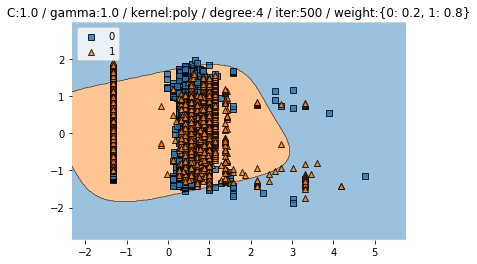

Test CV accuracy scores: [0.41614907 0.44616977 0.4238342  0.4159751  0.39419087]
Test CV accuracy: 0.419 +/- 0.017
Test CV f1 scores: [0.24883767 0.36490039 0.33556941 0.25572245 0.32063698]
Test CV f1: 0.305 +/- 0.045


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47983193277310926
Test f1 :  0.639067055393586


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


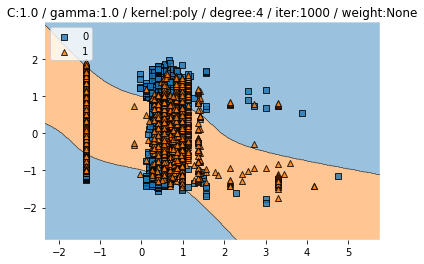

Test CV accuracy scores: [0.41097308 0.58902692 0.3761658  0.44190871 0.37655602]
Test CV accuracy: 0.439 +/- 0.079
Test CV f1 scores: [0.25014908 0.55171182 0.23596423 0.31855081 0.24109358]
Test CV f1: 0.319 +/- 0.120


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4512605042016807
Test f1 :  0.5996321275291232


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


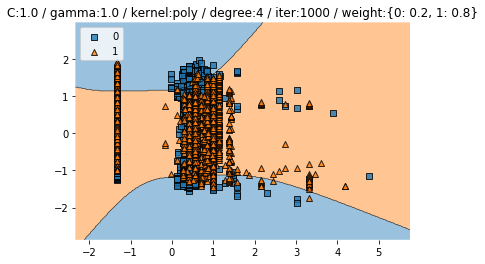

Test CV accuracy scores: [0.41614907 0.45031056 0.43419689 0.40871369 0.43360996]
Test CV accuracy: 0.429 +/- 0.015
Test CV f1 scores: [0.24883767 0.35061932 0.31130643 0.24908383 0.29813387]
Test CV f1: 0.292 +/- 0.039


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6206088992974239


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


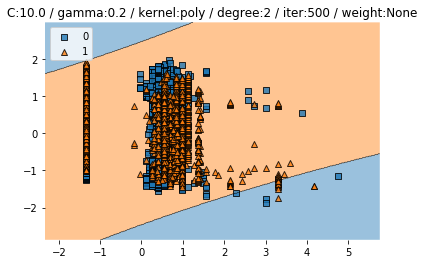

Test CV accuracy scores: [0.61801242 0.46583851 0.40414508 0.41286307 0.42323651]
Test CV accuracy: 0.465 +/- 0.079
Test CV f1 scores: [0.51388479 0.34010203 0.24511732 0.24912629 0.25172084]
Test CV f1: 0.320 +/- 0.103


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


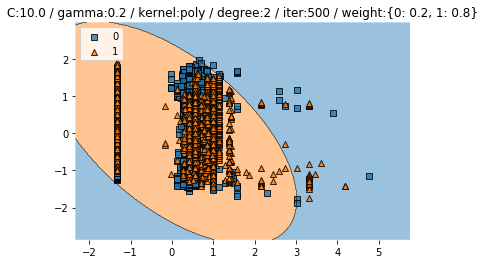

Test CV accuracy scores: [0.41925466 0.45341615 0.41036269 0.42323651 0.56639004]
Test CV accuracy: 0.455 +/- 0.058
Test CV f1 scores: [0.25014611 0.32185261 0.26299984 0.25172084 0.54717136]
Test CV f1: 0.327 +/- 0.113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


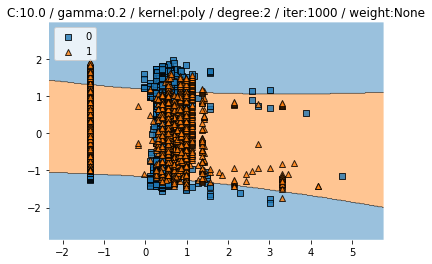

Test CV accuracy scores: [0.42132505 0.46066253 0.4642487  0.41286307 0.52385892]
Test CV accuracy: 0.457 +/- 0.039
Test CV f1 scores: [0.25101522 0.34134262 0.3684022  0.25262581 0.46236897]
Test CV f1: 0.335 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4823529411764706
Test f1 :  0.6376470588235293


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


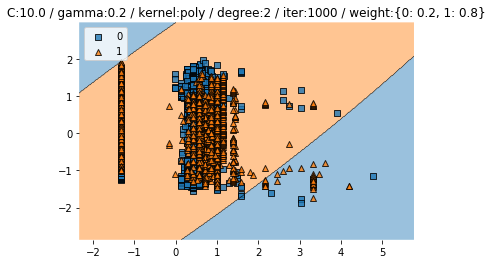

Test CV accuracy scores: [0.41718427 0.52795031 0.40621762 0.40975104 0.41493776]
Test CV accuracy: 0.435 +/- 0.047
Test CV f1 scores: [0.25106078 0.45364578 0.32900251 0.26618869 0.24823256]
Test CV f1: 0.310 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4613445378151261
Test f1 :  0.630972941853771


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


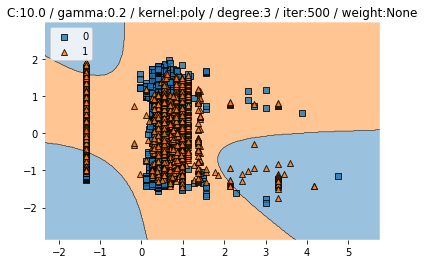

Test CV accuracy scores: [0.61801242 0.46583851 0.40414508 0.41286307 0.42323651]
Test CV accuracy: 0.465 +/- 0.079
Test CV f1 scores: [0.51388479 0.34010203 0.24511732 0.24912629 0.25172084]
Test CV f1: 0.320 +/- 0.103


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


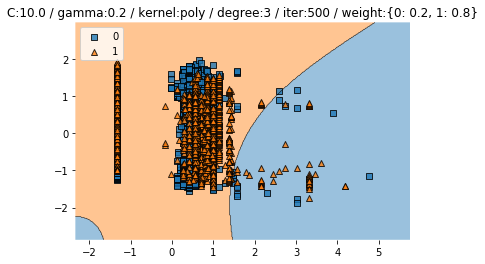

Test CV accuracy scores: [0.41925466 0.45341615 0.41036269 0.42323651 0.56639004]
Test CV accuracy: 0.455 +/- 0.058
Test CV f1 scores: [0.25014611 0.32185261 0.26299984 0.25172084 0.54717136]
Test CV f1: 0.327 +/- 0.113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


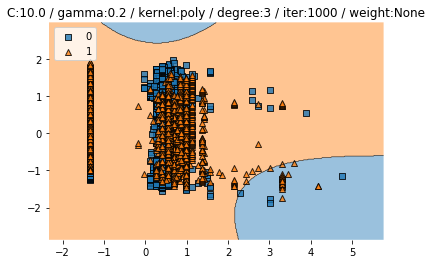

Test CV accuracy scores: [0.42132505 0.46066253 0.4642487  0.41286307 0.52385892]
Test CV accuracy: 0.457 +/- 0.039
Test CV f1 scores: [0.25101522 0.34134262 0.3684022  0.25262581 0.46236897]
Test CV f1: 0.335 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4823529411764706
Test f1 :  0.6376470588235293


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


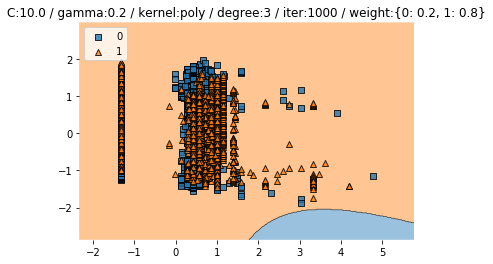

Test CV accuracy scores: [0.41718427 0.52795031 0.40621762 0.40975104 0.41493776]
Test CV accuracy: 0.435 +/- 0.047
Test CV f1 scores: [0.25106078 0.45364578 0.32900251 0.26618869 0.24823256]
Test CV f1: 0.310 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4613445378151261
Test f1 :  0.630972941853771


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


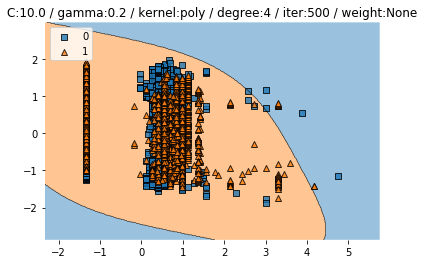

Test CV accuracy scores: [0.61801242 0.46583851 0.40414508 0.41286307 0.42323651]
Test CV accuracy: 0.465 +/- 0.079
Test CV f1 scores: [0.51388479 0.34010203 0.24511732 0.24912629 0.25172084]
Test CV f1: 0.320 +/- 0.103


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


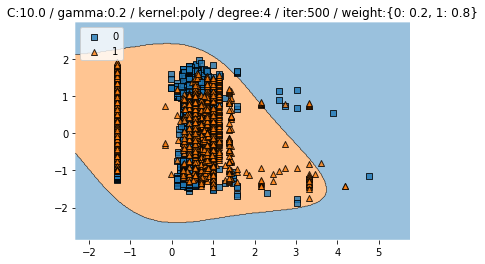

Test CV accuracy scores: [0.41925466 0.45341615 0.41036269 0.42323651 0.56639004]
Test CV accuracy: 0.455 +/- 0.058
Test CV f1 scores: [0.25014611 0.32185261 0.26299984 0.25172084 0.54717136]
Test CV f1: 0.327 +/- 0.113


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


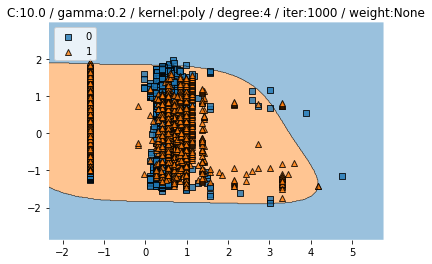

Test CV accuracy scores: [0.42132505 0.46066253 0.4642487  0.41286307 0.52385892]
Test CV accuracy: 0.457 +/- 0.039
Test CV f1 scores: [0.25101522 0.34134262 0.3684022  0.25262581 0.46236897]
Test CV f1: 0.335 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4823529411764706
Test f1 :  0.6376470588235293


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


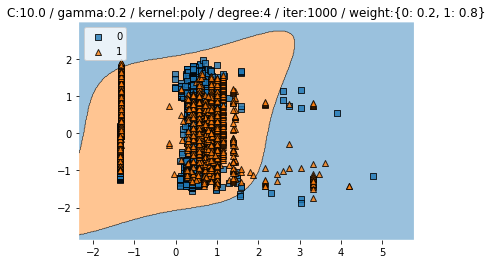

Test CV accuracy scores: [0.41718427 0.52795031 0.40621762 0.40975104 0.41493776]
Test CV accuracy: 0.435 +/- 0.047
Test CV f1 scores: [0.25106078 0.45364578 0.32900251 0.26618869 0.24823256]
Test CV f1: 0.310 +/- 0.078


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4613445378151261
Test f1 :  0.630972941853771


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


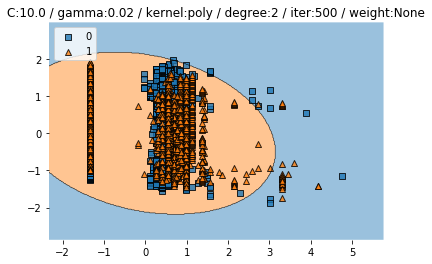

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


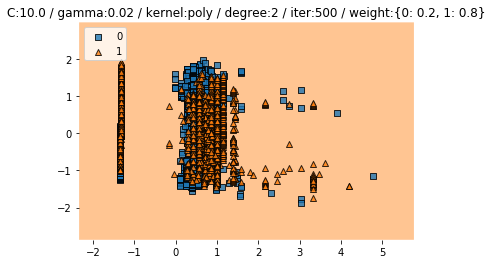

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


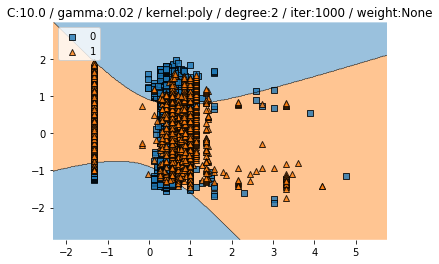

Test CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Test CV accuracy: 0.469 +/- 0.095
Test CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Test CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


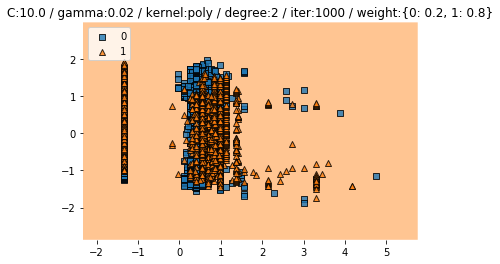

Test CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


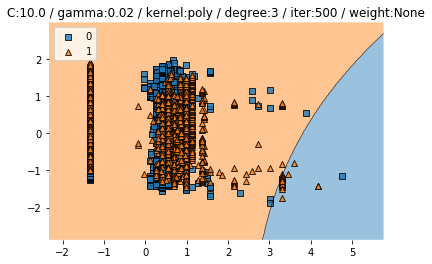

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


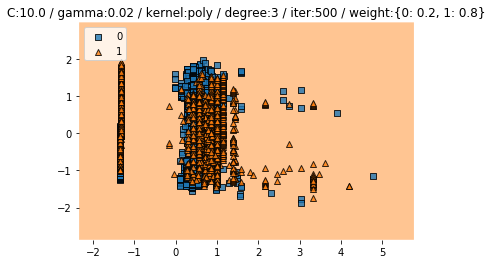

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


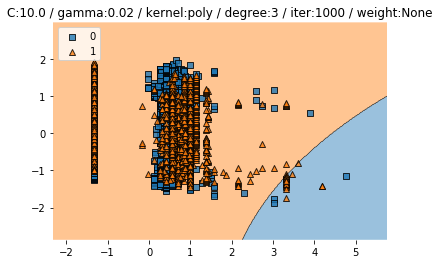

Test CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Test CV accuracy: 0.469 +/- 0.095
Test CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Test CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


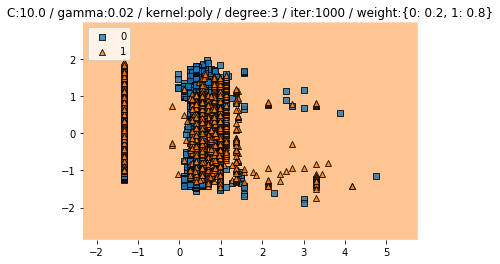

Test CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


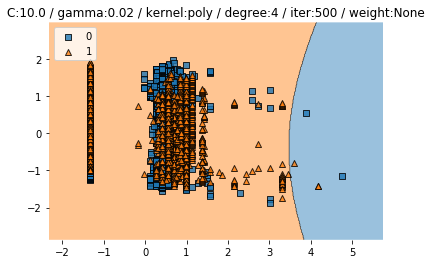

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25127685 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


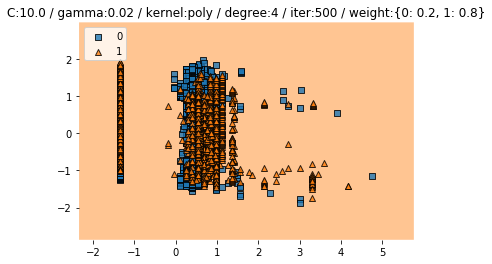

Test CV accuracy scores: [0.42339545 0.42339545 0.42279793 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.000
Test CV f1 scores: [0.2518818  0.25369495 0.25309176 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


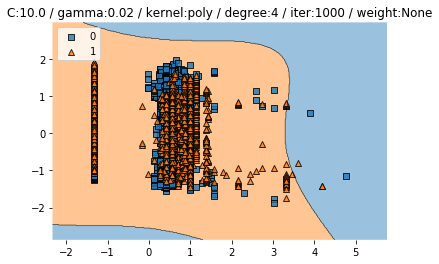

Test CV accuracy scores: [0.42339545 0.65838509 0.41761658 0.42323651 0.42323651]
Test CV accuracy: 0.469 +/- 0.095
Test CV f1 scores: [0.2518818  0.61451211 0.25089713 0.25172084 0.25172084]
Test CV f1: 0.324 +/- 0.145


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


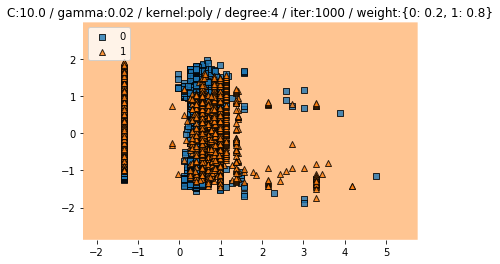

Test CV accuracy scores: [0.42339545 0.42339545 0.42072539 0.42323651 0.42323651]
Test CV accuracy: 0.423 +/- 0.001
Test CV f1 scores: [0.2518818  0.25369495 0.25221578 0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.001


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


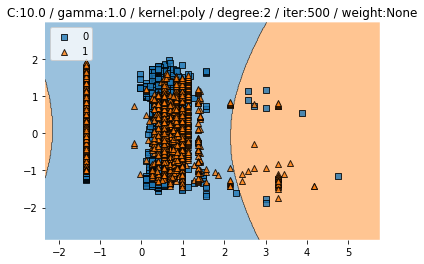

Test CV accuracy scores: [0.42132505 0.53623188 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.445 +/- 0.053
Test CV f1 scores: [0.25460821 0.4770111  0.28538097 0.2738725  0.37280571]
Test CV f1: 0.333 +/- 0.083


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


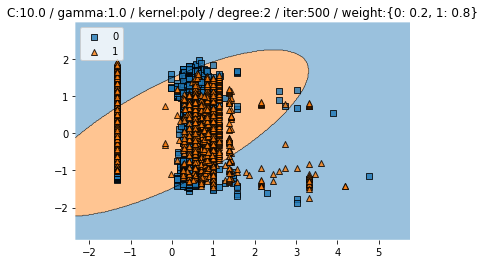

Test CV accuracy scores: [0.38509317 0.41718427 0.49740933 0.40871369 0.42323651]
Test CV accuracy: 0.426 +/- 0.038
Test CV f1 scores: [0.27820654 0.26811488 0.48099874 0.25080895 0.34200528]
Test CV f1: 0.324 +/- 0.084


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3420168067226891
Test f1 :  0.49775497113534317


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


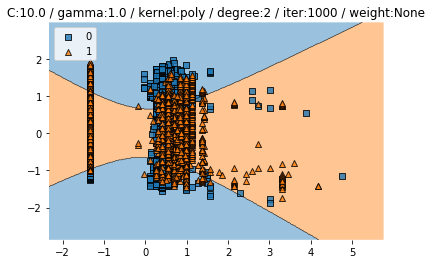

Test CV accuracy scores: [0.41097308 0.51345756 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.431 +/- 0.044
Test CV f1 scores: [0.28359876 0.46018862 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.325 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


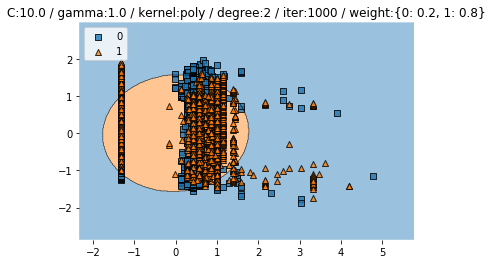

Test CV accuracy scores: [0.39544513 0.47308489 0.39067358 0.43360996 0.49377593]
Test CV accuracy: 0.437 +/- 0.041
Test CV f1 scores: [0.24334252 0.38856571 0.30541197 0.29813387 0.44505456]
Test CV f1: 0.336 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3521008403361345
Test f1 :  0.4433212996389892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


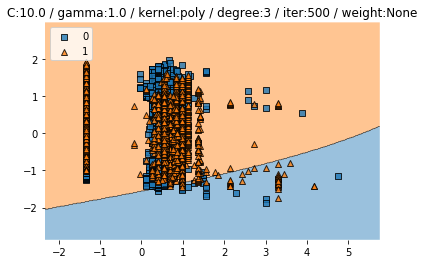

Test CV accuracy scores: [0.42132505 0.53623188 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.445 +/- 0.053
Test CV f1 scores: [0.25460821 0.4770111  0.28538097 0.2738725  0.37280571]
Test CV f1: 0.333 +/- 0.083


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


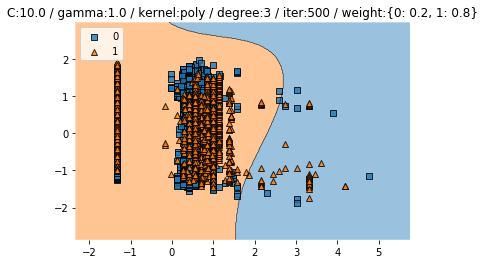

Test CV accuracy scores: [0.38509317 0.41718427 0.49740933 0.40871369 0.42323651]
Test CV accuracy: 0.426 +/- 0.038
Test CV f1 scores: [0.27820654 0.26811488 0.48099874 0.25080895 0.34200528]
Test CV f1: 0.324 +/- 0.084


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3420168067226891
Test f1 :  0.49775497113534317


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


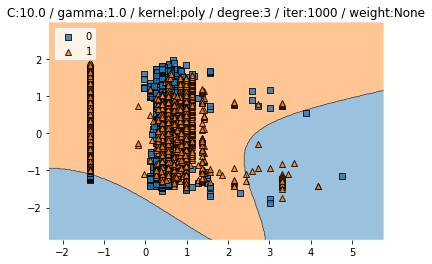

Test CV accuracy scores: [0.41097308 0.51345756 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.431 +/- 0.044
Test CV f1 scores: [0.28359876 0.46018862 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.325 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


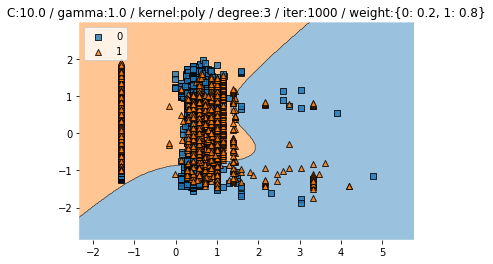

Test CV accuracy scores: [0.39544513 0.47308489 0.39067358 0.43360996 0.49377593]
Test CV accuracy: 0.437 +/- 0.041
Test CV f1 scores: [0.24334252 0.38856571 0.30541197 0.29813387 0.44505456]
Test CV f1: 0.336 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3521008403361345
Test f1 :  0.4433212996389892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


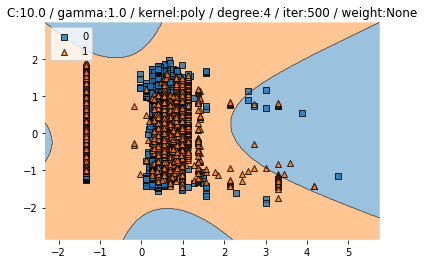

Test CV accuracy scores: [0.42132505 0.53623188 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.445 +/- 0.053
Test CV f1 scores: [0.25460821 0.4770111  0.28538097 0.2738725  0.37280571]
Test CV f1: 0.333 +/- 0.083


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


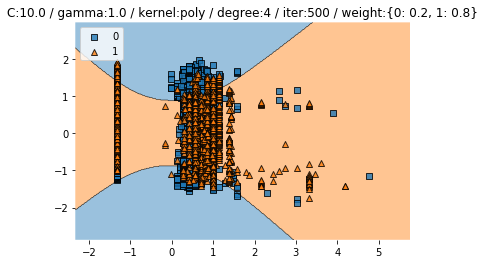

Test CV accuracy scores: [0.38509317 0.41718427 0.49740933 0.40871369 0.42323651]
Test CV accuracy: 0.426 +/- 0.038
Test CV f1 scores: [0.27820654 0.26811488 0.48099874 0.25080895 0.34200528]
Test CV f1: 0.324 +/- 0.084


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3420168067226891
Test f1 :  0.49775497113534317


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


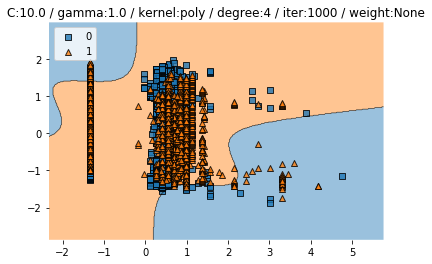

Test CV accuracy scores: [0.41097308 0.51345756 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.431 +/- 0.044
Test CV f1 scores: [0.28359876 0.46018862 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.325 +/- 0.070


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


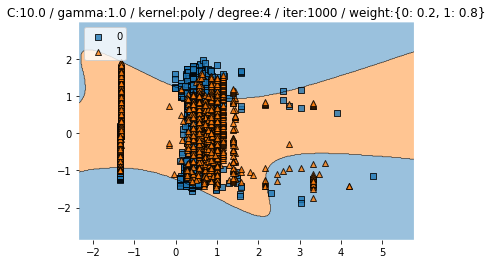

Test CV accuracy scores: [0.39544513 0.47308489 0.39067358 0.43360996 0.49377593]
Test CV accuracy: 0.437 +/- 0.041
Test CV f1 scores: [0.24334252 0.38856571 0.30541197 0.29813387 0.44505456]
Test CV f1: 0.336 +/- 0.072


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.3521008403361345
Test f1 :  0.4433212996389892


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


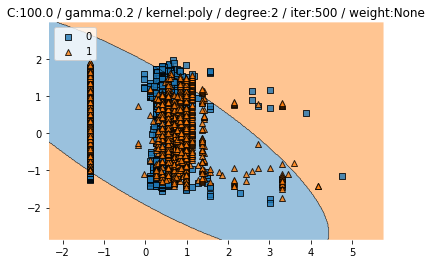

Test CV accuracy scores: [0.54037267 0.48240166 0.38341969 0.41908714 0.42012448]
Test CV accuracy: 0.449 +/- 0.056
Test CV f1 scores: [0.53688592 0.40195029 0.25919058 0.30606377 0.25400887]
Test CV f1: 0.352 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.49831932773109244
Test f1 :  0.6335174953959484


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


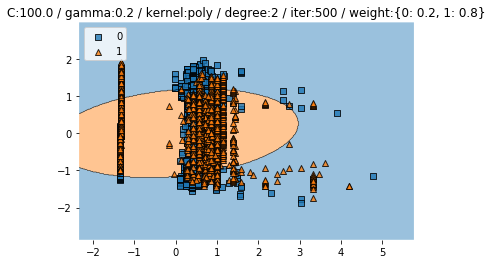

Test CV accuracy scores: [0.40890269 0.51035197 0.46735751 0.44502075 0.42427386]
Test CV accuracy: 0.451 +/- 0.036
Test CV f1 scores: [0.2475134  0.45712859 0.37264269 0.31003682 0.25397541]
Test CV f1: 0.328 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4857142857142857
Test f1 :  0.6101910828025477


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


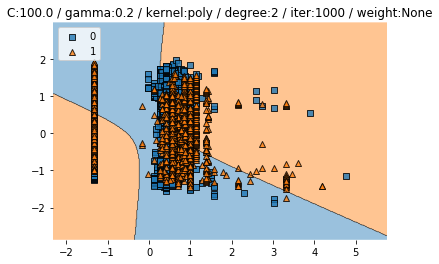

Test CV accuracy scores: [0.48136646 0.44306418 0.40518135 0.42219917 0.38381743]
Test CV accuracy: 0.427 +/- 0.033
Test CV f1 scores: [0.3754976  0.3090089  0.27450525 0.25309938 0.25221746]
Test CV f1: 0.293 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6907563025210084
Test f1 :  0.7363896848137537


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


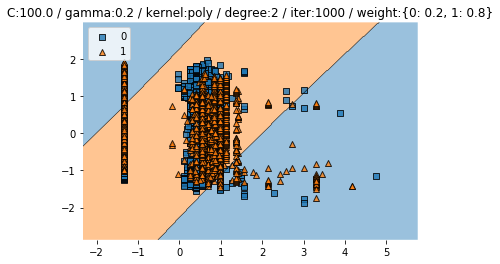

Test CV accuracy scores: [0.45755694 0.55486542 0.4        0.44190871 0.42634855]
Test CV accuracy: 0.456 +/- 0.053
Test CV f1 scores: [0.34357614 0.49802405 0.28737486 0.3569551  0.27890088]
Test CV f1: 0.353 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6254335260115608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


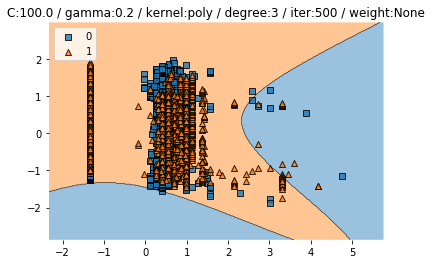

Test CV accuracy scores: [0.54037267 0.48240166 0.38341969 0.41908714 0.42012448]
Test CV accuracy: 0.449 +/- 0.056
Test CV f1 scores: [0.53688592 0.40195029 0.25919058 0.30606377 0.25400887]
Test CV f1: 0.352 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.49831932773109244
Test f1 :  0.6335174953959484


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


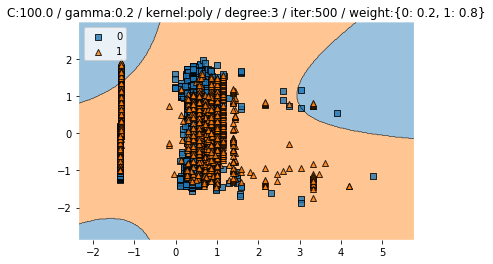

Test CV accuracy scores: [0.40890269 0.51035197 0.46735751 0.44502075 0.42427386]
Test CV accuracy: 0.451 +/- 0.036
Test CV f1 scores: [0.2475134  0.45712859 0.37264269 0.31003682 0.25397541]
Test CV f1: 0.328 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4857142857142857
Test f1 :  0.6101910828025477


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


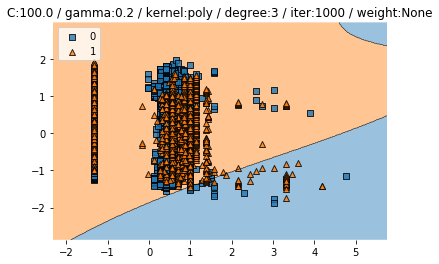

Test CV accuracy scores: [0.48136646 0.44306418 0.40518135 0.42219917 0.38381743]
Test CV accuracy: 0.427 +/- 0.033
Test CV f1 scores: [0.3754976  0.3090089  0.27450525 0.25309938 0.25221746]
Test CV f1: 0.293 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6907563025210084
Test f1 :  0.7363896848137537


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


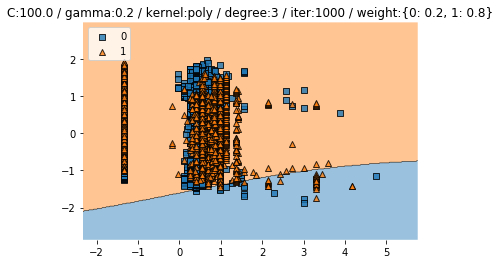

Test CV accuracy scores: [0.45755694 0.55486542 0.4        0.44190871 0.42634855]
Test CV accuracy: 0.456 +/- 0.053
Test CV f1 scores: [0.34357614 0.49802405 0.28737486 0.3569551  0.27890088]
Test CV f1: 0.353 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6254335260115608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


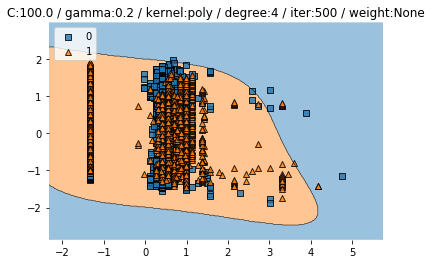

Test CV accuracy scores: [0.54037267 0.48240166 0.38341969 0.41908714 0.42012448]
Test CV accuracy: 0.449 +/- 0.056
Test CV f1 scores: [0.53688592 0.40195029 0.25919058 0.30606377 0.25400887]
Test CV f1: 0.352 +/- 0.107


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.49831932773109244
Test f1 :  0.6335174953959484


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


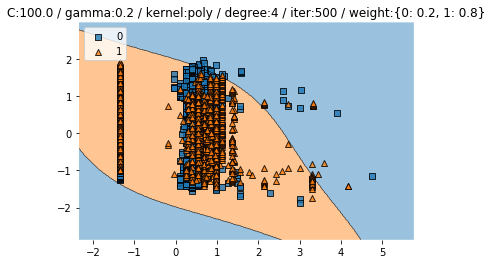

Test CV accuracy scores: [0.40890269 0.51035197 0.46735751 0.44502075 0.42427386]
Test CV accuracy: 0.451 +/- 0.036
Test CV f1 scores: [0.2475134  0.45712859 0.37264269 0.31003682 0.25397541]
Test CV f1: 0.328 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4857142857142857
Test f1 :  0.6101910828025477


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


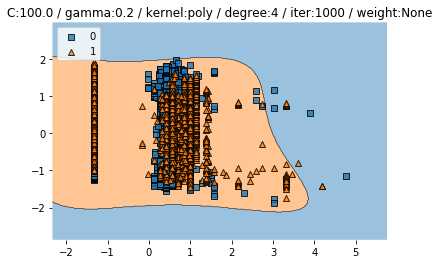

Test CV accuracy scores: [0.48136646 0.44306418 0.40518135 0.42219917 0.38381743]
Test CV accuracy: 0.427 +/- 0.033
Test CV f1 scores: [0.3754976  0.3090089  0.27450525 0.25309938 0.25221746]
Test CV f1: 0.293 +/- 0.046


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.6907563025210084
Test f1 :  0.7363896848137537


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


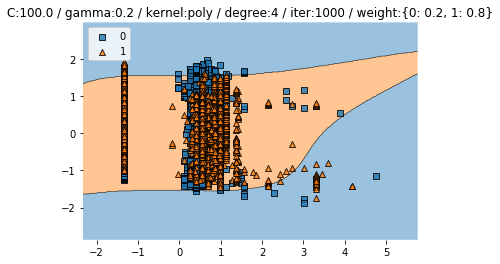

Test CV accuracy scores: [0.45755694 0.55486542 0.4        0.44190871 0.42634855]
Test CV accuracy: 0.456 +/- 0.053
Test CV f1 scores: [0.34357614 0.49802405 0.28737486 0.3569551  0.27890088]
Test CV f1: 0.353 +/- 0.079


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45546218487394957
Test f1 :  0.6254335260115608


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


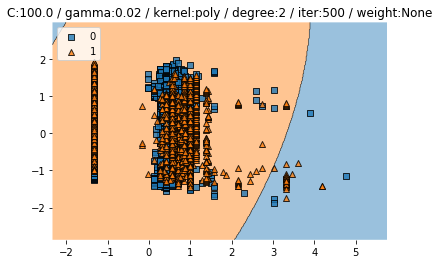

Test CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Test CV accuracy: 0.427 +/- 0.041
Test CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Test CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


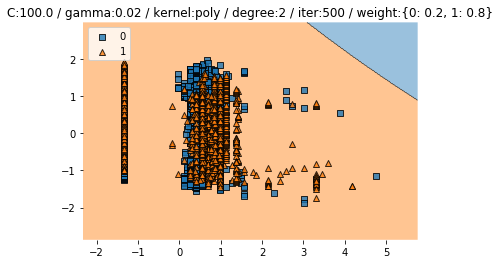

Test CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.005
Test CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


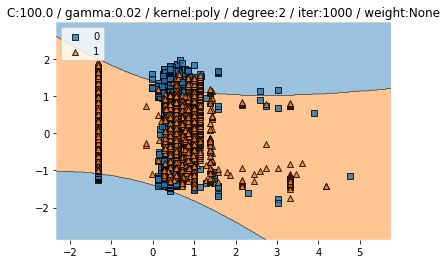

Test CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Test CV accuracy: 0.550 +/- 0.161
Test CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Test CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


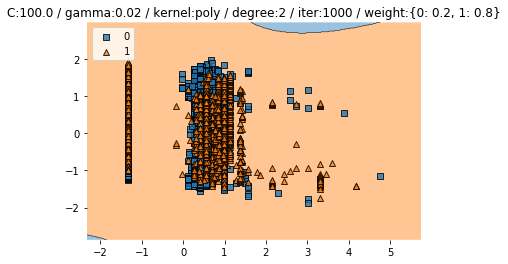

Test CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Test CV accuracy: 0.420 +/- 0.005
Test CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Test CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


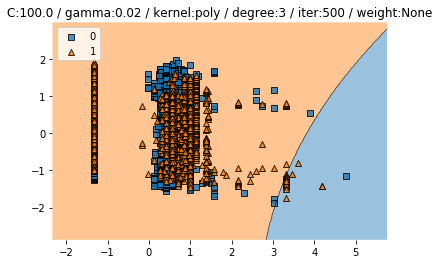

Test CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Test CV accuracy: 0.427 +/- 0.041
Test CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Test CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


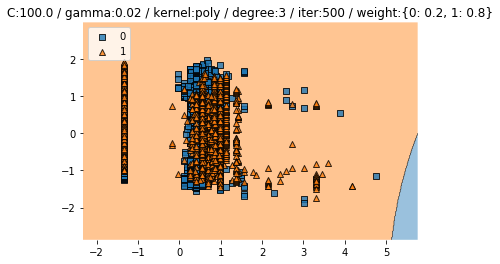

Test CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.005
Test CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


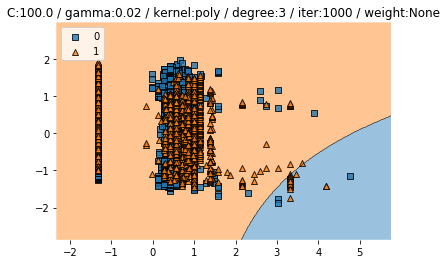

Test CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Test CV accuracy: 0.550 +/- 0.161
Test CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Test CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


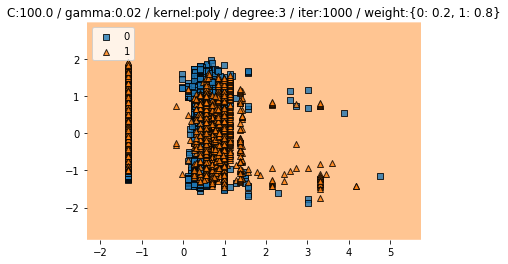

Test CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Test CV accuracy: 0.420 +/- 0.005
Test CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Test CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


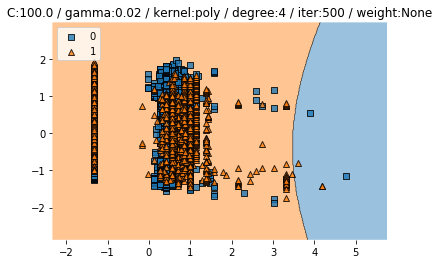

Test CV accuracy scores: [0.42236025 0.49792961 0.36891192 0.42323651 0.42323651]
Test CV accuracy: 0.427 +/- 0.041
Test CV f1 scores: [0.25144882 0.40577349 0.23105641 0.25172084 0.25172084]
Test CV f1: 0.278 +/- 0.064


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46974789915966386
Test f1 :  0.6392224128073184


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


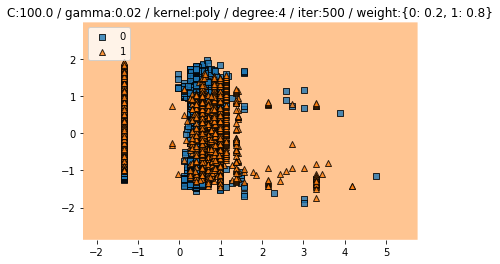

Test CV accuracy scores: [0.42236025 0.42443064 0.41036269 0.42323651 0.42323651]
Test CV accuracy: 0.421 +/- 0.005
Test CV f1 scores: [0.25144882 0.25593397 0.2477983  0.25172084 0.25172084]
Test CV f1: 0.252 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.4680672268907563
Test f1 :  0.6376645678305667


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


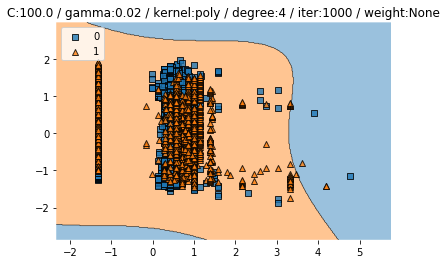

Test CV accuracy scores: [0.81055901 0.66770186 0.4238342  0.42323651 0.42323651]
Test CV accuracy: 0.550 +/- 0.161
Test CV f1 scores: [0.79930822 0.66849515 0.25352882 0.25172084 0.25172084]
Test CV f1: 0.445 +/- 0.240


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.47058823529411764
Test f1 :  0.6399999999999999


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)
C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\matplotlib\contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


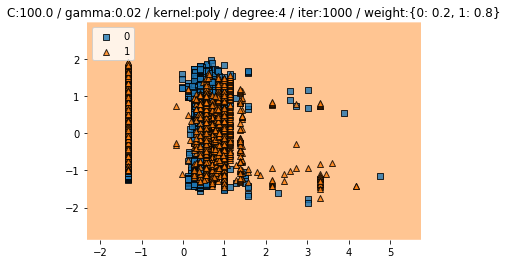

Test CV accuracy scores: [0.42132505 0.42443064 0.41036269 0.42116183 0.42323651]
Test CV accuracy: 0.420 +/- 0.005
Test CV f1 scores: [0.25101522 0.25593397 0.2477983  0.25085259 0.25172084]
Test CV f1: 0.251 +/- 0.003


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46638655462184875
Test f1 :  0.6361031518624641


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


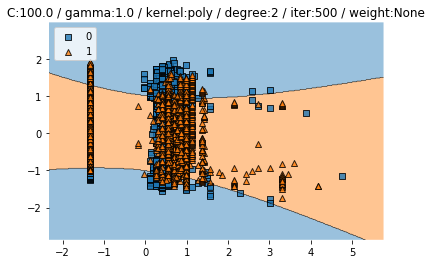

Test CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.422 +/- 0.028
Test CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Test CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


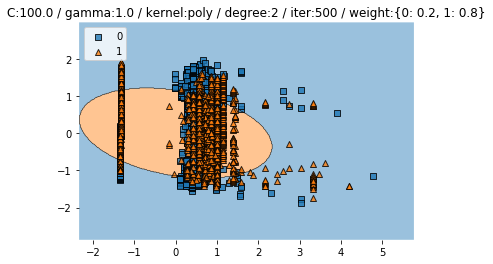

Test CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.422 +/- 0.028
Test CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Test CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


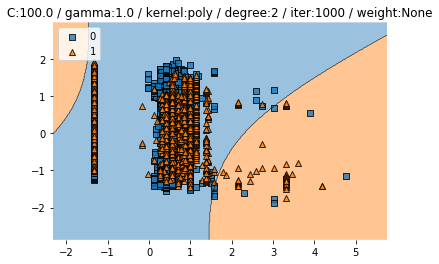

Test CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.414 +/- 0.016
Test CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


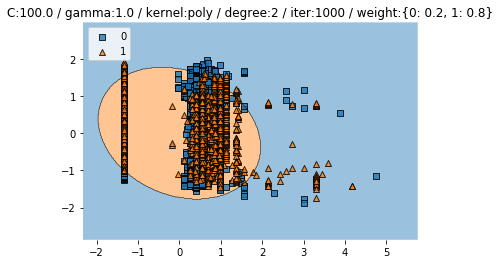

Test CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.414 +/- 0.016
Test CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


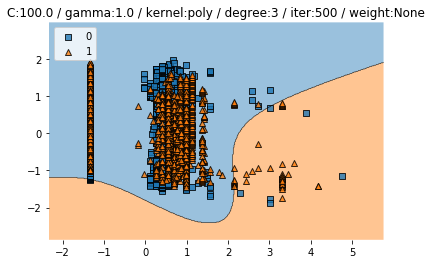

Test CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.422 +/- 0.028
Test CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Test CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


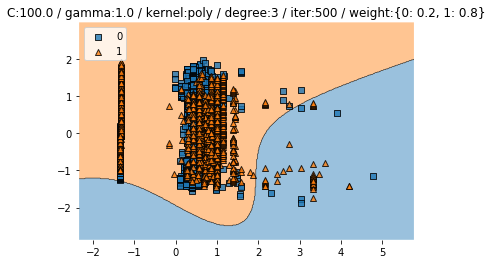

Test CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.422 +/- 0.028
Test CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Test CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


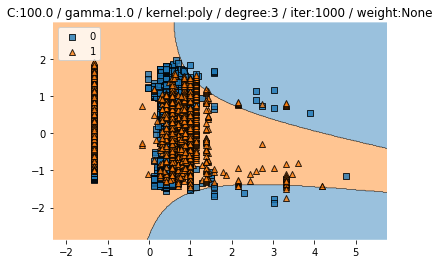

Test CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.414 +/- 0.016
Test CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


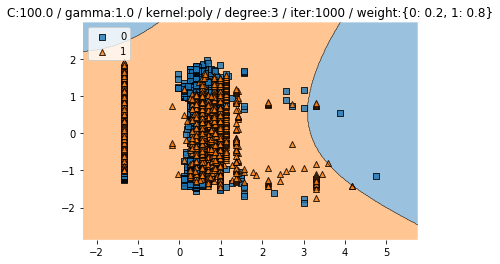

Test CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.414 +/- 0.016
Test CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


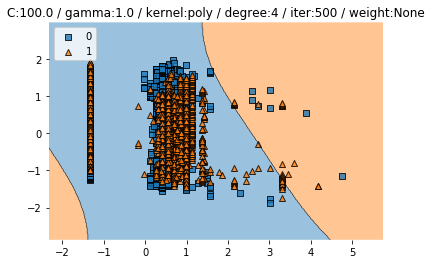

Test CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.422 +/- 0.028
Test CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Test CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


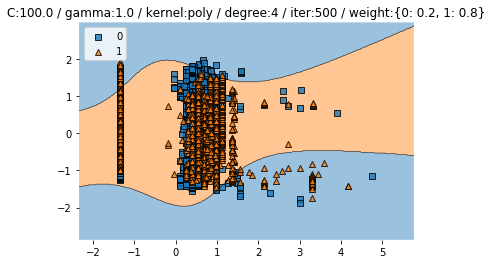

Test CV accuracy scores: [0.42132505 0.42028986 0.40932642 0.38692946 0.47095436]
Test CV accuracy: 0.422 +/- 0.028
Test CV f1 scores: [0.25460821 0.31578578 0.28538097 0.2738725  0.37280571]
Test CV f1: 0.300 +/- 0.041


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=500).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.46554621848739497
Test f1 :  0.634902411021814


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


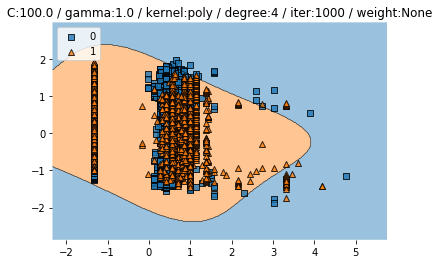

Test CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.414 +/- 0.016
Test CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


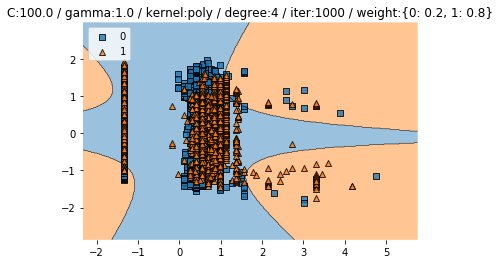

Test CV accuracy scores: [0.41097308 0.42650104 0.43626943 0.406639   0.38900415]
Test CV accuracy: 0.414 +/- 0.016
Test CV f1 scores: [0.28359876 0.29300885 0.32202391 0.28564731 0.27222097]
Test CV f1: 0.291 +/- 0.017


C:\Users\jeon\AppData\Local\Programs\Python\Python36-32\Lib\conda\lib\site-packages\sklearn\svm\base.py:244: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  % self.max_iter, ConvergenceWarning)


Test accuracy :  0.45714285714285713
Test f1 :  0.6270207852193995
1139.781479358673 secs


In [16]:
# blog poly
c_range = [0.01, 0.1, 1.0, 10.0, 100.0]
gamma_range = [0.2, 0.02, 1.0]
iter_range = [500, 1000]
weight_range = [None, {0:0.2, 1:0.8}]
degree_range = [2, 3, 4]
param_list =[{"C": c, "gamma": gamma, "kernel": "poly", "degree":degree, "max_iter": iter, "class_weight":weight} for c in c_range for gamma in gamma_range for degree in degree_range for iter in iter_range for weight in weight_range]

start = time.time()
[tuning(3,params=param) for param in param_list]
end = time.time()
print(end-start,"secs")